<a href="https://colab.research.google.com/github/KKirsche-l/Data-Science/blob/main/Similarity_Measurements_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install pandas numpy scipy fastdtw openpyxl seaborn


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 5.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fastdtw: filename=fastdtw-0.3.4-cp310-cp310-linux_x86_64.whl size=512543 sha256=89946f462850a99d3e17b3796fd615380c42aaa033ac26c18d3bb2f7fdfdb4f5
  Stored in directory: /root/.cache/pip/wheels/73/c8/f7/c25448dab74c3acf4848bc25d513c736bb93910277e1528ef4
Successfully built fastdtw


In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import pearsonr
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean
import seaborn as sns
import matplotlib.pyplot as plt

# 读取Excel文件
#excel_file = '/content/drive/MyDrive/processed_data_15_raw data.xlsx'
#excel_file= '/content/drive/MyDrive/output.xlsx'
excel_file= '/content/drive/MyDrive/normalized_data.xlsx'
sheets = pd.ExcelFile(excel_file).sheet_names

# 存储所有房间的数据
data = {}
for sheet in sheets:
    data[sheet] = pd.read_excel(excel_file, sheet_name=sheet, index_col=0)
rooms = list(data.keys())

In [ ]:
rooms = list(data.keys())

##整体概述分析

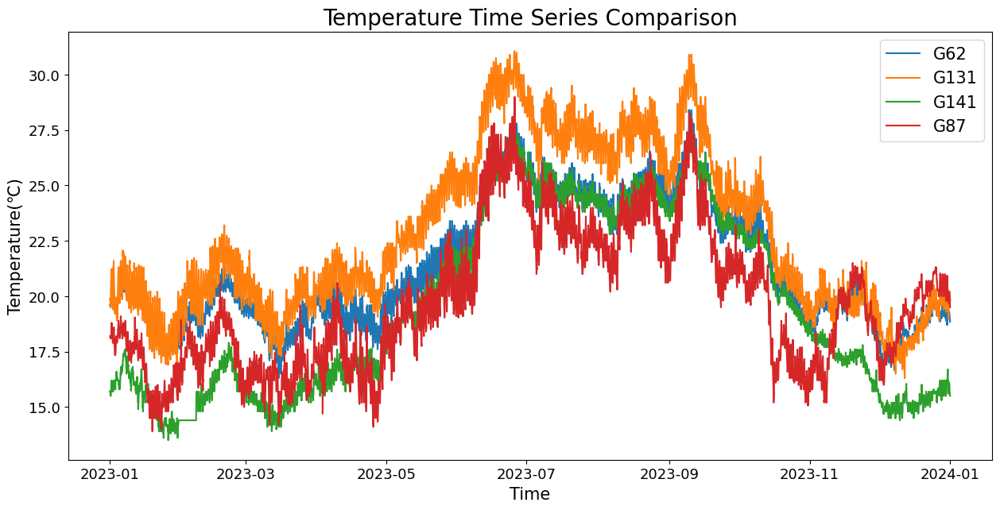

In [ ]:
rooms = list(data.keys())
plt.figure(figsize=(15, 7))
for i in [0,7,13,24]:
  plt.plot(data[rooms[i]].index, data[rooms[i]].iloc[:,0], label=rooms[i])

plt.title('Temperature Time Series Comparison', fontsize=20)

plt.xlabel('Time', fontsize=15)                # x轴标签字体大小
plt.ylabel('Temperature(℃)', fontsize=15)                # y轴标签字体大小

# 添加图例
plt.legend(fontsize=15)                          # 图例字体大小

# 设置刻度标签的字体大小
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)

plt.show()

<ipython-input-37-07a0a6e27745>:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('tab20')  # 使用'tab20' colormap


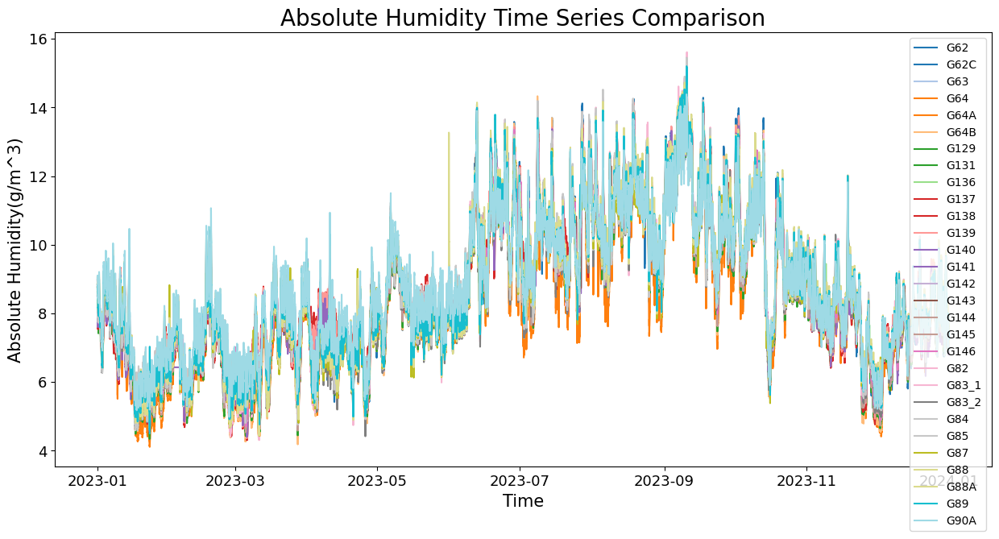

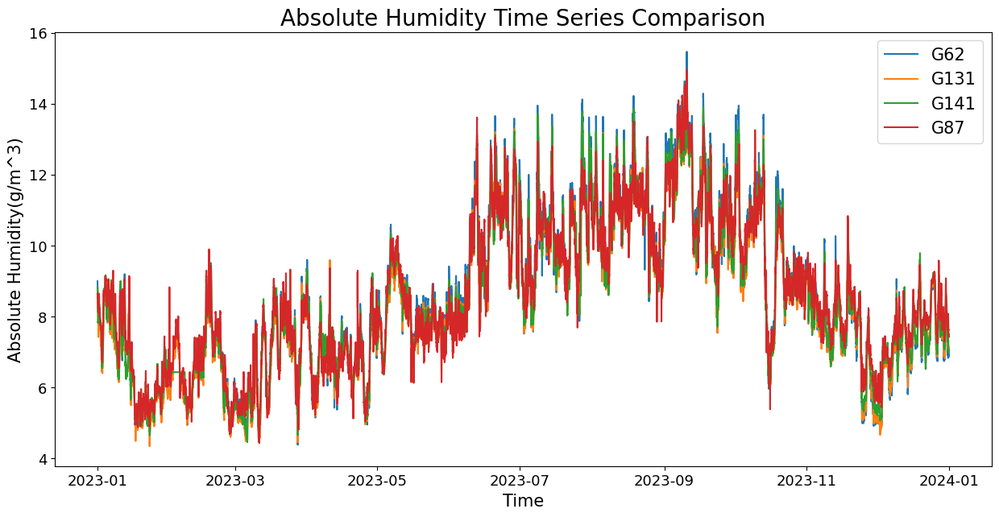

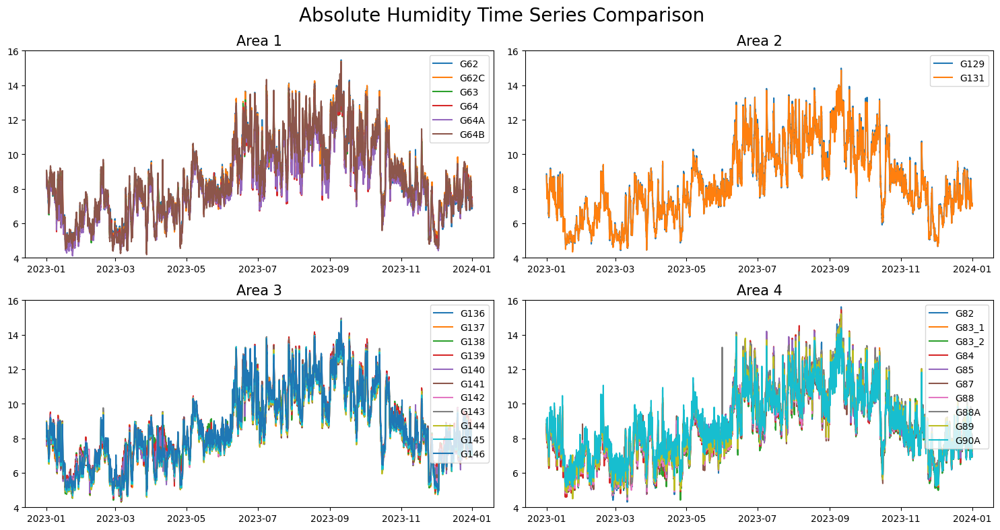

In [ ]:
from matplotlib.cm import get_cmap

rooms = list(data.keys())

# 获取一个颜色映射表 (colormap)
cmap = get_cmap('tab20')  # 使用'tab20' colormap

#全部房间
plt.figure(figsize=(15, 7))
for i in range(0,29):
  plt.plot(data[rooms[i]].index, data[rooms[i]].iloc[:,2], label=rooms[i],color=cmap(i / 29.0))

plt.title('Absolute Humidity Time Series Comparison', fontsize=20)

plt.xlabel('Time', fontsize=15)                # x轴标签字体大小
plt.ylabel('Absolute Humidity(g/m^3)', fontsize=15)                # y轴标签字体大小

# 添加图例
plt.legend(fontsize=10)                          # 图例字体大小

# 设置刻度标签的字体大小
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)

plt.show()

#区域间比较
plt.figure(figsize=(15, 7))
for i in [0,7,13,24]:
  plt.plot(data[rooms[i]].index, data[rooms[i]].iloc[:,2], label=rooms[i])

plt.title('Absolute Humidity Time Series Comparison', fontsize=20)

plt.xlabel('Time', fontsize=15)                # x轴标签字体大小
plt.ylabel('Absolute Humidity(g/m^3)', fontsize=15)                # y轴标签字体大小

# 添加图例
plt.legend(fontsize=15)                          # 图例字体大小

# 设置刻度标签的字体大小
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)

plt.show()

#区域内比较
# 创建画布和 2x2 子图
fig, axs = plt.subplots(2, 2, figsize=(15, 8))  # 2x2 子图排列，画布大小为 10x8 英寸
# 在各个子图上绘制折线图
for i in range(0,6):
  axs[0, 0].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,2], label=rooms[i])
axs[0, 0].set_title('Area 1', fontsize=15)
axs[0, 0].legend(loc='upper right', fontsize=10)

for i in range(6,8):
  axs[0, 1].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,2], label=rooms[i])
axs[0, 1].set_title('Area 2', fontsize=15)
axs[0, 1].legend(loc='upper right', fontsize=10)

for i in range(8,19):
  axs[1, 0].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,2], label=rooms[i])
axs[1, 0].set_title('Area 3', fontsize=15)
axs[1, 0].legend(loc='upper right', fontsize=10)

for i in range(19,29):
  axs[1, 1].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,2], label=rooms[i])
axs[1, 1].set_title('Area 4', fontsize=15)
axs[1, 1].legend(loc='upper right', fontsize=10)

for ax in axs.flat:
  ax.set_ylim(4,16)
# 设置画布总标题
fig.suptitle('Absolute Humidity Time Series Comparison', fontsize=20)

# 调整子图之间的间距
plt.tight_layout()

plt.show()

<ipython-input-39-c4916e12ac45>:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('tab20')  # 使用'tab20' colormap


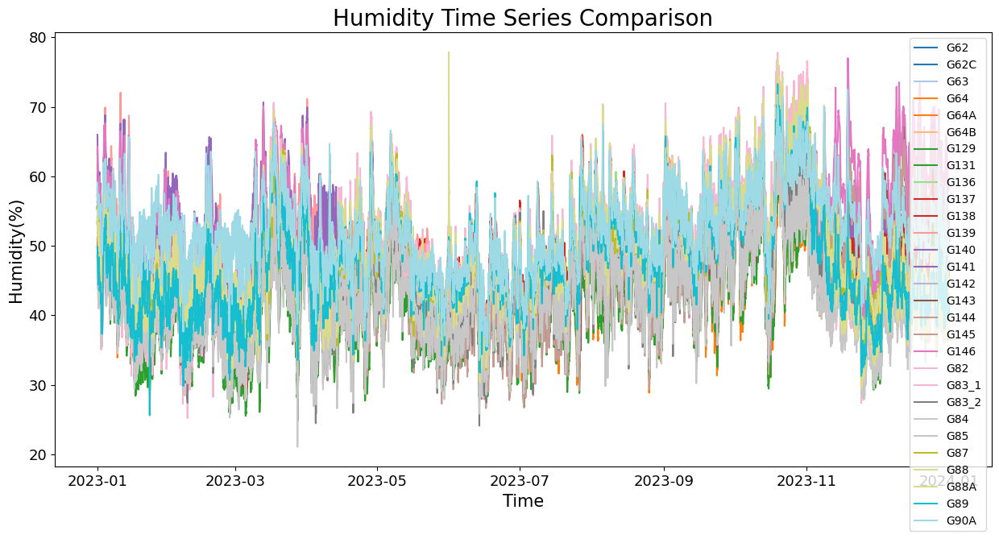

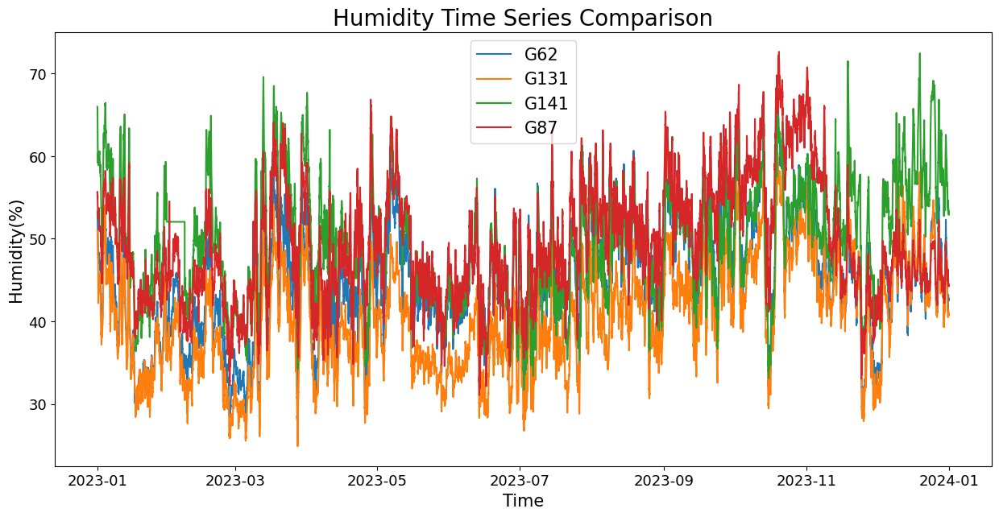

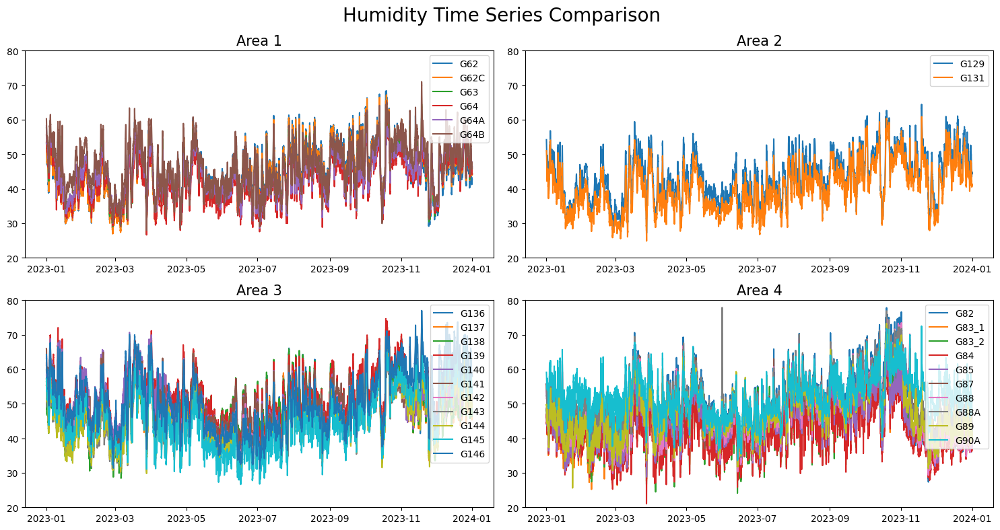

In [ ]:
from matplotlib.cm import get_cmap #相对湿度

rooms = list(data.keys())

# 获取一个颜色映射表 (colormap)
cmap = get_cmap('tab20')  # 使用'tab20' colormap

#全部房间
plt.figure(figsize=(15, 7))
for i in range(0,29):
  plt.plot(data[rooms[i]].index, data[rooms[i]].iloc[:,1], label=rooms[i],color=cmap(i / 29.0))

plt.title('Humidity Time Series Comparison', fontsize=20)

plt.xlabel('Time', fontsize=15)                # x轴标签字体大小
plt.ylabel('Humidity(%)', fontsize=15)                # y轴标签字体大小

# 添加图例
plt.legend(fontsize=10)                          # 图例字体大小

# 设置刻度标签的字体大小
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)

plt.show()

#区域间比较
plt.figure(figsize=(15, 7))
for i in [0,7,13,24]:
  plt.plot(data[rooms[i]].index, data[rooms[i]].iloc[:,1], label=rooms[i])

plt.title('Humidity Time Series Comparison', fontsize=20)

plt.xlabel('Time', fontsize=15)                # x轴标签字体大小
plt.ylabel('Humidity(%)', fontsize=15)                # y轴标签字体大小

# 添加图例
plt.legend(fontsize=15)                          # 图例字体大小

# 设置刻度标签的字体大小
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)

plt.show()

#区域内比较
# 创建画布和 2x2 子图
fig, axs = plt.subplots(2, 2, figsize=(15, 8))  # 2x2 子图排列，画布大小为 10x8 英寸
# 在各个子图上绘制折线图
for i in range(0,6):
  axs[0, 0].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,1], label=rooms[i])
axs[0, 0].set_title('Area 1', fontsize=15)
axs[0, 0].legend(loc='upper right', fontsize=10)

for i in range(6,8):
  axs[0, 1].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,1], label=rooms[i])
axs[0, 1].set_title('Area 2', fontsize=15)
axs[0, 1].legend(loc='upper right', fontsize=10)

for i in range(8,19):
  axs[1, 0].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,1], label=rooms[i])
axs[1, 0].set_title('Area 3', fontsize=15)
axs[1, 0].legend(loc='upper right', fontsize=10)

for i in range(19,29):
  axs[1, 1].plot(data[rooms[i]].index, data[rooms[i]].iloc[:,1], label=rooms[i])
axs[1, 1].set_title('Area 4', fontsize=15)
axs[1, 1].legend(loc='upper right', fontsize=10)

for ax in axs.flat:
  ax.set_ylim(20,80)
# 设置画布总标题
fig.suptitle('Humidity Time Series Comparison', fontsize=20)

# 调整子图之间的间距
plt.tight_layout()

plt.show()

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss  #检验T平稳性
for room, room_data in data.items():
# ADF检验
    adf_result = adfuller(data[room].iloc[:,0])
    print(f'ADF Statistic: {adf_result[0]}')
    print(f'p-value: {adf_result[1]}')
    if adf_result[1] <= 0.05:
        print("平稳的")
    else:
        print("Fail to reject null hypothesis: Time series is non-stationary")

    # KPSS检验
    kpss_result = kpss(room_data.iloc[:,0], regression='c')
    print(f'KPSS Statistic: {kpss_result[0]}')
    print(f'p-value: {kpss_result[1]}')
    if kpss_result[1] >= 0.05:
        print("平稳的")
    else:
        print("Fail to reject null hypothesis: Time series is non-stationary")


ADF Statistic: -1.457900475158969
p-value: 0.5542251666578221
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.391274516488035
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.4644324314509065
p-value: 0.551027048879791
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.457611860709569
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -0.9952425727656152
p-value: 0.7549955060902177
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.8543782637743
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.4791808168157938
p-value: 0.54378400621577
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.778330154206309
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.0916641808756344
p-value: 0.7183846594593088
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 9.148392813195644
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.482464193061039
p-value: 0.5421675312978788
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 9.405824861621827
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.1583517427626437
p-value: 0.6912504114177374
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.797909306149992
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.0490943523841696
p-value: 0.2654701182894907
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.069380062644944
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.42760383945726
p-value: 0.5689733037817646
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.603340260112883
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.358672509573259
p-value: 0.15374201740343646
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.57799123974442
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.61552098570319
p-value: 0.4750782405435175
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.396076239630684
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.6439556495575898
p-value: 0.4601946070266644
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.984976014448879
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.5355033554380417
p-value: 0.515880985074064
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 11.01199586626755
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -0.9160195822796656
p-value: 0.7826511735786423
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 9.727859911816015
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.1622842826136766
p-value: 0.6896061058385556
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.37640657139683
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.5123742602783912
p-value: 0.5273813301015119
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 6.926621208053195
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.1578099477247714
p-value: 0.6914765739790242
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.217928381080252
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.8008781583118039
p-value: 0.38002579962045047
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.4182684027711865
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -0.8740288662674572
p-value: 0.796404742598147
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.621539185728895
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.7310031010535836
p-value: 0.06882530480438132
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 9.474705578616431
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -3.864975937864481
p-value: 0.0023082708296069325
平稳的
KPSS Statistic: 6.892393916674219
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -5.267799491097419
p-value: 6.382390596104612e-06
平稳的
KPSS Statistic: 6.267402256820135
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -3.2764223047639818
p-value: 0.015965861072200178
平稳的
KPSS Statistic: 9.35171010982034
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.799473160925572
p-value: 0.3807232859387893
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.501784377583612
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.002101716447506
p-value: 0.2856523307878046
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.476643393109118
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.0782748740828265
p-value: 0.2533396284540882
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.209348846143994
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.116315993255724
p-value: 0.238004671150588
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 8.240887941542265
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -2.4926884278400645
p-value: 0.11726345983175568
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.684374678993843
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


ADF Statistic: -1.8697555279907574
p-value: 0.3464200458842202
Fail to reject null hypothesis: Time series is non-stationary
KPSS Statistic: 7.712979736852402
p-value: 0.01
Fail to reject null hypothesis: Time series is non-stationary


<ipython-input-41-2fc99531e77a>:13: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(room_data.iloc[:,0], regression='c')


In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss  #检验RH平稳性
for room, room_data in data.items():
# ADF检验
    adf_result = adfuller(data[room].iloc[:,1])
    print(f'ADF Statistic: {adf_result[0]}')
    print(f'p-value: {adf_result[1]}')
    if adf_result[1] <= 0.05:
        print("平稳的")
    else:
        print("Fail to reject null hypothesis: Time series is non-stationary")

    # KPSS检验
    kpss_result = kpss(room_data.iloc[:,0], regression='c')
    print(f'KPSS Statistic: {kpss_result[0]}')
    print(f'p-value: {kpss_result[1]}')
    if kpss_result[1] >= 0.05:
        print("平稳的")
    else:
        print("Fail to reject null hypothesis: Time series is non-stationary")


In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss #检验AH平稳性
for room, room_data in data.items():
# ADF检验
    adf_result = adfuller(data[room].iloc[:,2])
    print(f'ADF Statistic: {adf_result[0]}')
    print(f'p-value: {adf_result[1]}')
    if adf_result[1] <= 0.05:
        print("平稳的")
    else:
        print("Fail to reject null hypothesis: Time series is non-stationary")

    # KPSS检验
    kpss_result = kpss(room_data.iloc[:,0], regression='c')
    print(f'KPSS Statistic: {kpss_result[0]}')
    print(f'p-value: {kpss_result[1]}')
    if kpss_result[1] >= 0.05:
        print("平稳的")
    else:
        print("Fail to reject null hypothesis: Time series is non-stationary")


In [ ]:
data_15m=data

##改变时间间隔

In [ ]:

import pandas as pd


# 创建一个空字典以存储每个房间的重采样数据
resampled_data = {}

for room, df in data.items():
    # 按小时重采样并计算平均值
    df_hourly = df.resample('H').mean()

    # 将处理后的数据存入新字典
    resampled_data[room] = df_hourly

# 检查结果
for room, df_hourly in resampled_data.items():
    print(f"Hourly data for {room}:")
    print(df_hourly)
    print()


Hourly data for G62:
                     SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH  \
Date                                                          
2023-01-01 00:00:00          19.600000            53.175000   
2023-01-01 01:00:00          19.600000            52.795833   
2023-01-01 02:00:00          19.600000            52.108333   
2023-01-01 03:00:00          19.575000            51.150000   
2023-01-01 04:00:00          19.512500            50.112500   
...                                ...                  ...   
2023-12-31 19:00:00          19.091667            42.983333   
2023-12-31 20:00:00          19.058333            42.825000   
2023-12-31 21:00:00          18.991667            42.666667   
2023-12-31 22:00:00          18.925000            42.745833   
2023-12-31 23:00:00          18.887500            42.645833   

                     SKA G62 Chan: 3 g/m^3AH  Temperature  Humidity  
Date                                                                 
2023-01-01 00:00:00

In [ ]:
data_1h=resampled_data
data_1h['G129']

,SKA G129 Chan: 1 C,SKA G129 Chan: 2 %RH,Temperature,Humidity
Date,,,,
2023-01-01 00:00:00,19.066667,54.045833,1.596192,1.596192
2023-01-01 01:00:00,19.000000,53.604167,1.529313,1.529313
2023-01-01 02:00:00,19.000000,52.720833,1.395555,1.395555
2023-01-01 03:00:00,19.000000,51.787500,1.254226,1.254226
2023-01-01 04:00:00,18.941667,50.945833,1.126778,1.126778
...,...,...,...,...
2023-12-31 19:00:00,18.600000,44.808333,0.197413,0.197413
2023-12-31 20:00:00,18.600000,44.687500,0.179116,0.179116
2023-12-31 21:00:00,18.600000,44.558333,0.159557,0.159557


In [ ]:
data=data_1h

In [ ]:

import pandas as pd


# 创建一个空字典以存储每个房间的重采样数据
resampled_data = {}

for room, df in data.items():
    # 按小时重采样并计算平均值
    df_hourly = df.resample('D').mean()

    # 将处理后的数据存入新字典
    resampled_data[room] = df_hourly

# 检查结果
for room, df_hourly in resampled_data.items():
    print(f"Hourly data for {room}:")
    print(df_hourly)
    print()
data_1d=resampled_data
data_1d['G129']

Hourly data for G62:
            SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH  SKA G62 Chan: 3 g/m^3AH  \
Date                                                                          
2023-01-01          19.776389            48.595139                 8.290915   
2023-01-02          19.857118            43.030382                 7.374005   
2023-01-03          19.548785            45.861285                 7.721639   
2023-01-04          19.769792            51.108507                 8.714410   
2023-01-05          20.067708            48.267882                 8.380969   
...                       ...                  ...                      ...   
2023-12-27          19.163542            48.221875                 7.938785   
2023-12-28          19.339583            47.463194                 7.896865   
2023-12-29          19.408681            43.701215                 7.298019   
2023-12-30          19.130729            46.371007                 7.621973   
2023-12-31          19.144271  

,SKA G129 Chan: 1 C,SKA G129 Chan: 2 %RH,Temperature,Humidity
Date,,,,
2023-01-01,19.126215,49.651215,0.930741,0.930741
2023-01-02,19.121181,44.121354,0.093388,0.093388
2023-01-03,18.834722,46.964757,0.523947,0.523947
2023-01-04,19.114931,52.602431,1.377626,1.377626
2023-01-05,19.421181,49.357292,0.886234,0.886234
...,...,...,...,...
2023-12-27,18.547569,50.896701,1.119338,1.119338
2023-12-28,18.802951,49.881076,0.965548,0.965548
2023-12-29,18.819271,46.054080,0.386049,0.386049


In [ ]:
data=data_1d

In [ ]:
data

{'G62':             SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH  SKA G62 Chan: 3 g/m^3AH  \
 Date                                                                          
 2023-01-01          19.776389            48.595139                 8.290915   
 2023-01-02          19.857118            43.030382                 7.374005   
 2023-01-03          19.548785            45.861285                 7.721639   
 2023-01-04          19.769792            51.108507                 8.714410   
 2023-01-05          20.067708            48.267882                 8.380969   
 ...                       ...                  ...                      ...   
 2023-12-27          19.163542            48.221875                 7.938785   
 2023-12-28          19.339583            47.463194                 7.896865   
 2023-12-29          19.408681            43.701215                 7.298019   
 2023-12-30          19.130729            46.371007                 7.621973   
 2023-12-31          19.144271   

##Absolute Differences


###Euclidean Distance

In [ ]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
data_backup=data

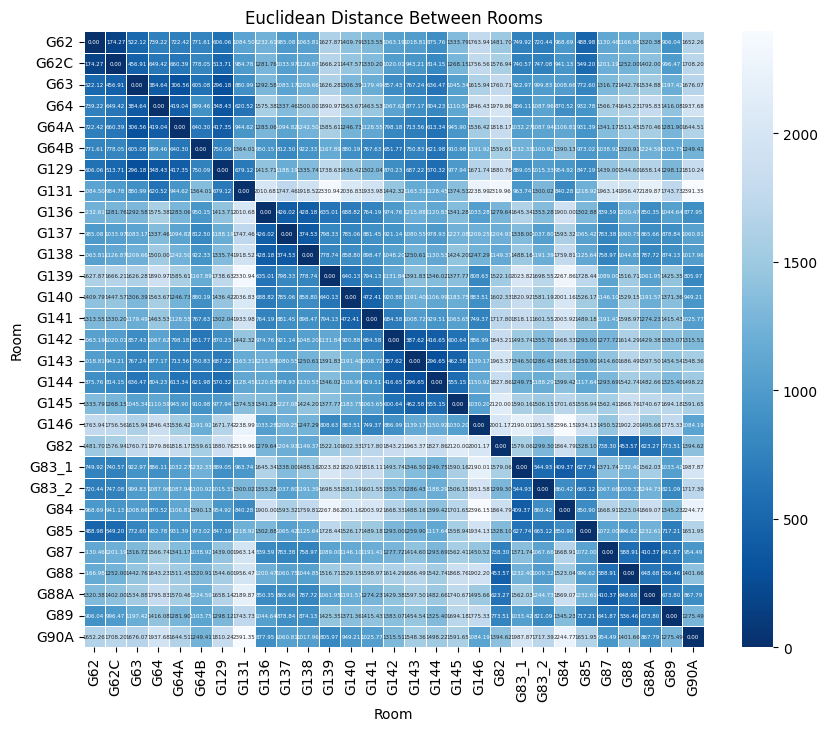

In [ ]:
# 定义数据集目录   对的综合变量方法   综合三个变量原始数据
# 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data.keys())



# 初始化欧氏距离矩阵
distance_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算欧氏距离
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            distance_T = np.linalg.norm(data[rooms[i]].iloc[:,0]-data[rooms[j]].iloc[:,0])
            distance_RH = np.linalg.norm(data[rooms[i]].iloc[:,1]-data[rooms[j]].iloc[:,1])
            distance_AH = np.linalg.norm(data[rooms[i]].iloc[:,2]-data[rooms[j]].iloc[:,2])
            distance_matrix.iloc[i, j] = np.sqrt( distance_T** 2 + distance_RH ** 2 + distance_AH ** 2)
            distance_matrix.iloc[j, i] = distance_matrix.iloc[i, j]  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True,annot_kws={"size": 4}, cmap='Blues_r', fmt='.2f', linewidths=.5)
plt.title('Euclidean Distance Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


NameError: name 'colors_dict' is not defined

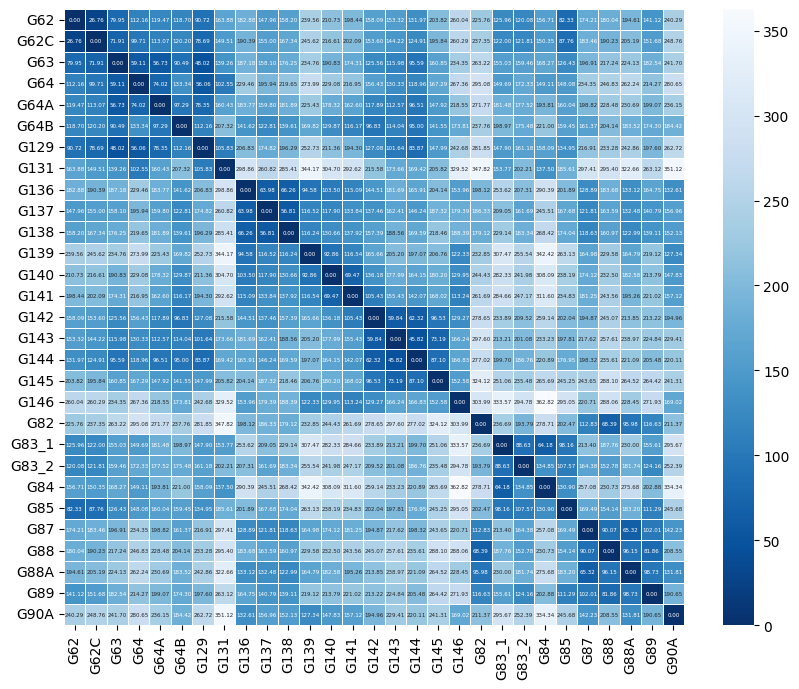

In [ ]:
# 定义数据集目录   对的综合变量方法    最终结果
data_dir =data  # 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data_dir.keys())



# 初始化欧氏距离矩阵
distance_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算欧氏距离
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            distance_T = np.linalg.norm(data[rooms[i]].iloc[:,6]-data[rooms[j]].iloc[:,6])
            distance_RH = np.linalg.norm(data[rooms[i]].iloc[:,7]-data[rooms[j]].iloc[:,7])
            distance_AH = np.linalg.norm(data[rooms[i]].iloc[:,8]-data[rooms[j]].iloc[:,8])
            #distance_matrix.iloc[i, j] = np.sqrt( distance_T** 2 +  distance_AH ** 2)
            distance_matrix.iloc[i, j] = np.sqrt( distance_T** 2 +  distance_RH ** 2 + distance_AH ** 2)
            distance_matrix.iloc[j, i] = distance_matrix.iloc[i, j]  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(distance_matrix, annot=True,annot_kws={"size": 4}, cmap='Blues_r', fmt='.2f', linewidths=.5)

# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Euclidean Distance Between Rooms (Normalized)')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()
print(distance_matrix)

In [ ]:
#D3D3D3
中灰色（Medium Gray）：#A9A9A9
深灰色（Dark Gray）：#696969
很深的灰色（Dim Gray）：#585858

<ipython-input-37-3fc769a58a91>:6: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, method='average')


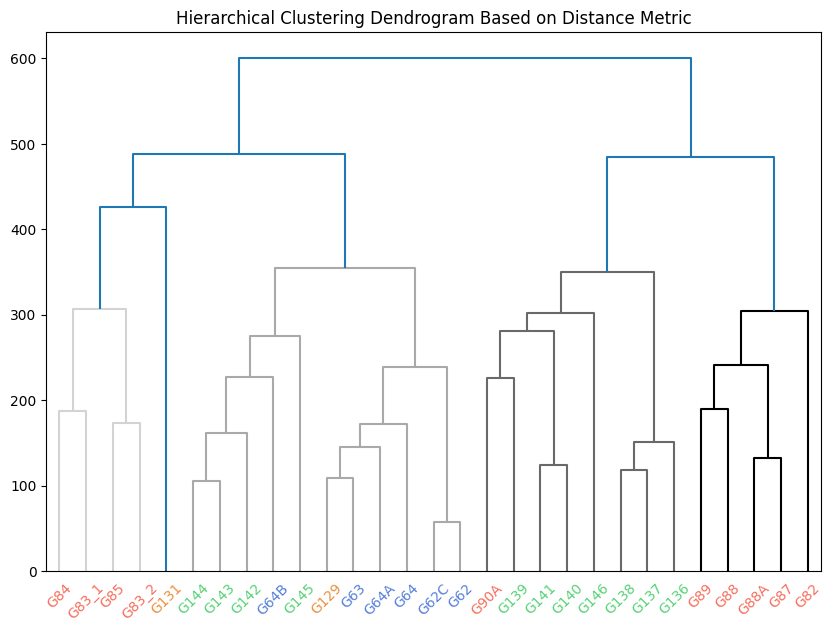

In [ ]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette

# 使用层次聚类进行聚类
linked = linkage(distance_matrix, method='average')


# 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系


# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendro = dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
                    show_leaf_counts=True, color_threshold=0.7*max(linked[:, 2]))
# 改变聚类标签颜色
ax = plt.gca()  # 获取当前的轴对象
x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

for label in x_labels:
    text = label.get_text()  # 获取标签文本
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # 蓝色
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # 橙色
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # 绿色
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # 红色
plt.title('Hierarchical Clustering Dendrogram Based on Distance Metric')
plt.show()

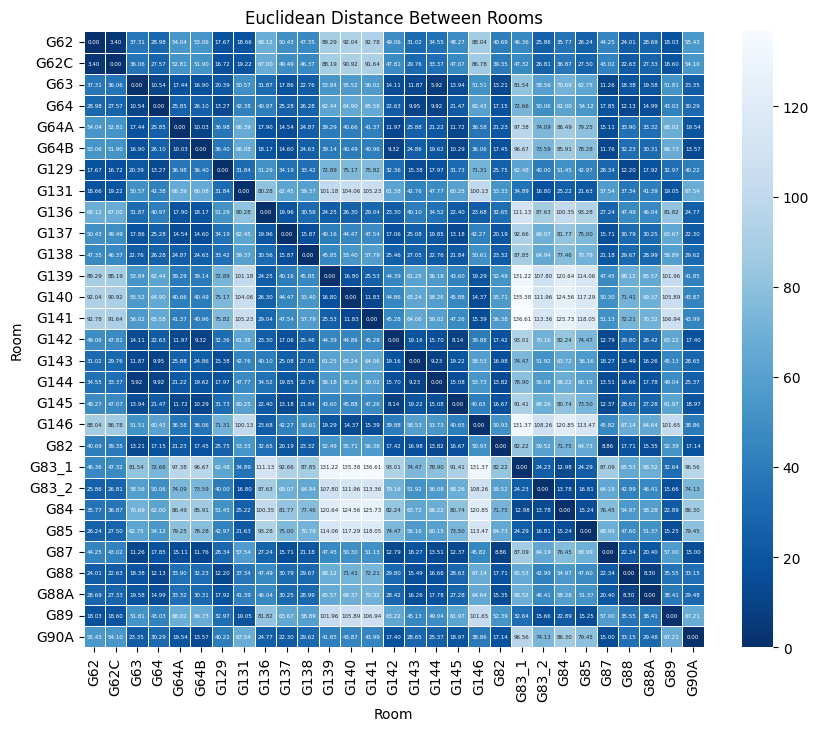

             G62       G62C        G63        G64       G64A       G64B  \
G62     0.000000   3.399160  37.307062  28.984815  54.042847  53.063461   
G62C    3.399160   0.000000  36.064096  27.573122  52.808628  51.895390   
G63    37.307062  36.064096   0.000000  10.535609  17.435641  16.896385   
G64    28.984815  27.573122  10.535609   0.000000  25.849418  26.096979   
G64A   54.042847  52.808628  17.435641  25.849418   0.000000  10.025795   
G64B   53.063461  51.895390  16.896385  26.096979  10.025795   0.000000   
G129   17.665495  16.724443  20.394670  13.272369  36.983202  36.403571   
G131   18.664209  19.220719  50.567015  42.376822  66.389083  66.076297   
G136   68.122146  67.000610  31.873106  40.972565  17.895930  18.173229   
G137   50.425781  49.492208  17.856986  25.282444  14.536283  14.596518   
G138   47.345545  46.368251  22.763750  26.279274  24.868062  24.631551   
G139   89.291415  88.189047  53.841171  62.443153  39.291468  39.135278   
G140   92.036480  90.9242

In [ ]:
# 定义数据集目录   对的综合变量方法
data=data_1w  # 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data_dir.keys())



# 初始化欧氏距离矩阵
distance_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算欧氏距离
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            distance_T = np.linalg.norm(data[rooms[i]].iloc[:,0]-data[rooms[j]].iloc[:,0])
            distance_AH = np.linalg.norm(data[rooms[i]].iloc[:,2]-data[rooms[j]].iloc[:,2])
            distance_matrix.iloc[i, j] = np.sqrt( distance_T** 2 + distance_AH ** 2)
            distance_matrix.iloc[j, i] = distance_matrix.iloc[i, j]  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True,annot_kws={"size": 4}, cmap='Blues_r', fmt='.2f', linewidths=.5)
plt.title('Euclidean Distance Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()
print(distance_matrix)

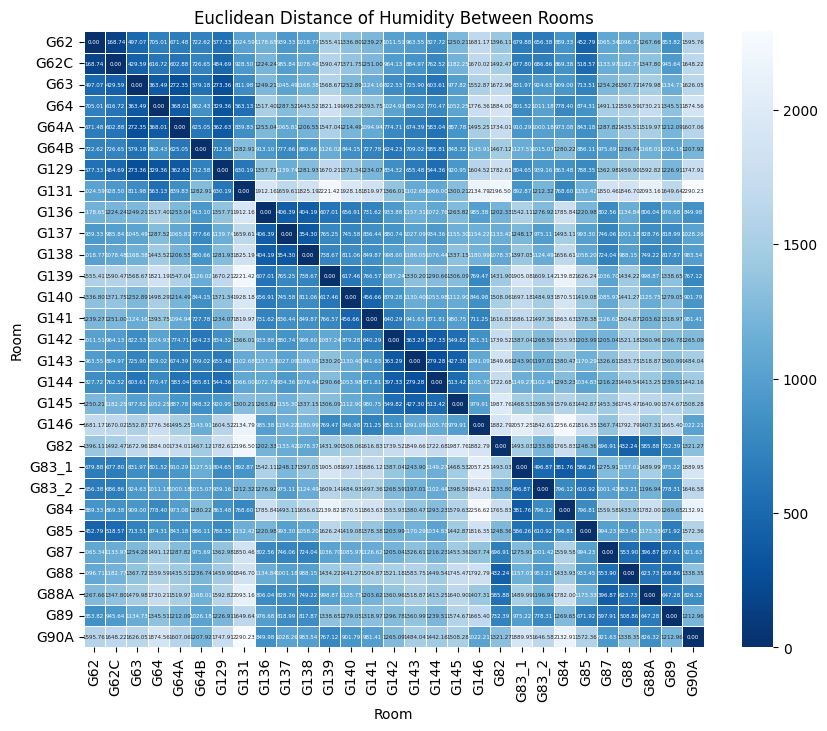

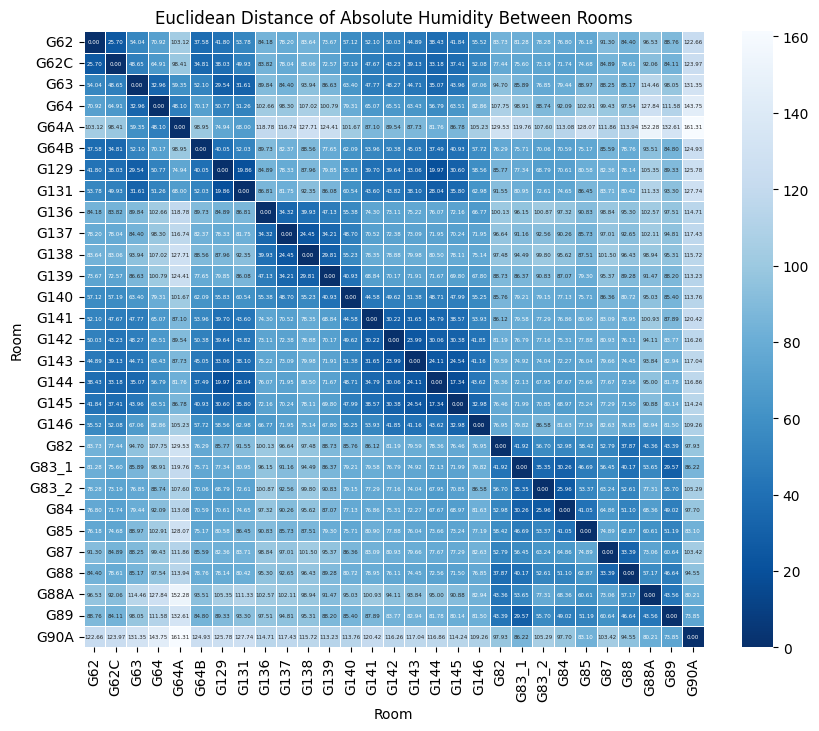

In [ ]:
# 定义数据集目录   对的综合变量方法
  # 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data.keys())



# 初始化欧氏距离矩阵
distance_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算欧氏距离
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            distance_T = np.linalg.norm(data[rooms[i]].iloc[:,0]-data[rooms[j]].iloc[:,0])
            distance_RH = np.linalg.norm(data[rooms[i]].iloc[:,1]-data[rooms[j]].iloc[:,1])
            distance_matrix.iloc[i, j] = distance_RH
            distance_matrix.iloc[j, i] = distance_matrix.iloc[i, j]  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True,annot_kws={"size": 4}, cmap='Blues_r', fmt='.2f', linewidths=.5)
plt.title('Euclidean Distance of Humidity Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')





# 初始化欧氏距离矩阵
distance_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算欧氏距离
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            distance_T = np.linalg.norm(data[rooms[i]].iloc[:,0]-data[rooms[j]].iloc[:,0])
            distance_AH = np.linalg.norm(data[rooms[i]].iloc[:,2]-data[rooms[j]].iloc[:,2])
            distance_matrix.iloc[i, j] = distance_AH
            distance_matrix.iloc[j, i] = distance_matrix.iloc[i, j]  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True,annot_kws={"size": 4}, cmap='Blues_r', fmt='.2f', linewidths=.5)
plt.title('Euclidean Distance of Absolute Humidity Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


### MAD/Manhattan Distance

In [ ]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

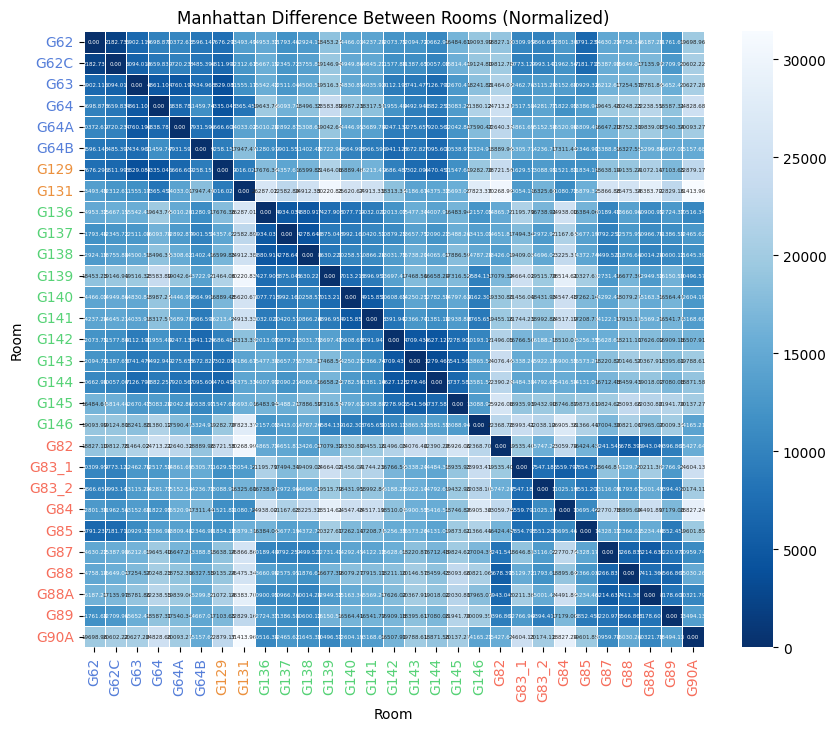

In [ ]:
# 综合三个变量原始数据

# 定义数据集目录
data_dir =data  # 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data_dir.keys())

# 初始化平均绝对差异矩阵
mad_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算平均绝对差异
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            mad_T = np.sum(np.abs(data[rooms[i]].iloc[:,6]-data[rooms[j]].iloc[:,6]))
            mad_RH = np.sum(np.abs(data[rooms[i]].iloc[:,7]-data[rooms[j]].iloc[:,7]))
            mad_AH = np.sum(np.abs(data[rooms[i]].iloc[:,8]-data[rooms[j]].iloc[:,8]))
            #mad = np.sqrt(mad_T** 2 + mad_AH ** 2)
            mad = (mad_T + mad_RH + mad_AH) / 3
            #mad = (mad_T + mad_AH) / 2
            #mad = np.mean(np.abs(data[rooms[i]].iloc[:,0]-data[rooms[j]].iloc[:,0])

            mad_matrix.iloc[i, j] = mad
            mad_matrix.iloc[j, i] = mad  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(mad_matrix, annot=True,annot_kws={"size": 4},  cmap='Blues_r', fmt='.2f', linewidths=.5)
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}


# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Manhattan Difference Between Rooms (Normalized)')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


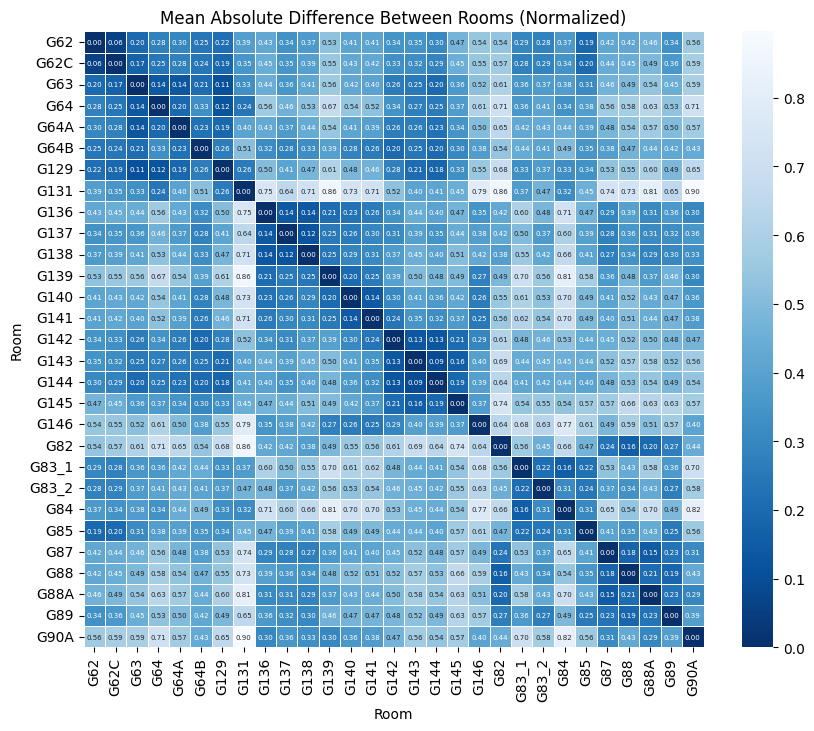

In [ ]:
# 综合三个变量标准化数据

# 定义数据集目录
data_dir =data  # 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data_dir.keys())

# 初始化平均绝对差异矩阵
mad_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算平均绝对差异
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            mad_T = np.mean(np.abs(data[rooms[i]].iloc[:,6]-data[rooms[j]].iloc[:,6]))
            mad_RH = np.mean(np.abs(data[rooms[i]].iloc[:,7]-data[rooms[j]].iloc[:,7]))
            mad_AH = np.mean(np.abs(data[rooms[i]].iloc[:,8]-data[rooms[j]].iloc[:,8]))
            #mad = np.sqrt(mad_T** 2 + mad_AH ** 2)
            mad = (mad_T + mad_RH + mad_AH) / 3
            #mad = (mad_T + mad_AH) / 2
            #mad = np.mean(np.abs(data[rooms[i]].iloc[:,0]-data[rooms[j]].iloc[:,0])

            mad_matrix.iloc[i, j] = mad
            mad_matrix.iloc[j, i] = mad  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(mad_matrix, annot=True,annot_kws={"size": 5},  cmap='Blues_r', fmt='.2f', linewidths=.5)
plt.title('Mean Absolute Difference Between Rooms (Normalized)')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()



##Relative Differences

###MRD

In [ ]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


# 获取所有房间名称
rooms = list(data.keys())

# 初始化 MRD 矩阵
mrd_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算 MRD
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            T_A = data[rooms[i]].iloc[:,0]
            T_B = data[rooms[j]].iloc[:,0]

            # 确保时间序列长度相同
            if len(T_A) != len(T_B):
                raise ValueError(f"时间序列长度不匹配: {rooms[i]} 和 {rooms[j]}")

            # 计算 MRD
            numerator = np.abs(T_A - T_B)
            denominator = 0.5 * (T_A + T_B)
            mrd = np.mean(numerator / denominator)

            # 更新 MRD 矩阵
            mrd_matrix.iloc[i, j] = mrd
            mrd_matrix.iloc[j, i] = mrd  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(12, 10))
sns.heatmap(mrd_matrix, annot=True,annot_kws={"size": 7}, cmap='coolwarm', fmt='.2f', linewidths=.5)
plt.title('Mean Relative Difference (MRD) of Temperatures Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


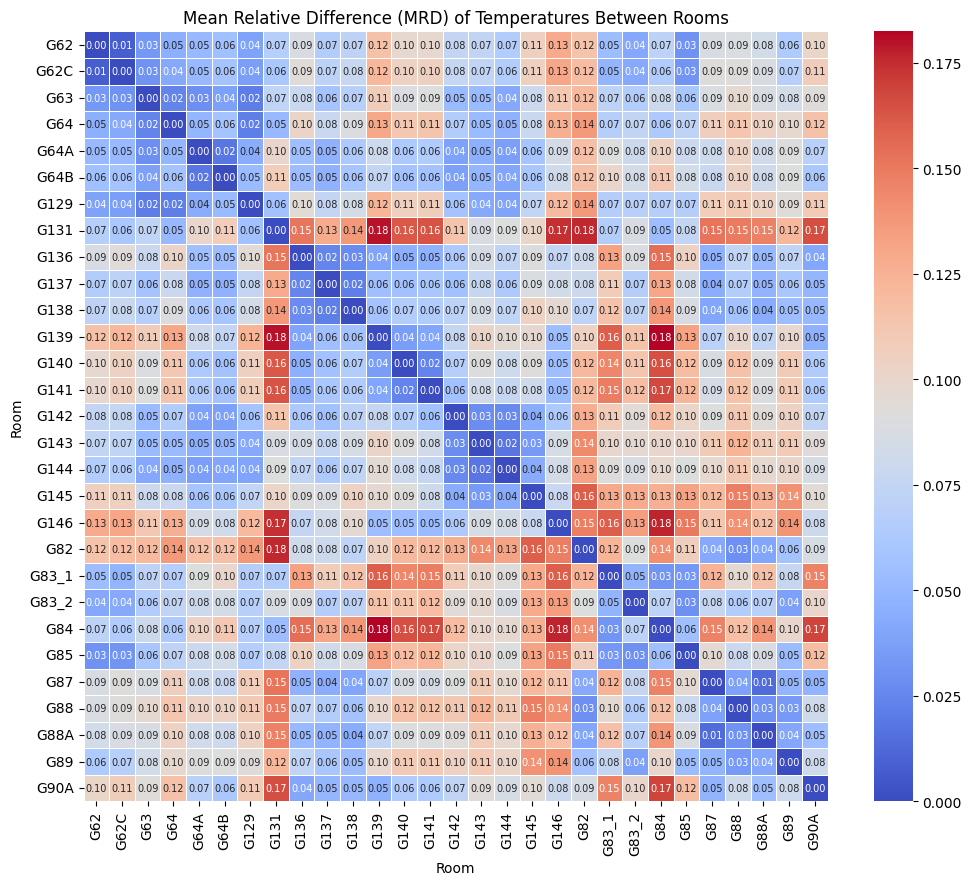

In [ ]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


# 获取所有房间名称
rooms = list(data.keys())

# 初始化 MRD 矩阵
mrd_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算 MRD
for i in range(len(rooms)):
    for j in range(i, len(rooms)):
        if i != j:
            T_A = data[rooms[i]].iloc[:,0]
            T_B = data[rooms[j]].iloc[:,0]

            # 确保时间序列长度相同
            if len(T_A) != len(T_B):
                raise ValueError(f"时间序列长度不匹配: {rooms[i]} 和 {rooms[j]}")

            # 计算 MRD
            numerator = np.abs(T_A - T_B)
            denominator = 0.5 * (T_A + T_B)
            mrd = np.mean(numerator / denominator)

            # 更新 MRD 矩阵
            mrd_matrix.iloc[i, j] = mrd
            mrd_matrix.iloc[j, i] = mrd  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(12, 10))
sns.heatmap(mrd_matrix, annot=True,annot_kws={"size": 7}, cmap='coolwarm', fmt='.2f', linewidths=.5)
plt.title('Mean Relative Difference (MRD) of Temperatures Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


##Angles and Proportions

###Cosine Similarity

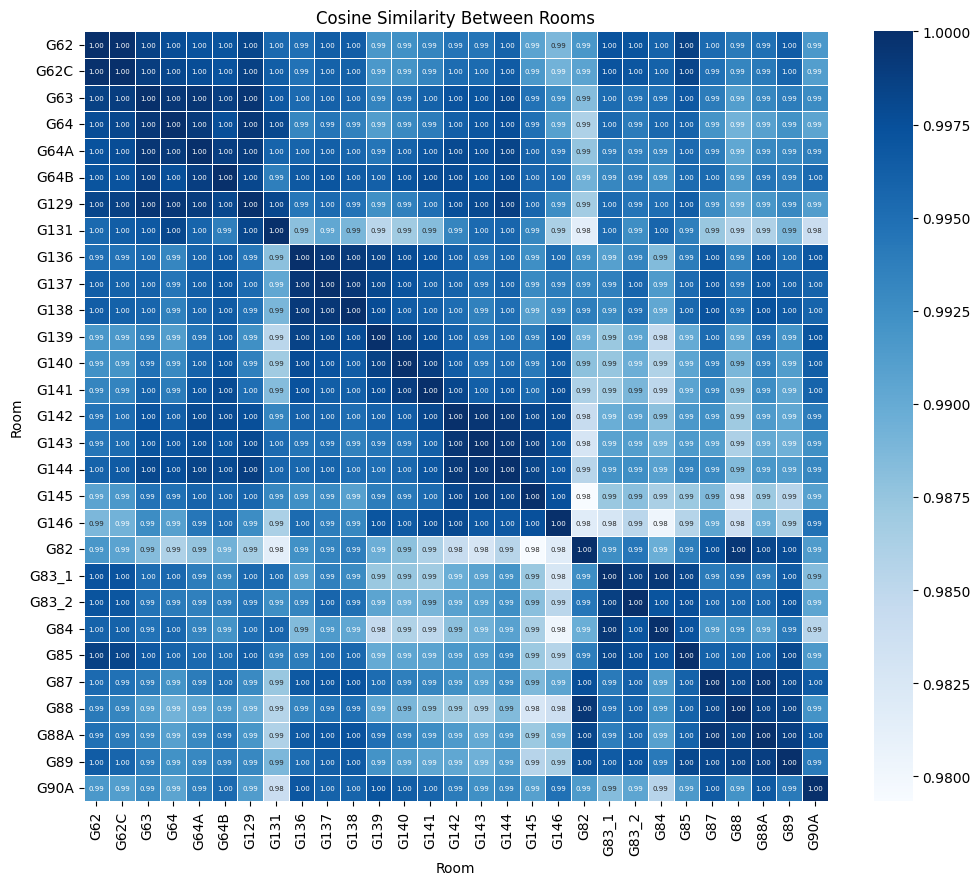

In [ ]:
# 综合三个变量原始数据

import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler


# 初始化 CS 矩阵
cs_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算 CS

for i in range(len(rooms)):
    for j in range(i, len(rooms)):

            room1_temp = data[rooms[i]].iloc[:,0]
            room2_temp = data[rooms[j]].iloc[:,0]
            room1_humidity = data[rooms[i]].iloc[:,1]
            room2_humidity = data[rooms[j]].iloc[:,1]
            room1_absolute_humidity = data[rooms[i]].iloc[:,2]
            room2_absolute_humidity = data[rooms[j]].iloc[:,2]

            # 将所有房间的温度数据整理为一个矩阵
            #temperature_matrix = np.array([T_A,T_B])
            #adhumidity_matrix = np.array([AH_A,AH_B])


            # 合并温度和湿度数据 (已标准化)

            #room1_data = np.concatenate((room1_temp, room1_humidity))
            room1_data = np.concatenate((room1_temp, room1_humidity, room1_absolute_humidity))
            #room2_data = np.concatenate((room2_temp, room2_humidity))
            room2_data = np.concatenate((room2_temp, room2_humidity, room2_absolute_humidity))

            # 计算余弦相似度
            cosine_sim = cosine_similarity([room1_data], [room2_data])

            # 计算余弦相似度矩阵
            #cosine_sim_matrix_T = cosine_similarity(temperature_matrix)
            #cosine_sim_matrix_AH = cosine_similarity(adhumidity_matrix)

            # 更新 MRD 矩阵
            #cs_matrix.iloc[i, j] = ( cosine_sim_matrix_T[0,1] + cosine_sim_matrix_AH[0,1] ) / 2
            cs_matrix.iloc[i, j] = cosine_sim[0,0]
            #cs_matrix.iloc[i, j] = np.sqrt(cosine_sim_matrix_T[0,1]**2 + cosine_sim_matrix_AH[0,1]**2)
            cs_matrix.iloc[j, i] = cs_matrix.iloc[i, j]  # 对称矩阵



# 绘制热力图
plt.figure(figsize=(12, 10))
sns.heatmap(cs_matrix, annot=True,annot_kws={"size": 5}, cmap='Blues', fmt='.2f', linewidths=.5, vmin=np.min(cs_matrix), vmax=1.0)
plt.title('Cosine Similarity Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


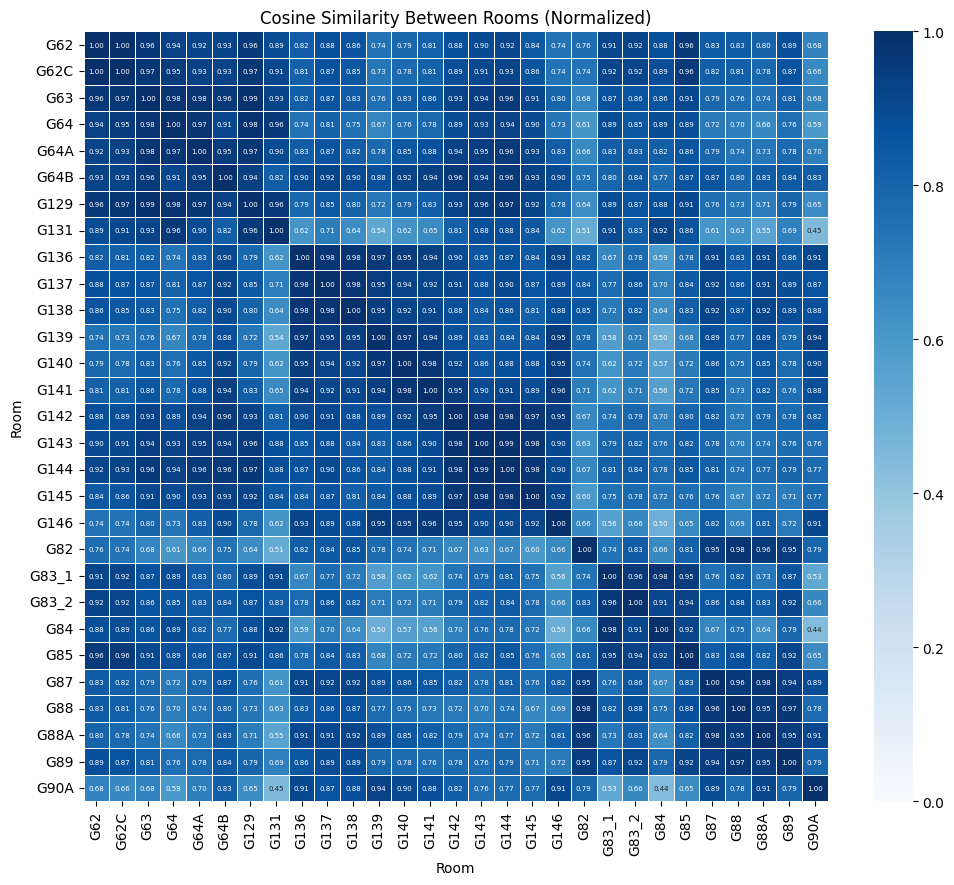

In [ ]:
# 综合三个变量标准化数据

import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler


# 初始化 CS 矩阵
cs_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算 CS

for i in range(len(rooms)):
    for j in range(i, len(rooms)):

            room1_temp = data[rooms[i]].iloc[:,6]
            room2_temp = data[rooms[j]].iloc[:,6]
            room1_humidity = data[rooms[i]].iloc[:,7]
            room2_humidity = data[rooms[j]].iloc[:,7]
            room1_absolute_humidity = data[rooms[i]].iloc[:,8]
            room2_absolute_humidity = data[rooms[j]].iloc[:,8]

            # 将所有房间的温度数据整理为一个矩阵
            #temperature_matrix = np.array([T_A,T_B])
            #adhumidity_matrix = np.array([AH_A,AH_B])


            # 合并温度和湿度数据 (已标准化)

            #room1_data = np.concatenate((room1_temp, room1_humidity))
            room1_data = np.concatenate((room1_temp, room1_humidity, room1_absolute_humidity))
            #room2_data = np.concatenate((room2_temp, room2_humidity))
            room2_data = np.concatenate((room2_temp, room2_humidity, room2_absolute_humidity))

            # 计算余弦相似度
            cosine_sim = cosine_similarity([room1_data], [room2_data])

            # 计算余弦相似度矩阵
            #cosine_sim_matrix_T = cosine_similarity(temperature_matrix)
            #cosine_sim_matrix_AH = cosine_similarity(adhumidity_matrix)

            # 更新 MRD 矩阵
            #cs_matrix.iloc[i, j] = ( cosine_sim_matrix_T[0,1] + cosine_sim_matrix_AH[0,1] ) / 2
            cs_matrix.iloc[i, j] = cosine_sim[0,0]
            #cs_matrix.iloc[i, j] = np.sqrt(cosine_sim_matrix_T[0,1]**2 + cosine_sim_matrix_AH[0,1]**2)
            cs_matrix.iloc[j, i] = cs_matrix.iloc[i, j]  # 对称矩阵



# 绘制热力图
plt.figure(figsize=(12, 10))
sns.heatmap(cs_matrix, annot=True,annot_kws={"size": 5}, cmap='Blues', fmt='.2f', linewidths=.5, vmin=0, vmax=1.0)
plt.title('Cosine Similarity Between Rooms (Normalized)')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


In [ ]:
room1_temp = data[rooms[0]].iloc[:,0]
room2_temp = data[rooms[1]].iloc[:,0]
room1_humidity = data[rooms[0]].iloc[:,2]
room2_humidity = data[rooms[1]].iloc[:,2]
room1_data = pd.DataFrame({'Temperature': room1_temp, 'Humidity': room1_humidity})
room2_data = pd.DataFrame({'Temperature': room2_temp, 'Humidity': room2_humidity})

# 标准化数据
scaler = StandardScaler()
room1_standardized = scaler.fit_transform(room1_data)#两列数据分别标准化
room2_standardized = scaler.transform(room2_data)#以room1为标准，进行转换room2的数据
# 计算余弦相似度
cosine_sim_raw = cosine_similarity([room1_standardized.flatten()], [room2_standardized.flatten()])
print(room1_standardized.flatten(),room2_standardized.flatten())
print(cosine_sim_raw[0,0])


room1_temp = data[rooms[0]].iloc[:,3]
room2_temp = data[rooms[1]].iloc[:,3]
room1_humidity = data[rooms[0]].iloc[:,4]
room2_humidity = data[rooms[1]].iloc[:,4]

# 将所有房间的温度数据整理为一个矩阵
#temperature_matrix = np.array([T_A,T_B])
#adhumidity_matrix = np.array([AH_A,AH_B])
# 合并温度和湿度数据
room1_data = pd.DataFrame({'Temperature': room1_temp, 'Humidity': room1_humidity})
room2_data = pd.DataFrame({'Temperature': room2_temp, 'Humidity': room2_humidity})

# 计算余弦相似度
cosine_sim = cosine_similarity([room1_data.values.flatten()], [room2_data.values.flatten()])
print(room1_data.values.flatten(),room2_data.values.flatten())
print(cosine_sim[0,0])

[-0.6105153   0.20648478 -0.6105153  ... -0.75493042 -0.87684164
 -0.77555319] [-0.65157057  0.22129595 -0.65157057 ... -0.63220086 -0.89663327
 -0.63595504]
0.9985712834444388
[-0.61050659  0.20648183 -0.61050659 ... -0.75491965 -0.87682913
 -0.77554213] [-0.65156127  0.22129279 -0.65156127 ... -0.63219184 -0.89662047
 -0.63594596]
0.9985712834444403


In [ ]:
# prompt: 我想对data所有子数据集的第一列数据进行统一的标准化，把所有第一列的数据作为一个整体进行标准化，即标准化后每个数据集的0代表的原数据一样

import pandas as pd
# 提取所有房间的第一列数据
all_first_columns = pd.concat([df.iloc[:, 0] for df in data.values()], axis=0)

data_test=data
# 对所有第一列数据进行标准化
scaler = StandardScaler()
standardized_data = scaler.fit_transform(all_first_columns.values.reshape(-1, 1))

# 将标准化后的数据分配回各个房间
start_index = 0
for room, df in data_test.items():
    end_index = start_index + len(df)
    df['Normalized T'] = standardized_data[start_index:end_index].flatten()
    start_index = end_index

# 现在所有房间的第一列数据都进行了统一的标准化
data_test

{'G62':                      SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH        AH  \
 Date                                                                    
 2023-01-01 00:00:00              19.60            53.300000  8.994077   
 2023-01-01 00:15:00              19.60            53.200000  8.977203   
 2023-01-01 00:30:00              19.60            53.150000  8.968766   
 2023-01-01 00:45:00              19.60            53.050000  8.951891   
 2023-01-01 01:00:00              19.60            52.933333  8.932205   
 ...                                ...                  ...       ...   
 2023-12-31 22:45:00              18.90            42.700000  6.914333   
 2023-12-31 23:00:00              18.90            42.666667  6.908936   
 2023-12-31 23:15:00              18.90            42.666667  6.908936   
 2023-12-31 23:30:00              18.90            42.700000  6.914333   
 2023-12-31 23:45:00              18.85            42.550000  6.869722   
 
                      Tempera

In [ ]:
# prompt: 我想对data所有子数据集的第一列数据进行统一的标准化，把所有第一列的数据作为一个整体进行标准化，即标准化后每个数据集的0代表的原数据一样

import pandas as pd
# 提取所有房间的第一列数据
all_first_columns_AH = pd.concat([df.iloc[:, 2] for df in data.values()], axis=0)


# 对所有第一列数据进行标准化
scaler = StandardScaler()
standardized_data = scaler.fit_transform(all_first_columns_AH.values.reshape(-1, 1))

# 将标准化后的数据分配回各个房间
start_index = 0
for room, df in data_test.items():
    end_index = start_index + len(df)
    df['Normalized AH'] = standardized_data[start_index:end_index].flatten()
    start_index = end_index

# 现在所有房间的第一列数据都进行了统一的标准化
data_test

{'G62':                      SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH        AH  \
 Date                                                                    
 2023-01-01 00:00:00              19.60            53.300000  8.994077   
 2023-01-01 00:15:00              19.60            53.200000  8.977203   
 2023-01-01 00:30:00              19.60            53.150000  8.968766   
 2023-01-01 00:45:00              19.60            53.050000  8.951891   
 2023-01-01 01:00:00              19.60            52.933333  8.932205   
 ...                                ...                  ...       ...   
 2023-12-31 22:45:00              18.90            42.700000  6.914333   
 2023-12-31 23:00:00              18.90            42.666667  6.908936   
 2023-12-31 23:15:00              18.90            42.666667  6.908936   
 2023-12-31 23:30:00              18.90            42.700000  6.914333   
 2023-12-31 23:45:00              18.85            42.550000  6.869722   
 
                      Tempera

##Co-variation Trends


###Correlation Coefficient

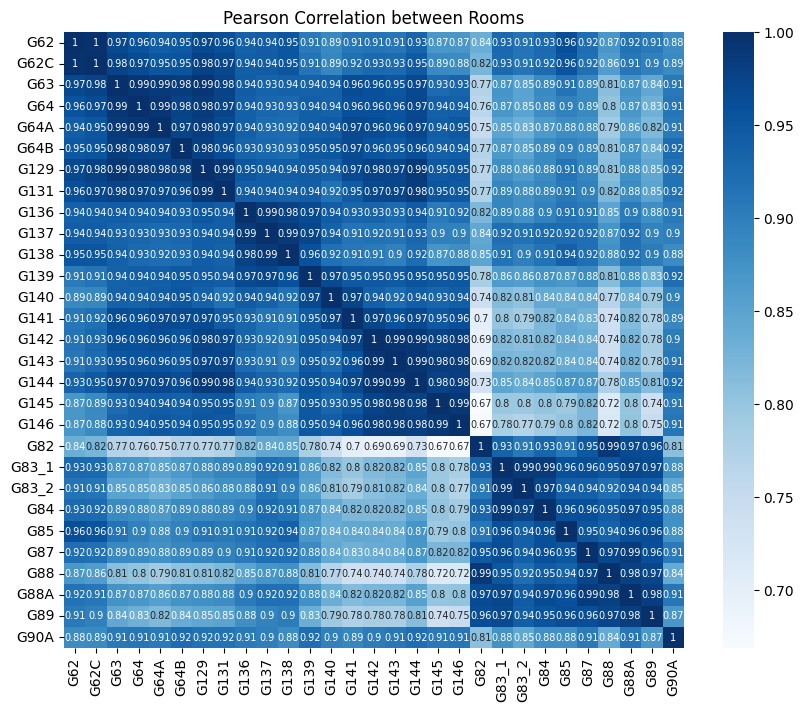

In [ ]:
pearson_results = pd.DataFrame(index=sheets, columns=sheets)  # 综合三个变量原始数据

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        temp_corr, _ = pearsonr(data[room1].iloc[:,0], data[room2].iloc[:,0])
        humid_corr, _ = pearsonr(data[room1].iloc[:,1], data[room2].iloc[:,1])
        absolute_humidity_corr, _ = pearsonr(data[room1].iloc[:,2], data[room2].iloc[:,2])
        pearson_results.loc[room1, room2] = (temp_corr + humid_corr + absolute_humidity_corr) / 3
        pearson_results.loc[room2, room1] = pearson_results.loc[room1, room2]

# 绘制热力图 T AH
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results.values), vmax=1)
plt.title('Pearson Correlation between Rooms')
plt.show()

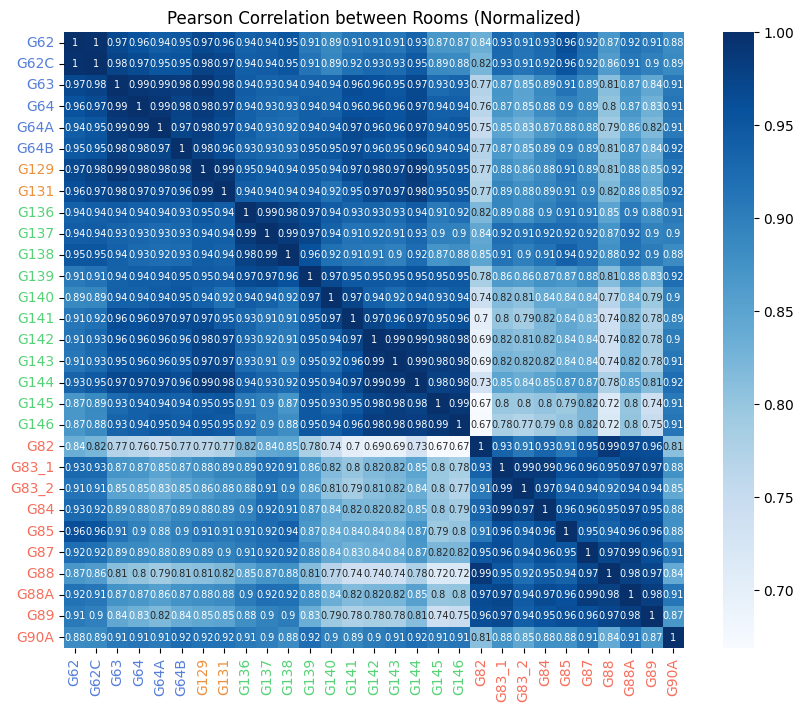

In [ ]:
pearson_results = pd.DataFrame(index=sheets, columns=sheets)  # 综合三个变量标准化数据  最终结果
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}
for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        temp_corr, _ = pearsonr(data[room1].iloc[:,6], data[room2].iloc[:,6])
        humid_corr, _ = pearsonr(data[room1].iloc[:,7], data[room2].iloc[:,7])
        absolute_humidity_corr, _ = pearsonr(data[room1].iloc[:,8], data[room2].iloc[:,8])
        pearson_results.loc[room1, room2] = (temp_corr + humid_corr+absolute_humidity_corr) / 3
        pearson_results.loc[room2, room1] = pearson_results.loc[room1, room2]

# 绘制热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results.values), vmax=1)


# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color

plt.title('Pearson Correlation between Rooms (Normalized)')
plt.show()

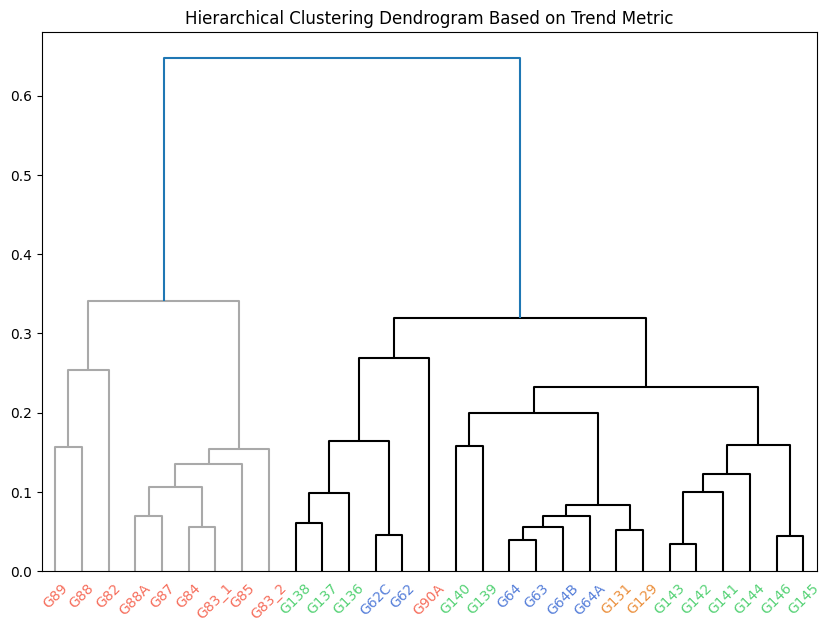

In [ ]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette

# 使用层次聚类进行聚类
linked = linkage(pearson_results, method='average')


# 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
set_link_color_palette(['#A9A9A9', '#000000'])  # 灰色系


# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendro = dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
                    show_leaf_counts=True, color_threshold=0.7*max(linked[:, 2]))
# 改变聚类标签颜色
ax = plt.gca()  # 获取当前的轴对象
x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

for label in x_labels:
    text = label.get_text()  # 获取标签文本
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # 蓝色
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # 橙色
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # 绿色
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # 红色
plt.title('Hierarchical Clustering Dendrogram Based on Trend Metric')
plt.show()

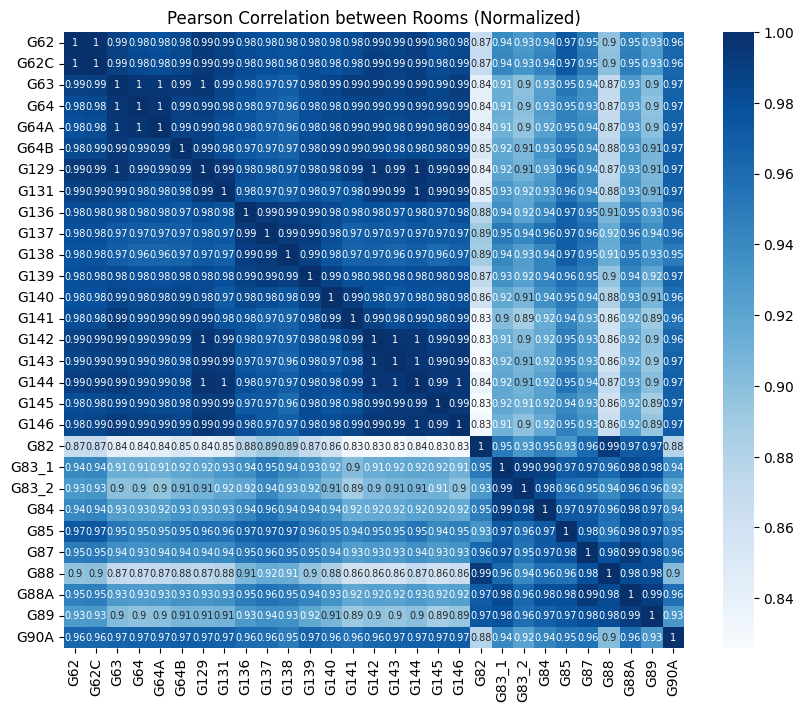

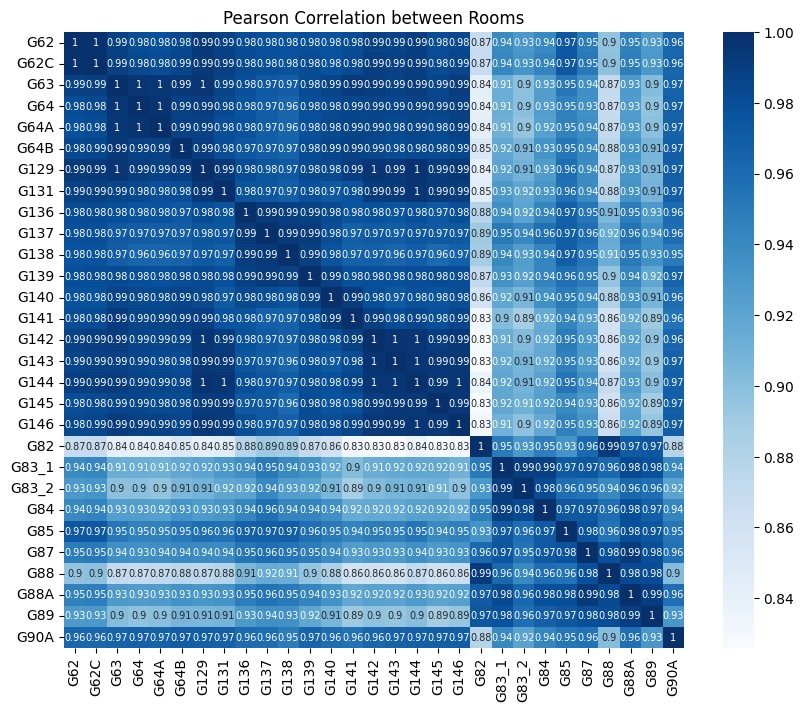

In [ ]:
# 计算每两个房间之间的温度和湿度的皮尔逊相关系数

# 计算每两个房间之间的温度和湿度的皮尔逊相关系数
pearson_results_nor = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        temp_corr, _ = pearsonr(data[room1]['Temperature'], data[room2]['Temperature'])
        humid_corr, _ = pearsonr(data[room1]['Humidity'], data[room2]['Humidity'])
        pearson_results_nor.loc[room1, room2] = (temp_corr + humid_corr) / 2
        pearson_results_nor.loc[room2, room1] = pearson_results_nor.loc[room1, room2]
# 绘制热力图 T AH
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results_nor.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results_nor.values), vmax=1)
plt.title('Pearson Correlation between Rooms (Normalized)')
plt.show()



pearson_results = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        temp_corr, _ = pearsonr(data[room1].iloc[:,0], data[room2].iloc[:,0])
        humid_corr, _ = pearsonr(data[room1].iloc[:,2], data[room2].iloc[:,2])
        pearson_results.loc[room1, room2] = (temp_corr + humid_corr) / 2
        pearson_results.loc[room2, room1] = pearson_results.loc[room1, room2]

# 绘制热力图 T AH
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results.values), vmax=1)
plt.title('Pearson Correlation between Rooms')
plt.show()

In [ ]:
correlation_coefficient

0.9999999999999998

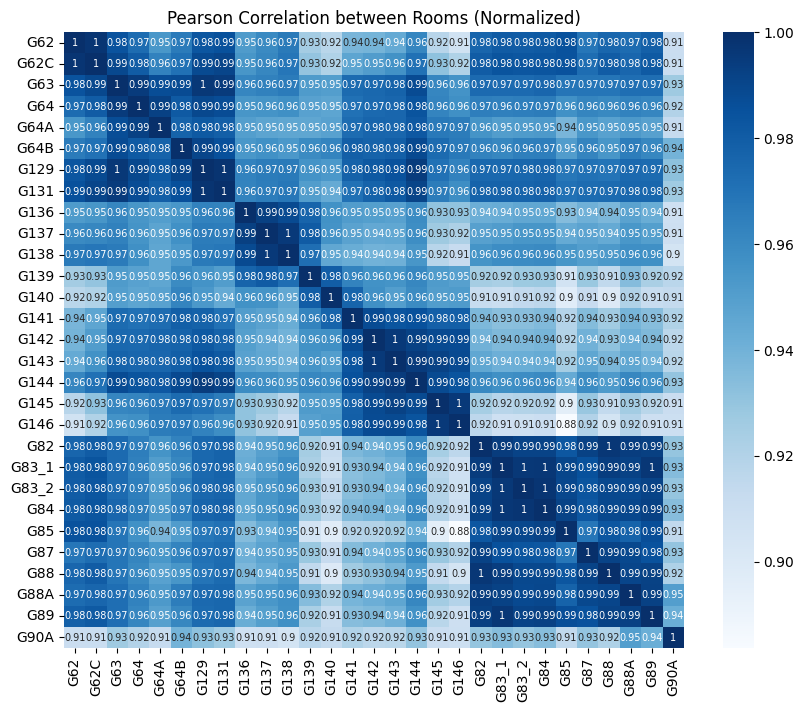

In [ ]:
# 计算每两个房间之间的温度和湿度的皮尔逊相关系数   对的综合方法
pearson_results_com = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        #temp_corr, _ = pearsonr(data[room1]['Temperature'], data[room2]['Temperature'])
        #humid_corr, _ = pearsonr(data[room1]['Humidity'], data[room2]['Humidity'])
        room1_composite = data[room1]['Temperature'] + data[room1]['Humidity']
        room2_composite = data[room2]['Temperature'] + data[room2]['Humidity']
        correlation_coefficient, p_value = pearsonr(room1_composite, room2_composite)
        pearson_results_com.loc[room1, room2] = correlation_coefficient
        pearson_results_com.loc[room2, room1] = pearson_results_com.loc[room1, room2]
# 绘制热力图 T AH
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results_com.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results_com.values), vmax=1)
plt.title('Pearson Correlation between Rooms (Normalized)')
plt.show()




In [ ]:
# 计算每两个房间之间的温度和湿度的皮尔逊相关系数   对的综合方法 测试使用统一标准化值
pearson_results_com = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        #temp_corr, _ = pearsonr(data[room1]['Temperature'], data[room2]['Temperature'])
        #humid_corr, _ = pearsonr(data[room1]['Humidity'], data[room2]['Humidity'])
        room1_composite = data_test[room1].iloc[:,5] + data[room1].iloc[:,6]
        room2_composite = data[room2].iloc[:,5] + data[room2].iloc[:,6]
        correlation_coefficient, p_value = pearsonr(room1_composite, room2_composite)
        pearson_results_com.loc[room1, room2] = correlation_coefficient
        pearson_results_com.loc[room2, room1] = pearson_results_com.loc[room1, room2]
# 绘制热力图 T AH
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results_com.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results_com.values), vmax=1)
plt.title('Pearson Correlation between Rooms (Unified standardization)')
plt.show()




NameError: name 'data_test' is not defined

In [ ]:
df

{'G62':                      SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH        AH  \
 Date                                                                    
 2023-01-01 00:00:00              19.60            53.300000  8.994077   
 2023-01-01 00:15:00              19.60            53.200000  8.977203   
 2023-01-01 00:30:00              19.60            53.150000  8.968766   
 2023-01-01 00:45:00              19.60            53.050000  8.951891   
 2023-01-01 01:00:00              19.60            52.933333  8.932205   
 ...                                ...                  ...       ...   
 2023-12-31 22:45:00              18.90            42.700000  6.914333   
 2023-12-31 23:00:00              18.90            42.666667  6.908936   
 2023-12-31 23:15:00              18.90            42.666667  6.908936   
 2023-12-31 23:30:00              18.90            42.700000  6.914333   
 2023-12-31 23:45:00              18.85            42.550000  6.869722   
 
                      Tempera

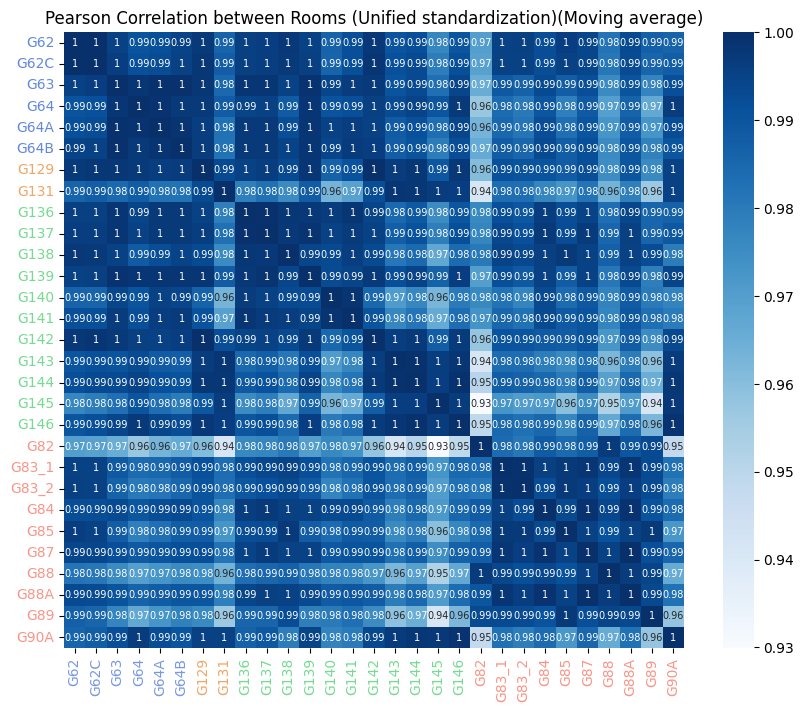

In [ ]:
def moving_average(series, window_size):
    return series.rolling(window=window_size).mean()

df =data
window_size = 8640

# 计算移动平均
for i in range(len(rooms)):
  df[rooms[i]]['ma_series1'] = moving_average(df[rooms[i]].iloc[:,0], window_size)




# 计算每两个房间之间的温度和湿度的皮尔逊相关系数   对的综合方法 测试使用统一标准化值
pearson_results_com = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        #temp_corr, _ = pearsonr(data[room1]['Temperature'], data[room2]['Temperature'])
        #humid_corr, _ = pearsonr(data[room1]['Humidity'], data[room2]['Humidity'])
        room1_composite = df[room1].iloc[:,5] + df[room1].iloc[:,6]
        room2_composite = df[room2].iloc[:,5] + df[room2].iloc[:,6]
        correlation_coefficient, p_value = pearsonr(df[room1].iloc[window_size-1:,7],df[room2].iloc[window_size-1:,7])
        pearson_results_com.loc[room1, room2] = correlation_coefficient
        pearson_results_com.loc[room2, room1] = pearson_results_com.loc[room1, room2]



# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}




# 使用 clustermap 绘制热力图，指定行和列的颜色
p=pearson_results.astype(float)
# 创建热力图
plt.figure(figsize=(10, 8))
ax = sns.heatmap(pearson_results_com.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results_com.values), vmax=1)
#ax = sns.clustermap(p, cmap="Blues", annot=True,annot_kws={"size": 7}, figsize=(10, 10),
 #                  row_colors=row_colors, col_colors=col_colors)


# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#7898e1')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#efa666')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#76da91')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#f89588')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#6288DC')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#efa666')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#76da91')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#f89588')  # Yellow color
# 绘制热力图 T AH
plt.title('Pearson Correlation between Rooms (Unified standardization)(Moving average)')
plt.show()

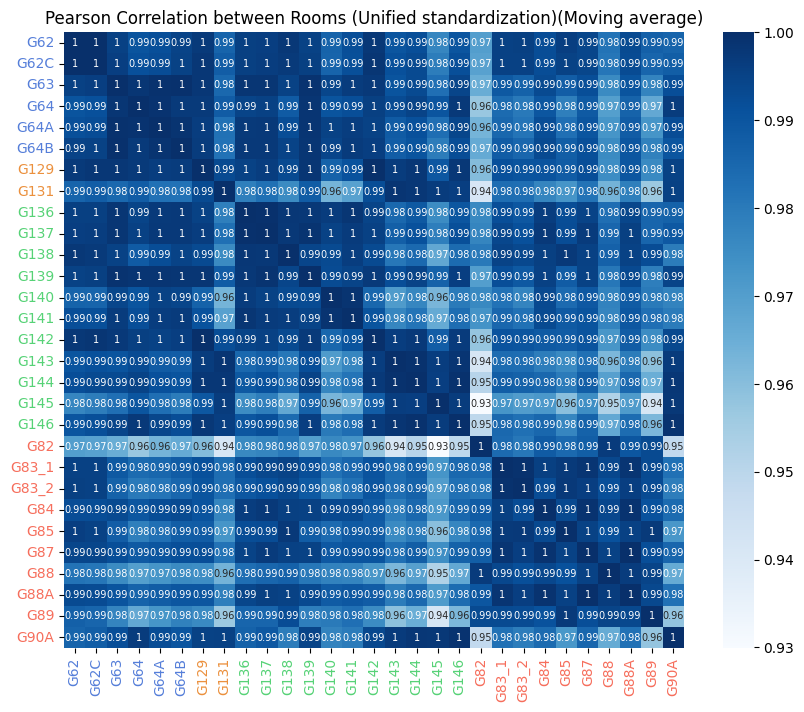

In [ ]:
# 使用 clustermap 绘制热力图，指定行和列的颜色  确定颜色
p=pearson_results.astype(float)
# 创建热力图
plt.figure(figsize=(10, 8))
ax = sns.heatmap(pearson_results_com.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results_com.values), vmax=1)
#ax = sns.clustermap(p, cmap="Blues", annot=True,annot_kws={"size": 7}, figsize=(10, 10),
 #                  row_colors=row_colors, col_colors=col_colors)


# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 绘制热力图 T AH
plt.title('Pearson Correlation between Rooms (Unified standardization)(Moving average)')
plt.show()

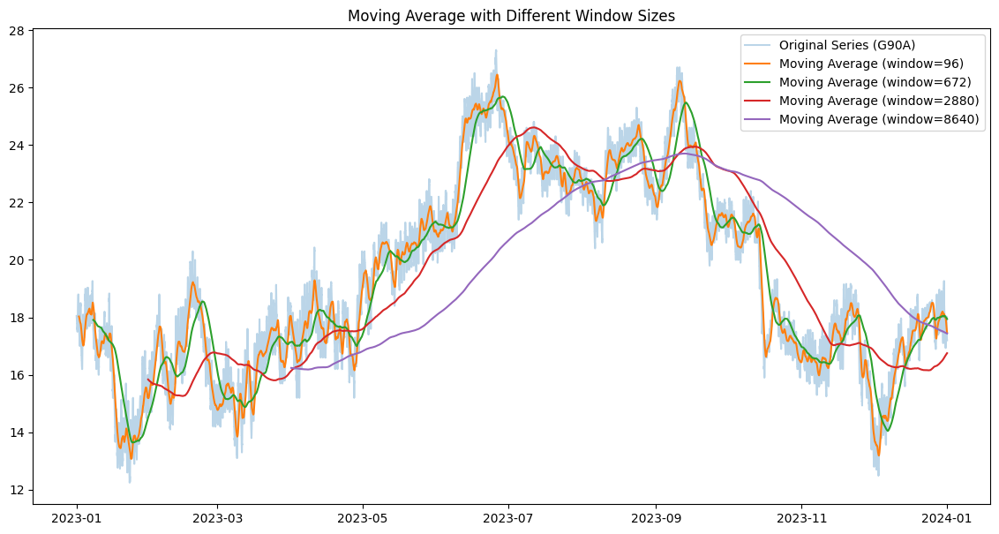

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt




# 不同的移动平均窗口大小
window_sizes = [96,672,2880,8640]  # 96=1天 672=1周 2880=1个月 8640=3个月

plt.figure(figsize=(14, 7))

# 原始数据
#for room in rooms:
plt.plot(df[room].index, df[room].iloc[:,0], label=f'Original Series ({room})', alpha=0.3)

# 计算并绘制不同窗口大小的移动平均
for window_size in window_sizes:
  #for room in rooms:
    df[room][f'ma_room1_{window_size}'] = df[room].iloc[:,0].rolling(window=window_size).mean()
    plt.plot(df[room].index, df[room][f'ma_room1_{window_size}'], label=f'Moving Average (window={window_size})')

plt.title('Moving Average with Different Window Sizes')
plt.legend()
plt.show()


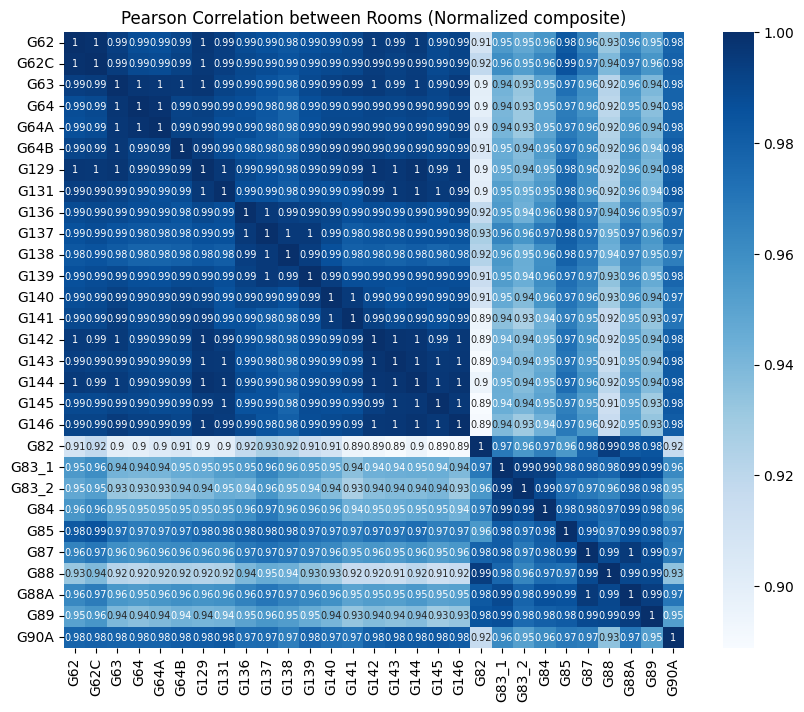

In [ ]:
# 计算每两个房间之间的温度和湿度的皮尔逊相关系数
pearson_results_com = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        #temp_corr, _ = pearsonr(data[room1]['Temperature'], data[room2]['Temperature'])
        #humid_corr, _ = pearsonr(data[room1]['Humidity'], data[room2]['Humidity'])
        room1_composite = data[room1]['Temperature'] + data[room1]['Humidity']
        room2_composite = data[room2]['Temperature'] + data[room2]['Humidity']
        correlation_coefficient, p_value = pearsonr(room1_composite, room2_composite)
        pearson_results_com.loc[room1, room2] = correlation_coefficient
        pearson_results_com.loc[room2, room1] = pearson_results_com.loc[room1, room2]
# 绘制热力图 T AH
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results_com.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues", vmin=np.min(pearson_results_com.values), vmax=1)
plt.title('Pearson Correlation between Rooms (Normalized composite)')
plt.show()




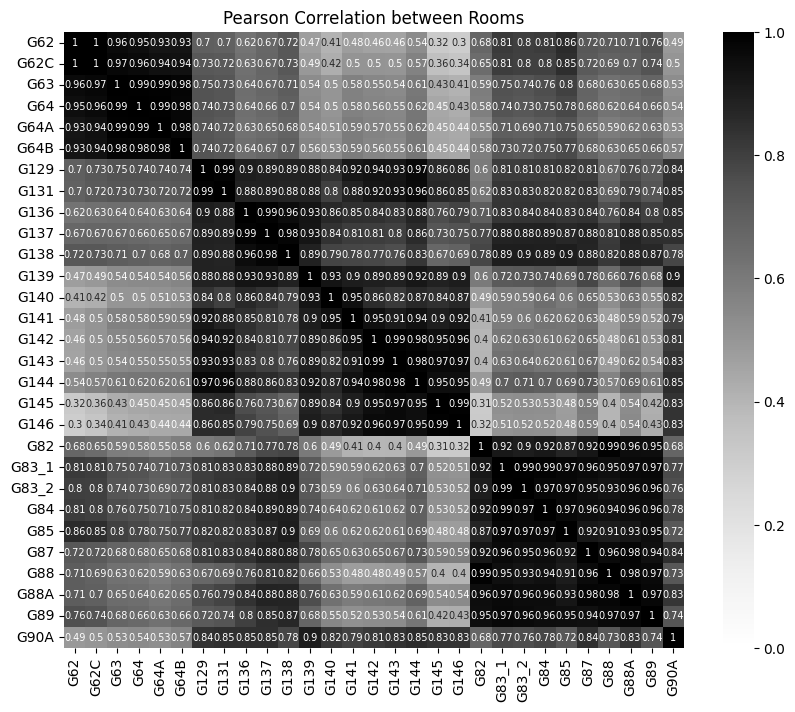

In [ ]:
# 绘制热力图
plt.figure(figsize=(10, 8))
#sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap='RdYlGn_r', center=0.5, vmin=0, vmax=1)
sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap='Greys', center=0.5, vmin=0, vmax=1)
plt.title('Pearson Correlation between Rooms')
plt.show()

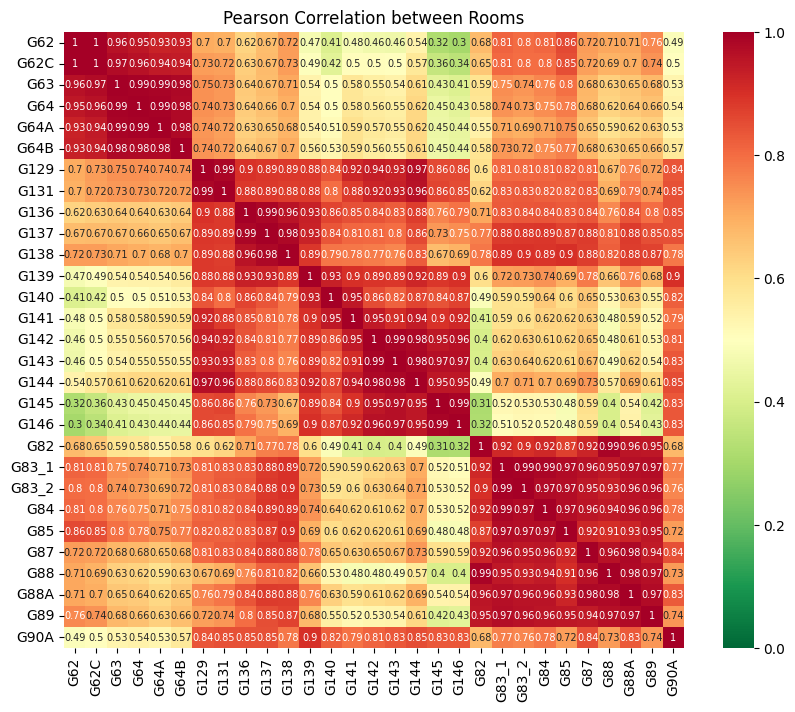

In [ ]:
# prompt:  请将pearson_results转变成热力图，颜色条中0.5为蓝色，1为红色，0为绿色
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt
# 创建一个颜色映射
colors = ["white", "yellow", "red", "red"]
n_bins = [3]
cmap_name = "custom_cmap"
custom_cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap='RdYlGn_r', center=0.5, vmin=0, vmax=1)
#sns.heatmap(pearson_results.astype(float), annot=True,annot_kws={"size": 7}, cmap='Greys', center=0.5, vmin=0, vmax=1)
plt.title('Pearson Correlation between Rooms')
plt.show()


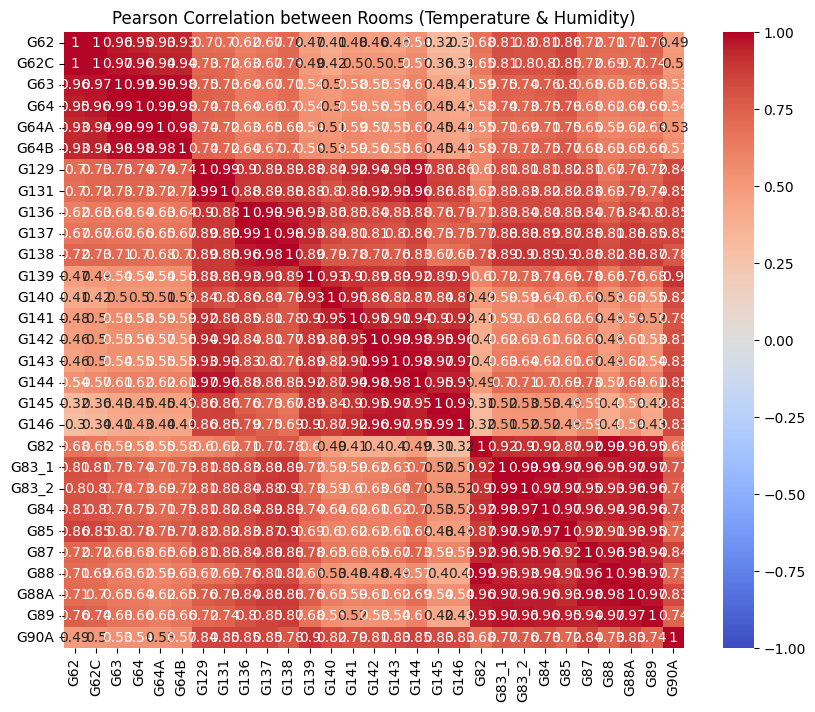

In [ ]:
# prompt: 请将pearson_results转变成热力图

import matplotlib.pyplot as plt
# 将皮尔逊相关系数矩阵转换为热力图
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_results.astype(float), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Pearson Correlation between Rooms (Temperature & Humidity)')
plt.show()


###Regression

In [ ]:
data_backup=data

In [ ]:
np.array(data[rooms[i]].iloc[:,0])

array([18.03072917, 17.57118056, 17.05451389, 17.96701389, 18.209375  ,
       18.12482639, 18.41493056, 17.3671875 , 16.69722222, 16.80399306,
       17.14227431, 17.42100694, 17.23142361, 17.44184028, 16.77743056,
       15.47673611, 14.14982639, 13.49479167, 13.77413194, 13.66423611,
       14.11119792, 13.56736111, 13.0859375 , 13.86631944, 13.70017361,
       13.88385417, 14.44357639, 14.95746528, 15.55416667, 15.19357639,
       15.61944444, 15.65711806, 16.36892361, 17.21684028, 17.66753472,
       16.93854167, 16.43142361, 16.02170139, 15.18211806, 15.21788194,
       15.27934028, 16.66614583, 17.15590278, 16.9859375 , 16.80607639,
       17.12951389, 18.11458333, 18.89479167, 19.16918403, 18.83315972,
       18.53854167, 18.40833333, 17.89409722, 17.15329861, 16.51458333,
       16.17378472, 15.46128472, 14.98888889, 14.79097222, 14.94427083,
       14.96302083, 15.28958333, 15.64409722, 15.58055556, 15.45052083,
       15.1734375 , 14.03697917, 14.49861111, 15.20243056, 14.51

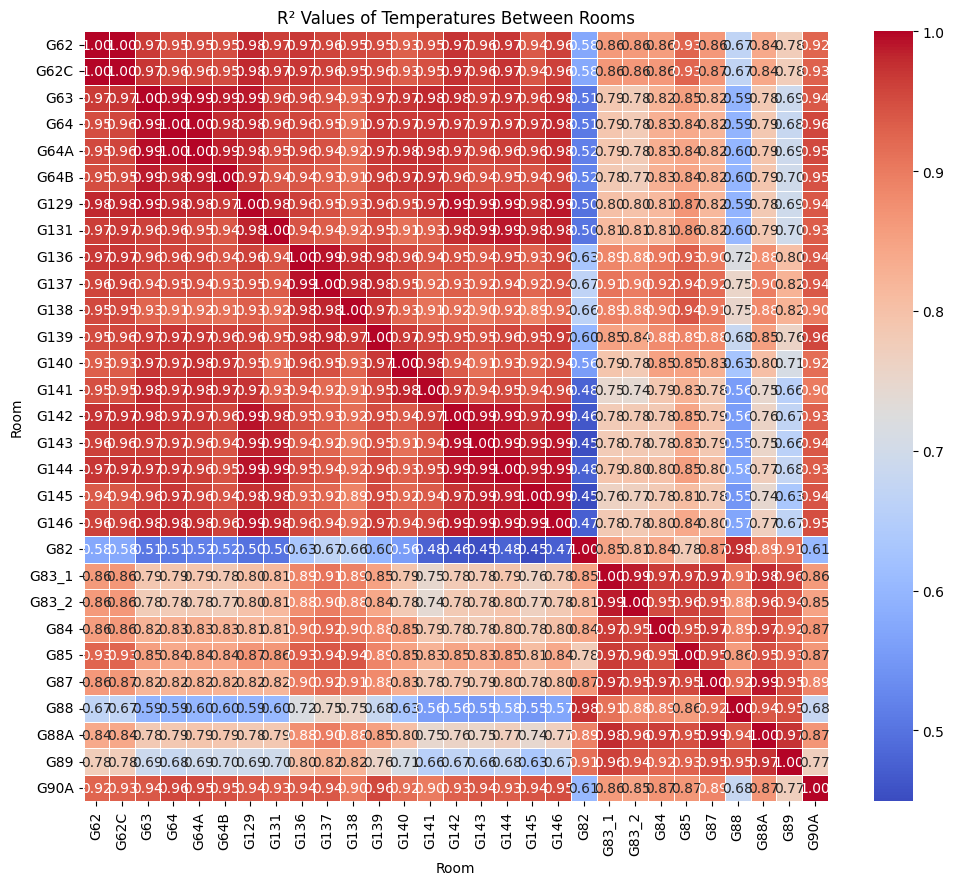

In [ ]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler


# 标准化数据（可选）
#scaler = StandardScaler()
#temperature_matrix = scaler.fit_transform(temperature_matrix)

# 初始化 R² 矩阵
r2_matrix = np.zeros((len(rooms), len(rooms)))

# 计算每对房间之间的 R² 值
for i in range(len(rooms)):
    for j in range(len(rooms)):

            X = np.array(data[rooms[i]].iloc[:,0]).reshape(-1, 1)
            y = np.array(data[rooms[j]].iloc[:,0])


            # 创建线性回归模型
            model = LinearRegression()
            model.fit(X, y)

            # 预测
            y_pred = model.predict(X)

            # 计算 R² 值
            r2 = r2_score(y, y_pred)

            # 更新 R² 矩阵
            r2_matrix[i, j] = r2
            r2_matrix[j, i] = r2  # 对称矩阵

# 将 R² 矩阵转换为 DataFrame
r2_df = pd.DataFrame(r2_matrix, index=rooms, columns=rooms)

# 绘制热力图
plt.figure(figsize=(12, 10))
sns.heatmap(r2_df, annot=True, cmap='coolwarm', fmt='.2f', linewidths=.5)
plt.title('R² Values of Temperatures Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()


##Shape, Trend and Pattern


###DTW

In [ ]:
data[room1].iloc[:, 0:3]

,SKA G90A Chan: 1 C,SKA G90A Chan: 2 %RH,G90A_AH
Date,,,
2023-01-01 00:00:00,18.05,59.100000,9.099818
2023-01-01 00:15:00,18.00,58.950000,9.049771
2023-01-01 00:30:00,18.00,58.966667,9.052329
2023-01-01 00:45:00,18.00,58.866667,9.036978
2023-01-01 01:00:00,18.00,58.800000,9.026743
...,...,...,...
2023-12-31 22:45:00,17.20,47.333333,6.927682
2023-12-31 23:00:00,17.20,47.500000,6.952075
2023-12-31 23:15:00,17.20,47.466667,6.947196


In [ ]:
# 应用DTW进行详细分析
dtw_results = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        temp_dtw, _ = fastdtw(data[room1].iloc[:, 0:3].values, data[room2].iloc[:, 0:3].values, dist=euclidean)
        #humid_dtw, _ = fastdtw(data[room1]['Humidity'].values, data[room2]['Humidity'].values, dist=euclidean)
        #dtw_results.loc[room1, room2] = (temp_dtw + humid_dtw) / 2
        #dtw_results.loc[room2, room1] = dtw_results.loc[room1, room2]
        dtw_results.loc[room1, room2] = temp_dtw
        dtw_results.loc[room2, room1] = dtw_results.loc[room1, room2]


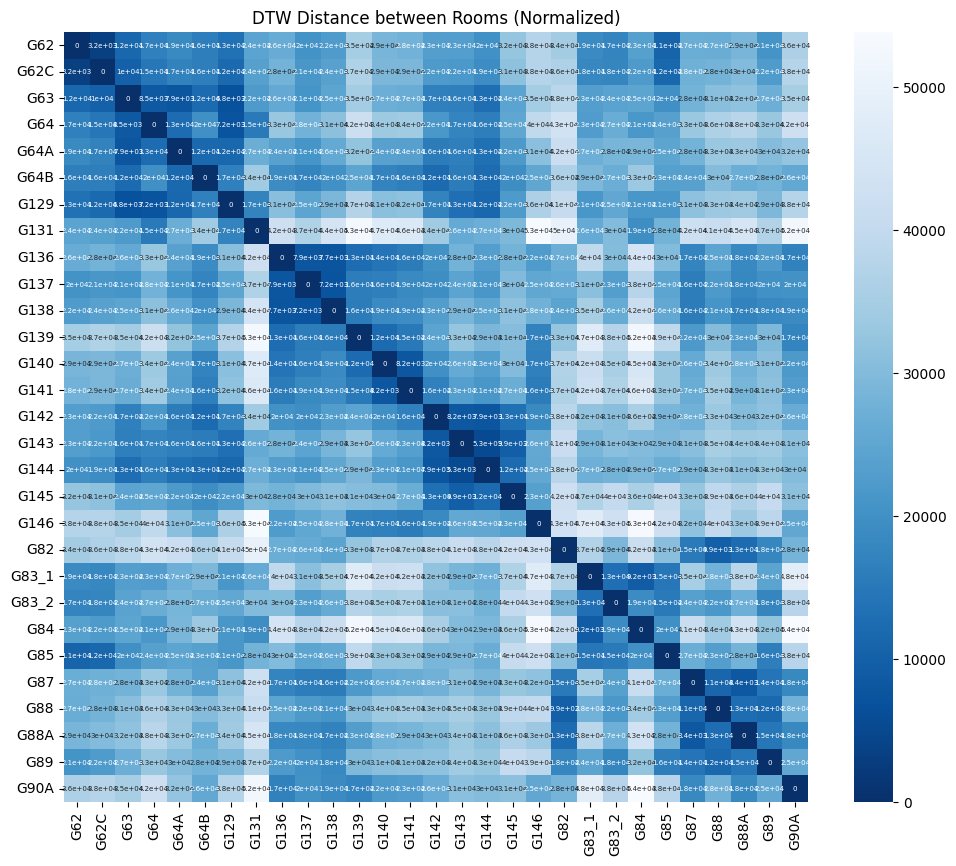

In [ ]:
# 应用DTW进行详细分析 标准化
dtw_results = pd.DataFrame(index=sheets, columns=sheets)

for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        temp_dtw, _ = fastdtw(data[room1].iloc[:, 6:9].values, data[room2].iloc[:, 6:9].values, dist=euclidean)
        #humid_dtw, _ = fastdtw(data[room1]['Humidity'].values, data[room2]['Humidity'].values, dist=euclidean)
        #dtw_results.loc[room1, room2] = (temp_dtw + humid_dtw) / 2
        #dtw_results.loc[room2, room1] = dtw_results.loc[room1, room2]
        dtw_results.loc[room1, room2] = temp_dtw
        dtw_results.loc[room2, room1] = dtw_results.loc[room1, room2]
# 热力图显示DTW距离矩阵
plt.figure(figsize=(12, 10))
sns.heatmap(dtw_results.astype(float), annot=True,annot_kws={"size": 5}, cmap='Blues_r')
plt.title('DTW Distance between Rooms (Normalized)')
plt.show()



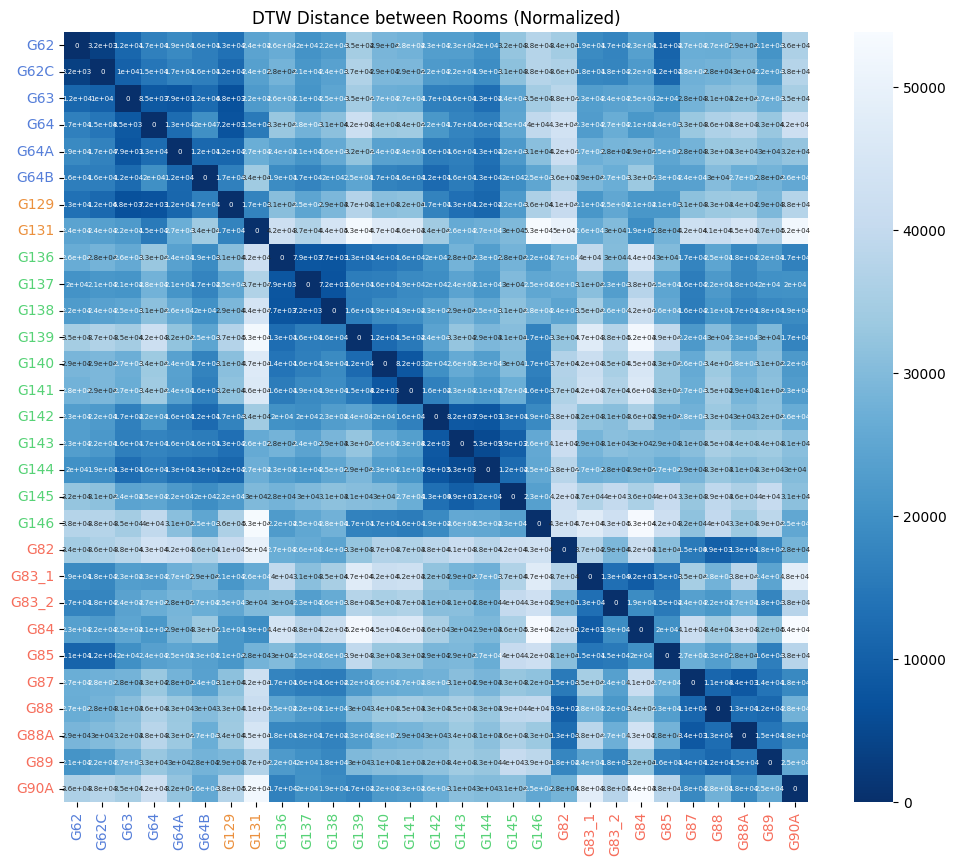

In [ ]:
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}
# 热力图显示DTW距离矩阵
plt.figure(figsize=(12, 10))
ax=sns.heatmap(dtw_results.astype(float), annot=True,annot_kws={"size": 5}, cmap='Blues_r')
# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('DTW Distance between Rooms (Normalized)')
plt.show()



In [ ]:
# 综合分析：选择皮尔逊相关系数高且DTW距离低的房间对
threshold = 0.8
similar_rooms = []
for i in range(len(sheets)):
    for j in range(i+1, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        if float(pearson_results.loc[room1, room2]) > threshold and float(dtw_results.loc[room1, room2]) < np.percentile(dtw_results.values.astype(float), 20):
            similar_rooms.append((room1, room2))

print("Similar rooms based on Pearson correlation and DTW distance:")
print(similar_rooms)

Similar rooms based on Pearson correlation and DTW distance:
[('G62', 'G62C'), ('G62', 'G63'), ('G62', 'G129'), ('G62C', 'G63'), ('G62C', 'G64'), ('G62C', 'G129'), ('G63', 'G64'), ('G63', 'G64A'), ('G63', 'G64B'), ('G63', 'G129'), ('G63', 'G131'), ('G63', 'G141'), ('G63', 'G144'), ('G64', 'G64A'), ('G64', 'G64B'), ('G64', 'G129'), ('G64', 'G131'), ('G64', 'G141'), ('G64', 'G144'), ('G64A', 'G64B'), ('G64A', 'G129'), ('G64A', 'G131'), ('G64A', 'G141'), ('G64A', 'G142'), ('G64A', 'G144'), ('G64B', 'G129'), ('G64B', 'G141'), ('G129', 'G131'), ('G129', 'G141'), ('G129', 'G142'), ('G129', 'G143'), ('G129', 'G144'), ('G131', 'G142'), ('G131', 'G143'), ('G131', 'G144'), ('G136', 'G137'), ('G136', 'G138'), ('G136', 'G139'), ('G137', 'G138'), ('G137', 'G139'), ('G139', 'G140'), ('G139', 'G144'), ('G140', 'G141'), ('G141', 'G142'), ('G141', 'G144'), ('G142', 'G143'), ('G142', 'G144'), ('G142', 'G145'), ('G142', 'G146'), ('G143', 'G144'), ('G143', 'G145'), ('G143', 'G146'), ('G144', 'G145'), ('G1

In [ ]:
dtw_results

,G62,G62C,G63,G64,G64A,G64B,G129,G131,G136,G137,...,G82,G83_1,G83_2,G84,G85,G87,G88,G88A,G89,G90A
G62,0.0,2462.79976,10096.654168,12248.454627,14083.518533,14183.475514,9974.428327,11945.895425,12563.566453,13000.509417,...,24684.405542,17526.580378,19764.198312,16452.532008,11121.187374,15844.116597,21677.908956,16876.990304,18247.75632,18154.173759
G62C,2462.79976,0.0,9151.943144,10789.195214,12786.722593,13631.884355,9057.836369,10837.45901,11950.514356,12982.468074,...,25339.84228,17867.721302,20177.804007,16730.078927,11878.908337,15765.385577,22222.218336,17398.157182,18896.27135,17963.330365
G63,10096.654168,9151.943144,0.0,4458.167341,4777.012158,6324.849415,4945.095588,9130.512128,11813.849755,13800.344928,...,28704.71981,23902.519489,26279.519224,22361.784993,19683.168951,19967.386527,27213.685795,21831.186031,24792.843295,15192.619669
G64,12248.454627,10789.195214,4458.167341,0.0,3869.080476,7770.140022,6086.479635,8827.619069,12466.935181,14022.099479,...,29350.834311,24114.128262,25965.606727,22494.949729,20150.400573,20252.273578,27226.423588,21818.059243,25546.360443,14133.318143
G64A,14083.518533,12786.722593,4777.012158,3869.080476,0.0,7046.647954,6689.655375,10068.197721,12247.634477,14947.224023,...,30471.883166,25577.279166,27965.450578,23933.99936,22610.479273,21231.066168,28702.581646,22994.466111,27043.98806,14764.951324
G64B,14183.475514,13631.884355,6324.849415,7770.140022,7046.647954,0.0,7574.302093,10999.82977,12860.146385,14510.183276,...,28812.375248,24489.71186,26432.421309,22765.508869,21402.140032,21070.93779,28084.678918,22244.646205,26242.519353,14250.823452
G129,9974.428327,9057.836369,4945.095588,6086.479635,6689.655375,7574.302093,0.0,5720.956965,10945.218176,12999.157171,...,27611.787352,23334.616088,25179.411178,22476.32321,18741.361375,19098.107369,25757.974237,20363.875795,24169.80341,14521.234271
G131,11945.895425,10837.45901,9130.512128,8827.619069,10068.197721,10999.82977,5720.956965,0.0,13219.792493,13286.172732,...,25682.935309,20172.374624,22087.48293,20095.370886,18609.177122,17334.503293,24297.724168,18208.403901,22302.990658,14513.877555
G136,12563.566453,11950.514356,11813.849755,12466.935181,12247.634477,12860.146385,10945.218176,13219.792493,0.0,5441.508445,...,25042.285704,21026.808115,21700.143958,18989.98113,15970.073184,16837.781944,23001.922855,17848.527354,20702.634743,14724.04078
G137,13000.509417,12982.468074,13800.344928,14022.099479,14947.224023,14510.183276,12999.157171,13286.172732,5441.508445,0.0,...,23262.520115,17246.971772,18280.904489,16224.508686,15919.667957,14438.608452,21137.360551,15406.846748,19366.554294,16359.847037


In [ ]:
np.percentile(dtw_results.values.astype(float), 20)

10812.22004145943

In [ ]:

x = np.array([[1,1], [2,2], [3,3], [4,4], [5,5]])
x.ndim

2

In [ ]:
import numpy as np
from scipy.spatial.distance import euclidean

from fastdtw import fastdtw

x = np.array([[1,1], [2,2], [3,3], [4,4], [5,5]])
y = np.array([[2,2], [3,3], [4,4]])
x=data[room1][['Temperature','Humidity']].values
y=data[room2][['Temperature','Humidity']].values
distance, path = fastdtw(x, y, dist=euclidean)
print(distance)

24032.230552017994


###SSI

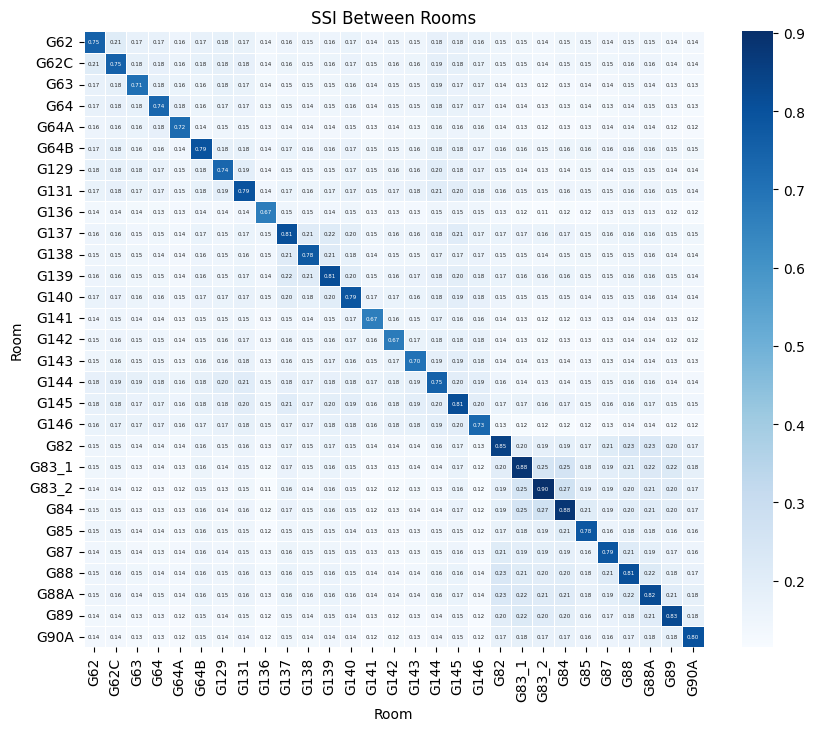

In [ ]:
import numpy as np

def compute_ssi(X, Y, epsilon=1e-10):
    if len(X) != len(Y):
        raise ValueError("The two time series must have the same length.")

    # 计算差分
    #delta_X = np.diff(X)
    #delta_Y = np.diff(Y)

    rate_X=np.diff(X) / X[:-1]
    rate_Y=np.diff(Y) / Y[:-1]

    # 计算相对变化率，避免除以零
    #rate_X = np.where(delta_X != 0, delta_X / X[:-1], epsilon)
    #rate_Y = np.where(delta_X != 0, delta_Y / Y[:-1], delta_Y / X[:-1])


    # 计算形状比率
    #ratio = np.divide(rate_Y, rate_X, out=np.zeros_like(rate_Y), where=(rate_X != 0))
    ratio = np.where((rate_X == 0) & (rate_Y == 0), 1, np.where((rate_X == 0) | (rate_Y == 0), 0, rate_Y / rate_X))

    # 计算形状相似性得分
    ssi_values = 1 - np.abs(ratio - 1)

    # 裁剪得分
    ssi_values = np.clip(ssi_values, 0, 1)

    # 计算平均SSI
    ssi = np.mean(ssi_values) if len(ssi_values) > 0 else 1  # 如果全为零，设为最相似

    return ssi


# 定义数据集目录   对的综合变量方法   综合三个变量原始数据
# 替换为实际的数据集目录路径



# 获取所有房间名称
rooms = list(data.keys())



# 初始化欧氏距离矩阵
ssi_matrix = pd.DataFrame(np.zeros((len(rooms), len(rooms))), index=rooms, columns=rooms)

# 计算欧氏距离
for i in range(len(rooms)):
    for j in range(i, len(rooms)):

            ssi_T = compute_ssi(data[rooms[i]].iloc[:,0],data[rooms[j]].iloc[:,0])
            ssi_RH = compute_ssi(data[rooms[i]].iloc[:,1],data[rooms[j]].iloc[:,1])
            ssi_AH = compute_ssi(data[rooms[i]].iloc[:,2],data[rooms[j]].iloc[:,2])
            ssi_matrix.iloc[i, j] = ( ssi_T+ ssi_RH+ ssi_AH)/3
            ssi_matrix.iloc[j, i] = ssi_matrix.iloc[i, j]  # 对称矩阵

# 绘制热力图
plt.figure(figsize=(10, 8))
sns.heatmap(ssi_matrix, annot=True,annot_kws={"size": 4}, cmap='Blues', fmt='.2f', linewidths=.5)
plt.title('SSI Between Rooms')
plt.xlabel('Room')
plt.ylabel('Room')
plt.show()





In [ ]:
compute_ssi(data[rooms[i]].iloc[:,0],data[rooms[i]].iloc[:,0])

0.47806729644110846

In [ ]:
delta_X=np.diff(X) / X[:-1]
delta_Y=np.diff(Y) / Y[:-1]
ratio=delta_Y / delta_X
#ssi=1 - np.abs(ratio - 1)
ratio

NameError: name 'X' is not defined

##基于趋势

###移动平均

In [ ]:
df['G62']

,SKA G62 Chan: 1 C,SKA G62 Chan: 2 %RH,AH,Temperature,Humidity,Normalized T,Normalized AH,ma_series1
Date,,,,,,,,
2023-01-01 00:00:00,19.60,53.300000,8.994077,-0.610507,0.206482,-0.303302,0.218319,NaN
2023-01-01 00:15:00,19.60,53.200000,8.977203,-0.610507,0.198681,-0.303302,0.210119,NaN
2023-01-01 00:30:00,19.60,53.150000,8.968766,-0.610507,0.194781,-0.303302,0.206019,NaN
2023-01-01 00:45:00,19.60,53.050000,8.951891,-0.610507,0.186981,-0.303302,0.197819,19.6000
2023-01-01 01:00:00,19.60,52.933333,8.932205,-0.610507,0.177880,-0.303302,0.188253,19.6000
...,...,...,...,...,...,...,...,...
2023-12-31 22:45:00,18.90,42.700000,6.914333,-0.859074,-0.754920,-0.489836,-0.792288,18.9250
2023-12-31 23:00:00,18.90,42.666667,6.908936,-0.859074,-0.757415,-0.489836,-0.794911,18.9000
2023-12-31 23:15:00,18.90,42.666667,6.908936,-0.859074,-0.757415,-0.489836,-0.794911,18.9000


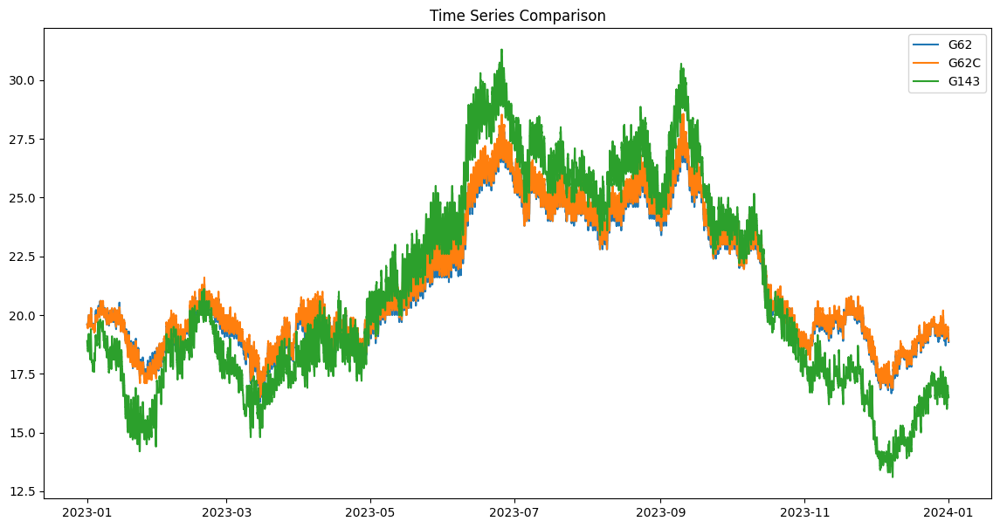

In [ ]:
# 绘制结果
plt.figure(figsize=(14, 7))
for i in [0,1,15]:
  plt.plot(df[rooms[i]].index, df[rooms[i]].iloc[:,0], label=rooms[i])
plt.title('Time Series Comparison')
plt.legend()
plt.show()

<ipython-input-153-76400b8687f4>:4: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, method='average')


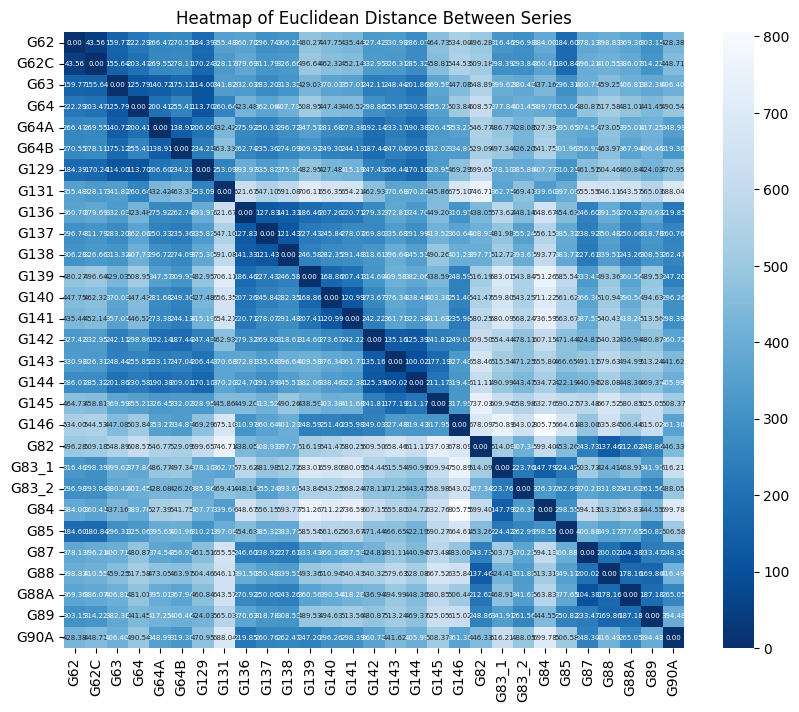

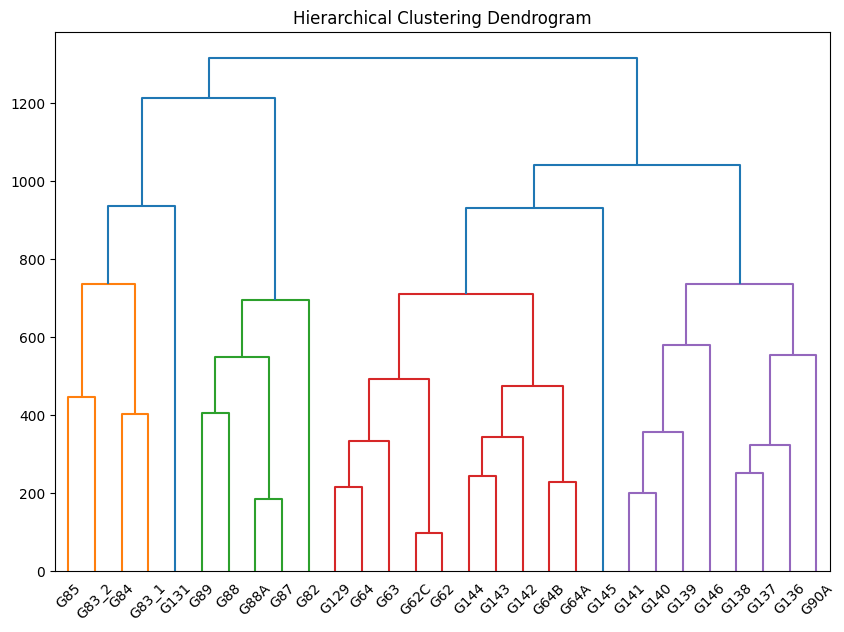

In [ ]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
# 使用层次聚类进行聚类
linked = linkage(distance_matrix, method='average')

# 绘制聚类热力图
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True,annot_kws={"size": 5}, fmt=".2f", cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)
plt.title('Heatmap of Euclidean Distance Between Series')
plt.show()

# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.show()

In [ ]:
data

{'G62':                      SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH        AH  \
 Date                                                                    
 2023-01-01 00:00:00              19.60            53.300000  8.994077   
 2023-01-01 00:15:00              19.60            53.200000  8.977203   
 2023-01-01 00:30:00              19.60            53.150000  8.968766   
 2023-01-01 00:45:00              19.60            53.050000  8.951891   
 2023-01-01 01:00:00              19.60            52.933333  8.932205   
 ...                                ...                  ...       ...   
 2023-12-31 22:45:00              18.90            42.700000  6.914333   
 2023-12-31 23:00:00              18.90            42.666667  6.908936   
 2023-12-31 23:15:00              18.90            42.666667  6.908936   
 2023-12-31 23:30:00              18.90            42.700000  6.914333   
 2023-12-31 23:45:00              18.85            42.550000  6.869722   
 
                      Tempera

In [ ]:
data=data_backup

In [ ]:
data['G62'].iloc[:672,:]
j=20000
data_1w={}
for i in range(len(rooms)):
  data_1w[rooms[i]]=data[rooms[i]].iloc[j:j+672,:]
data_1w

{'G62':                      SKA G62 Chan: 1 C  SKA G62 Chan: 2 %RH         AH  \
 Date                                                                     
 2023-07-28 08:00:00          24.300000            53.433333  11.824230   
 2023-07-28 08:15:00          24.300000            53.100000  11.750467   
 2023-07-28 08:30:00          24.300000            52.666667  11.654575   
 2023-07-28 08:45:00          24.300000            52.600000  11.639823   
 2023-07-28 09:00:00          24.300000            52.633333  11.647199   
 ...                                ...                  ...        ...   
 2023-08-04 06:45:00          23.600000            47.766667  10.158327   
 2023-08-04 07:00:00          23.600000            47.633333  10.129971   
 2023-08-04 07:15:00          23.600000            47.666667  10.137060   
 2023-08-04 07:30:00          23.600000            47.700000  10.144149   
 2023-08-04 07:45:00          23.666667            47.733333  10.189835   
 
                

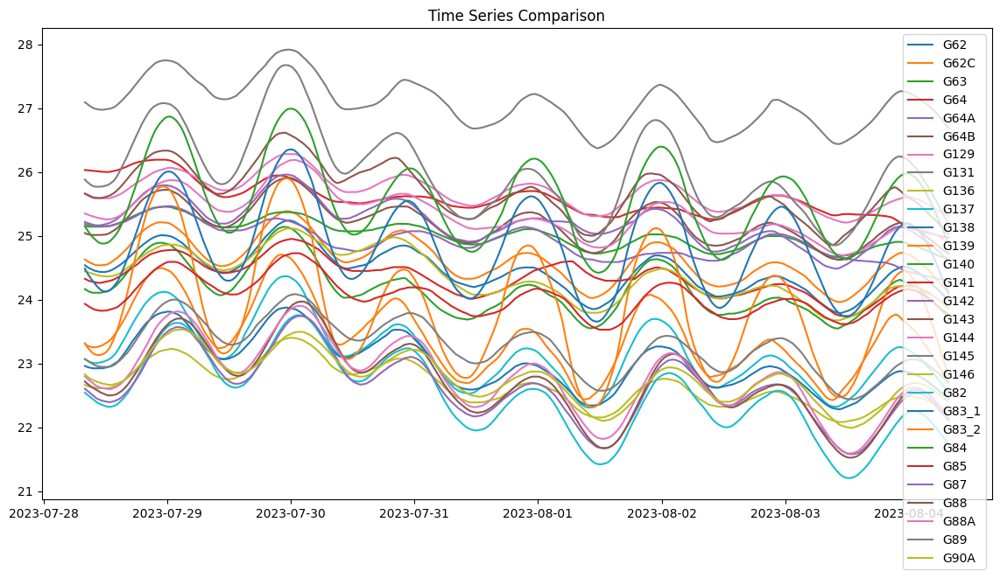

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def moving_average(series, window_size):
    return series.rolling(window=window_size).mean()

df =data
window_size = 4*12

# 计算移动平均
for i in range(len(rooms)):
  df[rooms[i]]['ma_series1'] = moving_average(df[rooms[i]].iloc[:,0], window_size)

j=20000
df_1w={}
for i in range(len(rooms)):
  df_1w[rooms[i]]=df[rooms[i]].iloc[j:j+672,:]
df_1w
# 绘制结果
plt.figure(figsize=(14, 7))
for i in range(len(rooms)):
  plt.plot(df_1w[rooms[i]].index, df_1w[rooms[i]].iloc[:,7], label=rooms[i])
plt.title('Time Series Comparison')
plt.legend()
plt.show()

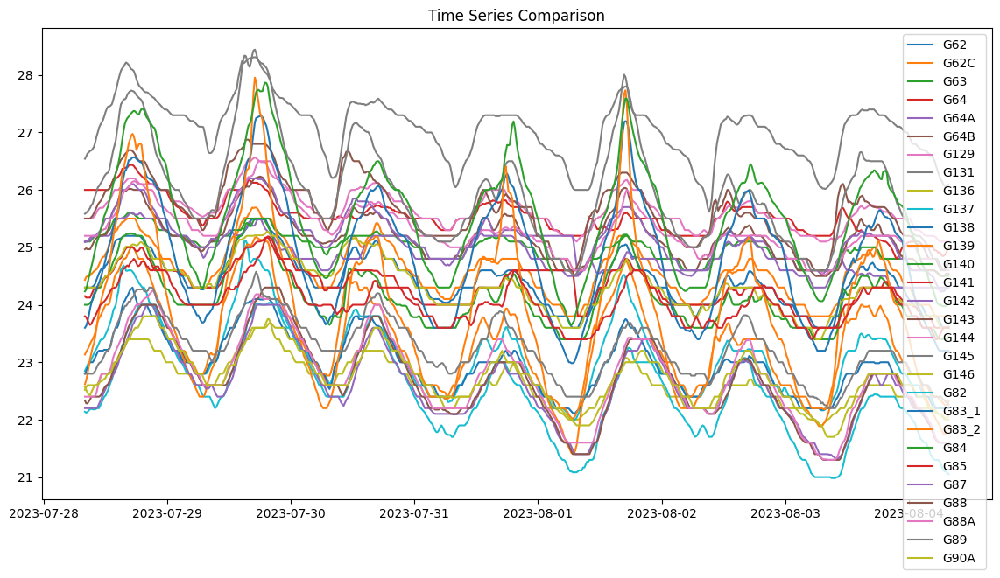

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def moving_average(series, window_size):
    return series.rolling(window=window_size).mean()

df =data
window_size = 4

# 计算移动平均
for i in range(len(rooms)):
  df[rooms[i]]['ma_series1'] = moving_average(df[rooms[i]].iloc[:,0], window_size)

j=20000
df_1w={}
for i in range(len(rooms)):
  df_1w[rooms[i]]=df[rooms[i]].iloc[j:j+672,:]
df_1w
# 绘制结果
plt.figure(figsize=(14, 7))
for i in range(len(rooms)):
  plt.plot(df_1w[rooms[i]].index, df_1w[rooms[i]].iloc[:,7], label=rooms[i])
plt.title('Time Series Comparison')
plt.legend()
plt.show()

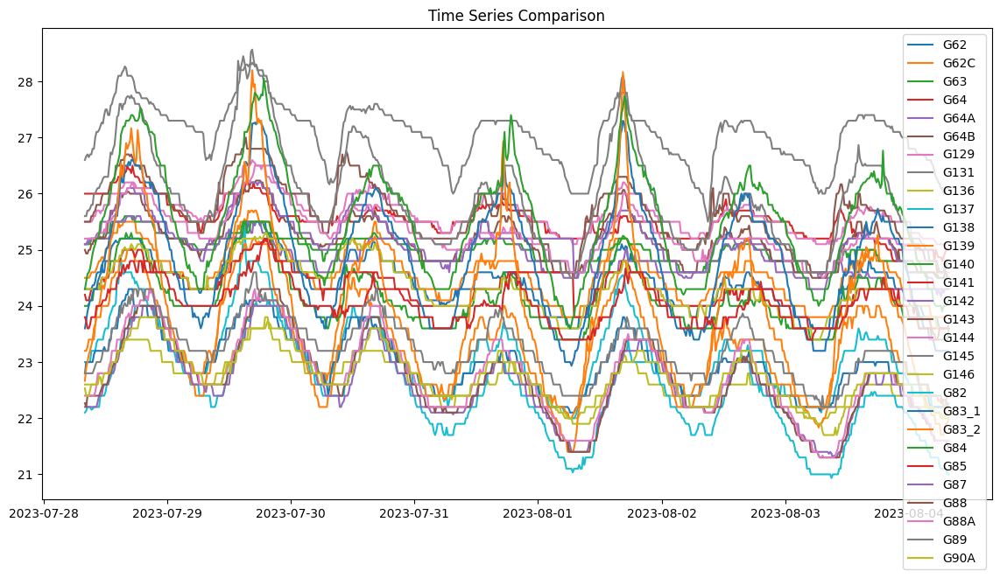

In [ ]:
# 绘制结果
plt.figure(figsize=(14, 7))
for i in range(len(rooms)):
  plt.plot(data_1w[rooms[i]].index, data_1w[rooms[i]].iloc[:,0], label=rooms[i])
plt.title('Time Series Comparison')
plt.legend()
plt.show()

In [ ]:
# prompt: 求df一天中每个房间温度最高的时刻

max_temp_times = {}
for room in rooms:
  max_temp_times[room] = df[room].iloc[j:j+96,0].idxmax()

print(max_temp_times)


{'G62': Timestamp('2023-07-28 15:00:00'), 'G62C': Timestamp('2023-07-28 14:30:00'), 'G63': Timestamp('2023-07-28 15:45:00'), 'G64': Timestamp('2023-07-28 15:15:00'), 'G64A': Timestamp('2023-07-28 16:15:00'), 'G64B': Timestamp('2023-07-28 16:15:00'), 'G129': Timestamp('2023-07-28 15:45:00'), 'G131': Timestamp('2023-07-28 15:45:00'), 'G136': Timestamp('2023-07-28 15:45:00'), 'G137': Timestamp('2023-07-28 15:00:00'), 'G138': Timestamp('2023-07-28 16:30:00'), 'G139': Timestamp('2023-07-28 17:00:00'), 'G140': Timestamp('2023-07-28 16:00:00'), 'G141': Timestamp('2023-07-28 15:30:00'), 'G142': Timestamp('2023-07-28 16:15:00'), 'G143': Timestamp('2023-07-28 16:00:00'), 'G144': Timestamp('2023-07-28 17:15:00'), 'G145': Timestamp('2023-07-28 17:00:00'), 'G146': Timestamp('2023-07-28 17:00:00'), 'G82': Timestamp('2023-07-28 17:45:00'), 'G83_1': Timestamp('2023-07-28 17:00:00'), 'G83_2': Timestamp('2023-07-28 17:00:00'), 'G84': Timestamp('2023-07-28 18:45:00'), 'G85': Timestamp('2023-07-28 16:45:0

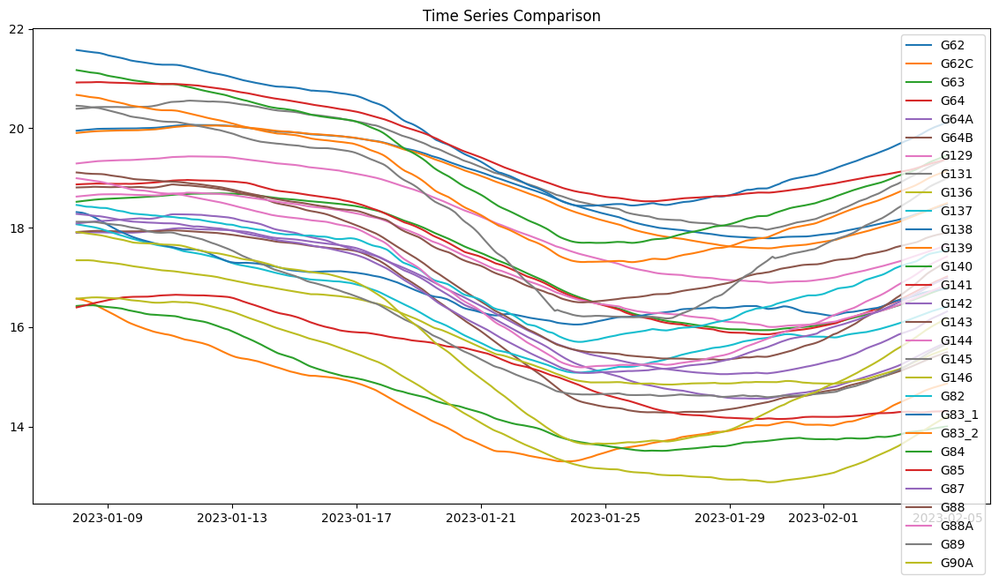

In [ ]:
j=window_size
plt.figure(figsize=(14, 7))
for i in range(len(rooms)):
  plt.plot(df[rooms[i]].iloc[j:j+96*7*4,7].index, df[rooms[i]].iloc[j:j+96*7*4,7], label=rooms[i])
plt.title('Time Series Comparison')
plt.legend()
plt.show()

In [ ]:
# prompt: 改变legend的位置至图表下方，并横向摆放

import matplotlib.pyplot as plt
# 绘制结果
plt.figure(figsize=(14, 7))
for i in range(len(rooms)):
  plt.plot(df[rooms[i]].iloc[j:j+96*7*4,7].index, df[rooms[i]].iloc[j:j+96*7*4,7], label=rooms[i])
plt.title('Time Series Comparison')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=len(rooms)) # 修改legend位置
plt.show()


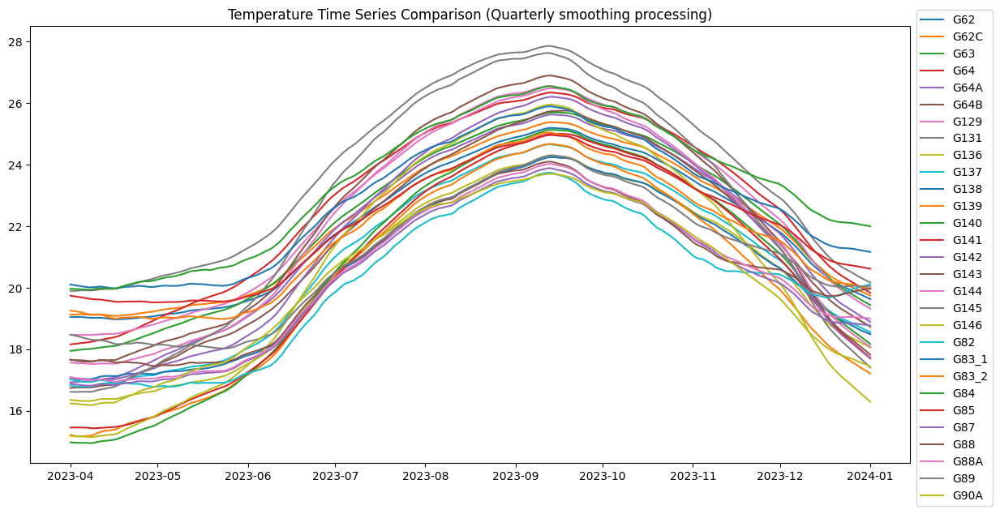

In [ ]:
plt.figure(figsize=(14, 7))
for i in range(len(rooms)):
  plt.plot(df[rooms[i]].iloc[window_size-1:,7].index, df[rooms[i]].iloc[window_size-1:,7], label=rooms[i])
plt.title('Temperature Time Series Comparison (Quarterly smoothing processing)')
plt.legend(loc='upper center', bbox_to_anchor=(1.05,1.05))
plt.show()

In [ ]:
daily_averages[rooms[i]].index

Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23],
      dtype='int32', name='Date')

In [ ]:
# prompt: 创建一个数据集daily，daily有四个大子集，每个大子集里有29个小子集，每个小子集里有7列数据，为他们赋值

import pandas as pd
import numpy as np
# 创建一个空字典来存储数据集
daily = {}

# 循环创建四个大子集
for subset in range(4):
  daily[f"subset_{subset+1}"] = {}

  # 循环创建29个小子集
  for room in range(29):
    daily[f"subset_{subset+1}"][f"room_{room+1}"] = pd.DataFrame(np.zeros((len(daily_averages[rooms[0]]), 7)))

# 为数据集赋值（这里只是一个示例，你需要根据你的实际数据进行赋值）
for subset in range(4):
  for room in range(29):
    daily[f"subset_{subset+1}"][f"room_{room+1}"].iloc[:, 0] = daily_averages[rooms[room]]  # 第一列赋值为每日平均温度
    # ... 为其他列赋值 ...

# 打印数据集结构
print(daily)


In [ ]:
daily_averages[f"subset_{subset+1}"][rooms[i]]

,SKA G62 Chan: 1 C
Date,
0,18.942754
1,18.891440
2,18.850974
3,18.798868
4,18.757201
5,18.715217
6,18.682349
7,18.741209
8,18.781822


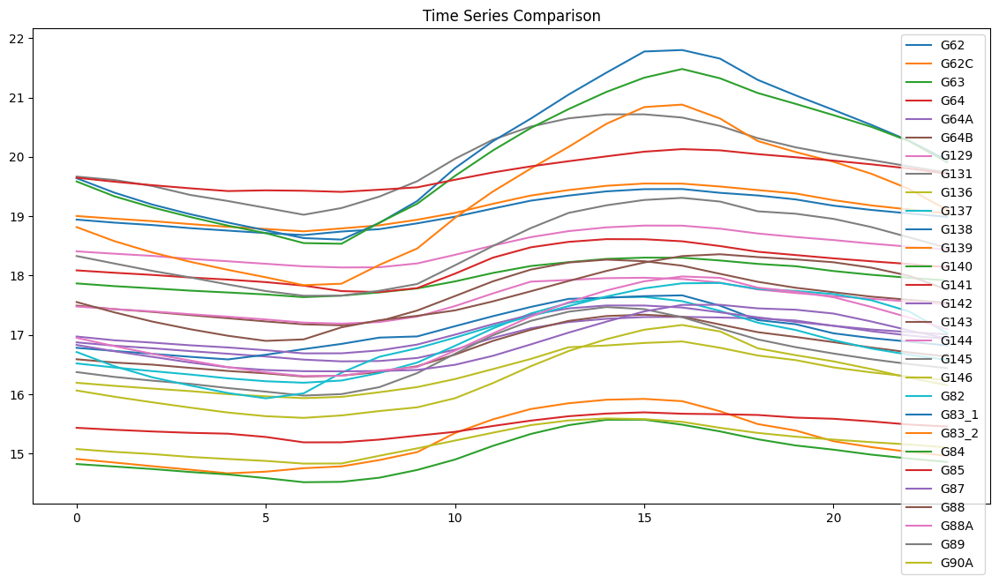

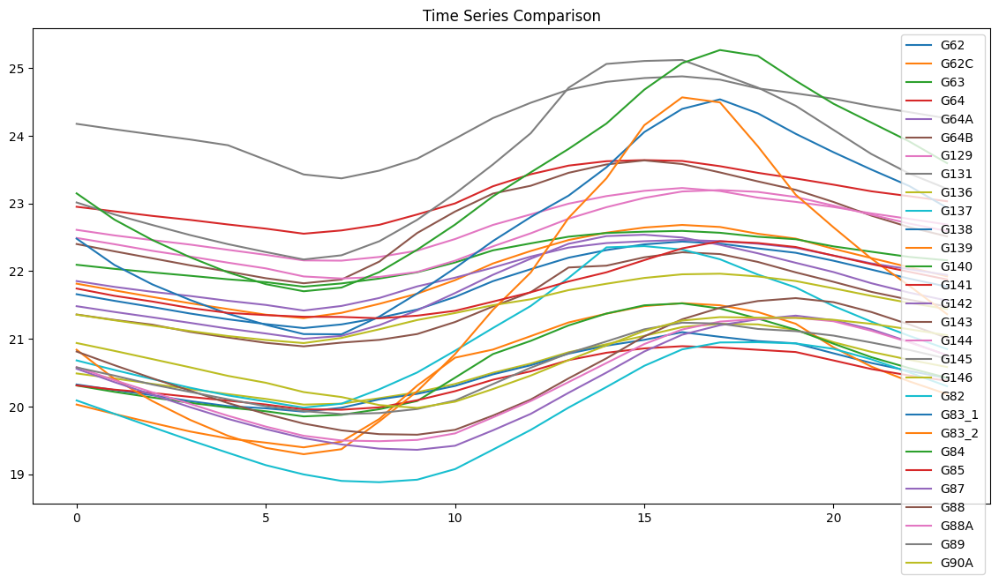

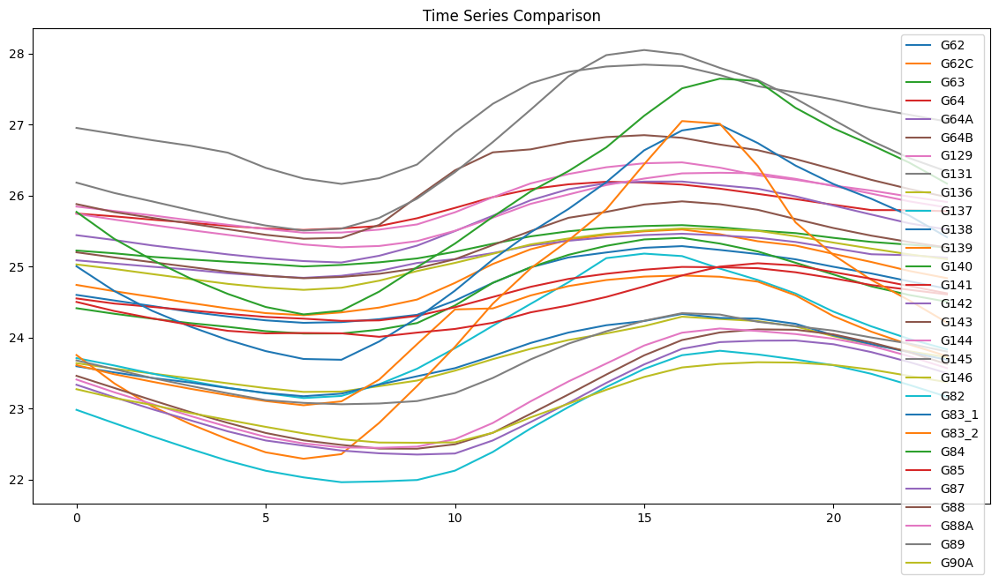

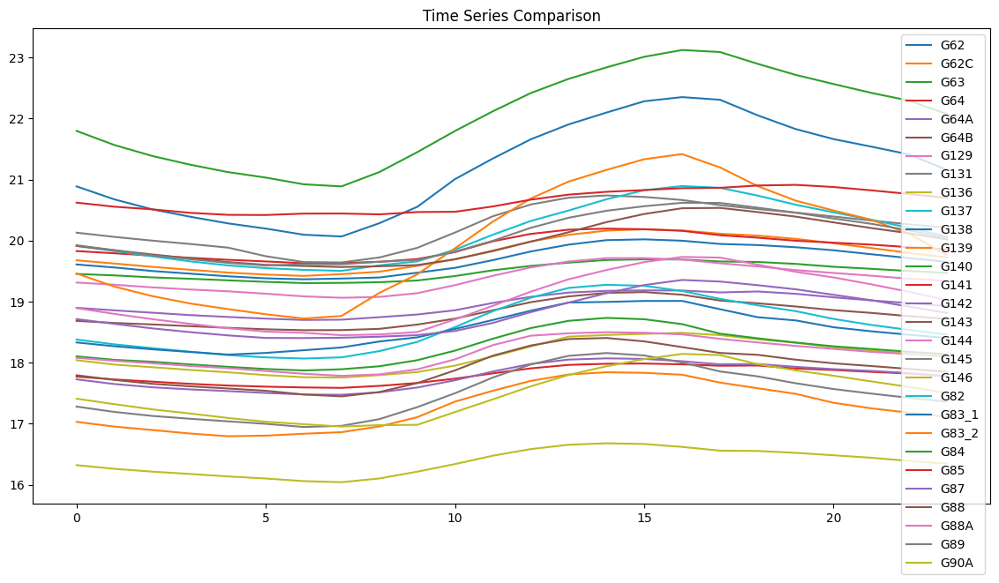

{'subset_1': {'G62': Date
  0     18.942754
  1     18.891440
  2     18.850974
  3     18.798868
  4     18.757201
  5     18.715217
  6     18.682349
  7     18.741209
  8     18.781822
  9     18.879602
  10    18.991392
  11    19.128594
  12    19.261653
  13    19.347344
  14    19.418315
  15    19.455357
  16    19.457669
  17    19.393773
  18    19.349130
  19    19.282395
  20    19.177427
  21    19.105540
  22    19.046108
  23    18.989217
  Name: SKA G62 Chan: 1 C, dtype: float64,
  'G62C': Date
  0     19.003170
  1     18.957835
  2     18.917120
  3     18.867074
  4     18.821241
  5     18.785145
  6     18.745055
  7     18.793727
  8     18.846429
  9     18.940156
  10    19.056181
  11    19.208539
  12    19.347985
  13    19.440659
  14    19.512225
  15    19.550412
  16    19.548535
  17    19.500229
  18    19.440018
  19    19.382967
  20    19.269963
  21    19.181456
  22    19.112729
  23    19.047482
  Name: SKA G62C Chan: 1 C, dtype: float64,
  'G63':

In [ ]:
# prompt: 求data每个数据集的温度数据每天同一时刻的全年平均值

import pandas as pd
# 创建一个字典来存储结果
daily_averages = {}
# 循环创建四个大子集
for subset in range(4):
  daily_averages[f"subset_{subset+1}"] = {}
s=8760
# 遍历每个房间
for a in range(0,4):
  for room in rooms:
    # 提取温度数据
    temp_data = data[room].iloc[s*a:s*(a+1),0]

    # 重新索引数据，以日期时间为索引
    temp_data.index = pd.to_datetime(temp_data.index)

    # 按小时分组并计算平均值
    daily_averages[f"subset_{a+1}"][room] = temp_data.groupby(temp_data.index.hour).mean()


for subset in range(4):
  plt.figure(figsize=(14, 7))
  for i in range(len(rooms)):
    plt.plot(daily_averages[f"subset_{subset+1}"][rooms[i]].index, daily_averages[f"subset_{subset+1}"][rooms[i]], label=rooms[i])
  plt.title('Time Series Comparison')
  plt.legend()
  plt.show()
daily_averages


##基于统计

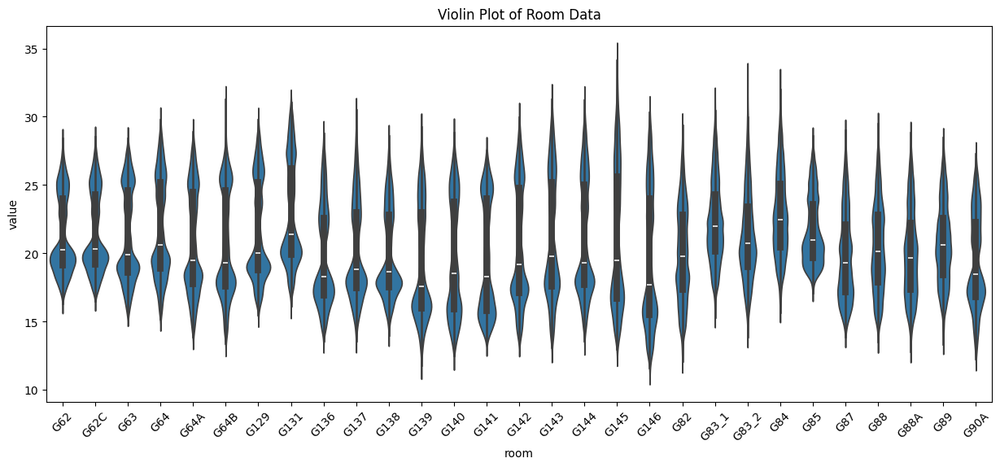

In [ ]:

import pandas as pd
rooms = list(data.keys())
# 创建一个空的数据框
data_list = []


for i in range(len(rooms)):
    room_data = data[rooms[i]].iloc[:, 0]  # 获取每个房间的第一列数据
    room_df = pd.DataFrame({
        'room': rooms[i],
        'value': room_data
    })
    data_list.append(room_df)

# 合并所有数据
combined_df = pd.concat(data_list, ignore_index=True)
import seaborn as sns
import matplotlib.pyplot as plt

# 创建一个小提琴图
plt.figure(figsize=(15, 6))
sns.violinplot(x='room', y='value', data=combined_df)
plt.xticks(rotation=45)  # 旋转x轴标签以便更好地显示
plt.title('Violin Plot of Room Data')
plt.show()


###T检验和方差分析

In [ ]:
# 温度
import numpy as np
from scipy import stats
from scipy.stats import wasserstein_distance
from scipy.stats import mannwhitneyu

# 初始化 CS 矩阵
t_matrix = pd.DataFrame(index=sheets, columns=sheets)
tt_matrix = pd.DataFrame(index=sheets, columns=sheets)
F_matrix = pd.DataFrame(index=sheets, columns=sheets)
Ft_matrix = pd.DataFrame(index=sheets, columns=sheets)
emd_matrix = pd.DataFrame(index=sheets, columns=sheets)
kru_matrix = pd.DataFrame(index=sheets, columns=sheets)
u_matrix = pd.DataFrame(index=sheets, columns=sheets)
# 遍历每个房间对
for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        data1 = data[room1].iloc[:,0]
        data2 = data[room2].iloc[:,0]
        data3 = data[room1].iloc[:,1]
        data4 = data[room2].iloc[:,1]
        data5 = data[room1].iloc[:,2]
        data6 = data[room2].iloc[:,2]

        # 执行独立样本 t 检验
        t_statistic_T, p_value_T = stats.ttest_ind(data1, data2, equal_var=True)
        t_statistic_RH, p_value_RH = stats.ttest_ind(data3, data4, equal_var=True)
        t_statistic_AH, p_value_AH = stats.ttest_ind(data5, data6, equal_var=True)
        #t_statistic= (t_statistic_T+t_statistic_RH+t_statistic_AH)/3
        t_statistic= t_statistic_RH
        p_value= (p_value_T+p_value_RH+p_value_AH)/3


        # 输出结果
        #print(f"T-statistic: {t_statistic}")
        #print(f"P-value: {p_value}")

        # 解释结果
        #alpha = 0.05
       # if p_value < alpha:
            #print("结果显著：两个房间的温度均值存在显著差异。")
            #t_matrix.loc[room1,room2]=1 #显著不同
           # t_matrix.loc[room2,room1]=1 #显著不同
        #else:
            #print("结果不显著：两个房间的温度均值没有显著差异。")
         #   t_matrix.loc[room1,room2]=0 #非常相似
          #  t_matrix.loc[room2,room1]=0 #非常相似
        tt_matrix.loc[room1,room2]=t_statistic
        tt_matrix.loc[room2,room1]=tt_matrix.loc[room1,room2]

        # 进行方差分析
        #f_value, p_value = stats.f_oneway(data1,data2)

        # 进行F检验
        f_stat_T, p_value_T = stats.levene(data1, data2, center='mean')
        f_stat_RH, p_value_RH = stats.levene(data3, data4, center='mean')
        f_stat_AH, p_value_AH = stats.levene(data5, data6, center='mean')
        #f_stat=(f_stat_T+f_stat_RH+f_stat_AH)/3
        f_stat=f_stat_RH
        p_value=(p_value_T+p_value_RH+p_value_AH)/3


        #print(f'F-Statistic: {f_value}')
        #print(f'P-Value: {p_value}')

        #if p_value < 0.05:
            #print("结果显著：两个房间的温度方差存在显著差异。")
         #   F_matrix.loc[room1,room2]=1 #显著不同

        #else:
            #print("结果不显著：两个房间的温度方差没有显著差异。")
         #   F_matrix.loc[room1,room2]=0 #非常相似
        #F_matrix.loc[room2,room1]=F_matrix.loc[room1,room2]


        Ft_matrix.loc[room1,room2]=f_stat
        Ft_matrix.loc[room2,room1]=Ft_matrix.loc[room1,room2]



        kruskal_stat_T, p_value_T = stats.kruskal(data1, data2)
        kruskal_stat_RH, p_value_RH = stats.kruskal(data3, data4)
        kruskal_stat_AH, p_value_AH = stats.kruskal(data5, data6)
        kruskal_stat=(kruskal_stat_T+kruskal_stat_RH+kruskal_stat_AH)/3
        #kruskal_stat=kruskal_stat_RH
        kru_matrix.loc[room1,room2]=kruskal_stat
        kru_matrix.loc[room2,room1]=kru_matrix.loc[room1,room2]

        u_statistic_T, p_value_T = mannwhitneyu(data1, data2)
        u_statistic_RH, p_value_RH = mannwhitneyu(data3, data4)
        u_statistic_AH, p_value_AH = mannwhitneyu(data5, data6)
        u_statistic=(u_statistic_T+u_statistic_RH+u_statistic_AH)/3
        #u_statistic=u_statistic_RH
        u_matrix.loc[room1,room2]=u_statistic
        u_matrix.loc[room2,room1]=u_matrix.loc[room1,room2]

        #
        emd_distance_T = wasserstein_distance(data1, data2)
        emd_distance_RH = wasserstein_distance(data3, data4)
        emd_distance_AH = wasserstein_distance(data5, data6)
        #emd_distance=(emd_distance_T+emd_distance_RH+emd_distance_AH)/3
        emd_distance=emd_distance_T


        emd_matrix.loc[room1,room2]=emd_distance
        emd_matrix.loc[room2,room1]=emd_distance

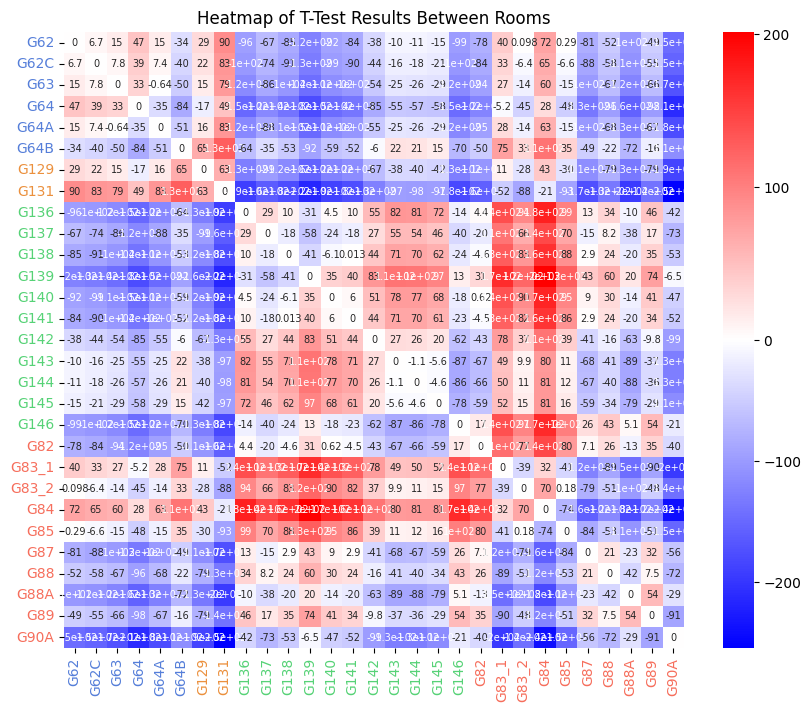

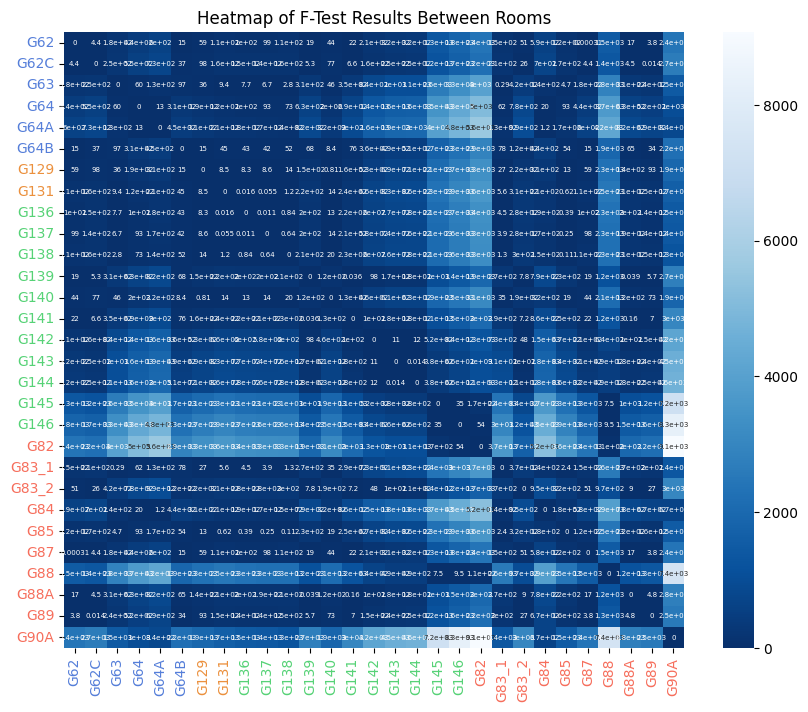

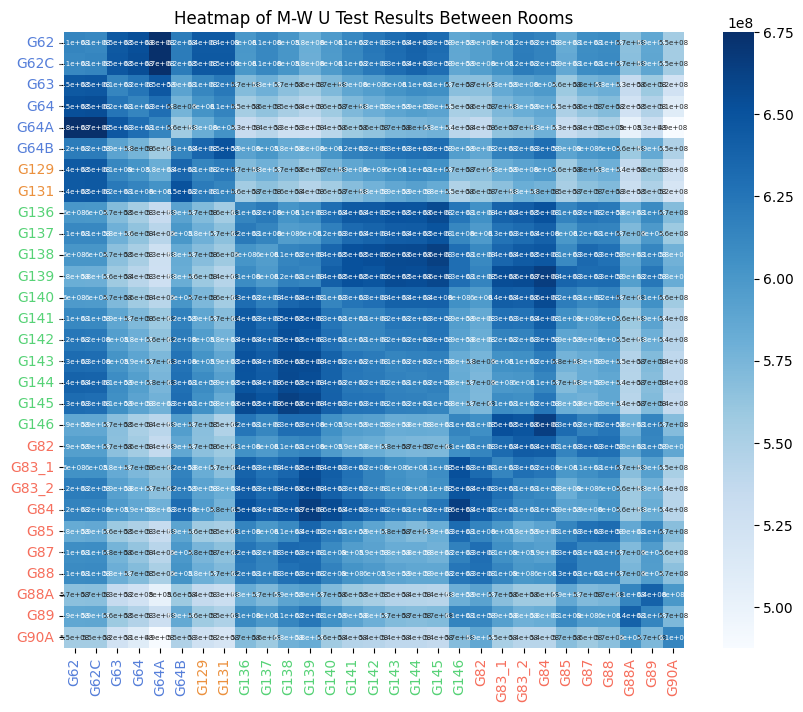

In [ ]:
from matplotlib.colors import LinearSegmentedColormap, TwoSlopeNorm
# 温度
import numpy as np
from scipy import stats
from scipy.stats import wasserstein_distance
from scipy.stats import mannwhitneyu

# 初始化 CS 矩阵
t_matrix = pd.DataFrame(index=sheets, columns=sheets)
tt_matrix = pd.DataFrame(index=sheets, columns=sheets)
F_matrix = pd.DataFrame(index=sheets, columns=sheets)
Ft_matrix = pd.DataFrame(index=sheets, columns=sheets)
emd_matrix = pd.DataFrame(index=sheets, columns=sheets)
kru_matrix = pd.DataFrame(index=sheets, columns=sheets)
u_matrix = pd.DataFrame(index=sheets, columns=sheets)
# 遍历每个房间对
for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        data1 = data[room1].iloc[:,0]
        data2 = data[room2].iloc[:,0]
        data3 = data[room1].iloc[:,1]
        data4 = data[room2].iloc[:,1]
        data5 = data[room1].iloc[:,2]
        data6 = data[room2].iloc[:,2]

        # 执行独立样本 t 检验
        t_statistic_T, p_value_T = stats.ttest_ind(data1, data2, equal_var=True)
        t_statistic_RH, p_value_RH = stats.ttest_ind(data3, data4, equal_var=True)
        t_statistic_AH, p_value_AH = stats.ttest_ind(data5, data6, equal_var=True)
        #t_statistic= (t_statistic_T+t_statistic_RH+t_statistic_AH)/3
        t_statistic= t_statistic_RH
        p_value= (p_value_T+p_value_RH+p_value_AH)/3


        # 输出结果
        #print(f"T-statistic: {t_statistic}")
        #print(f"P-value: {p_value}")

        # 解释结果
        #alpha = 0.05
       # if p_value < alpha:
            #print("结果显著：两个房间的温度均值存在显著差异。")
            #t_matrix.loc[room1,room2]=1 #显著不同
           # t_matrix.loc[room2,room1]=1 #显著不同
        #else:
            #print("结果不显著：两个房间的温度均值没有显著差异。")
         #   t_matrix.loc[room1,room2]=0 #非常相似
          #  t_matrix.loc[room2,room1]=0 #非常相似
        tt_matrix.loc[room1,room2]=t_statistic
        tt_matrix.loc[room2,room1]=tt_matrix.loc[room1,room2]

        # 进行方差分析
        #f_value, p_value = stats.f_oneway(data1,data2)

        # 进行F检验
        f_stat_T, p_value_T = stats.levene(data1, data2, center='mean')
        f_stat_RH, p_value_RH = stats.levene(data3, data4, center='mean')
        f_stat_AH, p_value_AH = stats.levene(data5, data6, center='mean')
        #f_stat=(f_stat_T+f_stat_RH+f_stat_AH)/3
        f_stat=f_stat_RH
        p_value=(p_value_T+p_value_RH+p_value_AH)/3


        #print(f'F-Statistic: {f_value}')
        #print(f'P-Value: {p_value}')

        #if p_value < 0.05:
            #print("结果显著：两个房间的温度方差存在显著差异。")
         #   F_matrix.loc[room1,room2]=1 #显著不同

        #else:
            #print("结果不显著：两个房间的温度方差没有显著差异。")
         #   F_matrix.loc[room1,room2]=0 #非常相似
        #F_matrix.loc[room2,room1]=F_matrix.loc[room1,room2]


        Ft_matrix.loc[room1,room2]=f_stat
        Ft_matrix.loc[room2,room1]=Ft_matrix.loc[room1,room2]



        kruskal_stat_T, p_value_T = stats.kruskal(data1, data2)
        kruskal_stat_RH, p_value_RH = stats.kruskal(data3, data4)
        kruskal_stat_AH, p_value_AH = stats.kruskal(data5, data6)
        kruskal_stat=(kruskal_stat_T+kruskal_stat_RH+kruskal_stat_AH)/3
        #kruskal_stat=kruskal_stat_RH
        kru_matrix.loc[room1,room2]=kruskal_stat
        kru_matrix.loc[room2,room1]=kru_matrix.loc[room1,room2]

        u_statistic_T, p_value_T = mannwhitneyu(data1, data2)
        u_statistic_RH, p_value_RH = mannwhitneyu(data3, data4)
        u_statistic_AH, p_value_AH = mannwhitneyu(data5, data6)
        u_statistic=(u_statistic_T+u_statistic_RH+u_statistic_AH)/3
        #u_statistic=u_statistic_RH
        u_matrix.loc[room1,room2]=u_statistic
        u_matrix.loc[room2,room1]=u_matrix.loc[room1,room2]

        #
        emd_distance_T = wasserstein_distance(data1, data2)
        emd_distance_RH = wasserstein_distance(data3, data4)
        emd_distance_AH = wasserstein_distance(data5, data6)
        #emd_distance=(emd_distance_T+emd_distance_RH+emd_distance_AH)/3
        emd_distance=emd_distance_T


        emd_matrix.loc[room1,room2]=emd_distance
        emd_matrix.loc[room2,room1]=emd_distance
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}
# 自定义颜色映射
cmap = LinearSegmentedColormap.from_list(
    'custom_cmap',
    [(0, 'blue'), (0.5, 'white'), (1, 'red')]
)

# 使用 TwoSlopeNorm 设置非对称中心点
norm = TwoSlopeNorm(vmin=np.min(tt_matrix), vcenter=0, vmax=np.max(tt_matrix))
# 绘制热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(tt_matrix.astype(float), annot=True,annot_kws={"size": 7}, cmap=cmap,norm=norm,cbar=True)





# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color

plt.title('Heatmap of T-Test Results Between Rooms')
plt.show()

rooms = list(data.keys())
# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(Ft_matrix.astype(float), annot=True,annot_kws={"size": 5}, cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)

# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of F-Test Results Between Rooms')
plt.show()
rooms = list(data.keys())
# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(u_matrix.astype(float), annot=True,annot_kws={"size": 5}, cmap='Blues',
            xticklabels=rooms, yticklabels=rooms)

# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of M-W U Test Results Between Rooms')
plt.show()

In [ ]:
u_matrix

,G62,G62C,G63,G64,G64A,G64B,G129,G131,G136,G137,...,G82,G83_1,G83_2,G84,G85,G87,G88,G88A,G89,G90A
G62,613900800.0,611455292.0,645467015.0,652872918.833333,675035757.666667,620379454.333333,644570478.166667,644755660.166667,600475193.5,611869605.333333,...,594060657.333333,604325605.5,619385047.166667,615025239.5,584180075.0,607632946.833333,609781671.833333,565978795.0,587464653.5,554646825.833333
G62C,611455292.0,613900800.0,646684828.666667,653999207.666667,674821239.0,620211476.666667,645596963.666667,645521727.0,599897098.833333,611883278.0,...,594198330.5,604684407.333333,620254876.0,615138347.5,586190641.666667,607950711.833333,610133247.833333,566832692.333333,588301772.333333,554488122.833333
G63,645467015.0,646684828.666667,613900800.0,624840394.166667,646290799.5,590258870.666667,612472557.166667,622969619.0,569593971.833333,579115280.833333,...,566210170.0,584346106.666667,592408610.333333,598099590.666667,558027082.666667,576225191.833333,581109383.833333,534873731.166667,558339424.5,523415444.333333
G64,652872918.833333,653999207.666667,624840394.166667,613900800.0,629783928.333333,576197974.833333,602962518.0,614576593.5,554022792.5,564071172.0,...,555504189.833333,573152790.166667,581483967.5,586958245.166667,549192678.166667,562609267.0,570254715.333333,523410248.666667,546537495.5,509728475.666667
G64A,675035757.666667,674821239.0,646290799.5,629783928.333333,613900800.0,556914290.833333,582159881.0,603837667.166667,533853501.833333,542998974.333333,...,535544126.333333,563755644.5,565952324.166667,579717850.333333,533590966.166667,542728787.166667,550647292.833333,502413568.166667,528983056.166667,487505548.166667
G64B,620379454.333333,620211476.666667,590258870.666667,576197974.833333,556914290.833333,613900800.0,635546526.333333,650805354.5,591056232.166667,599734909.0,...,586910059.333333,616368291.166667,619238281.5,630568079.0,590017516.166667,599216382.833333,603070466.5,558471162.833333,585660465.833333,547676497.5
G129,644570478.166667,645596963.666667,612472557.166667,602962518.0,582159881.0,635546526.333333,613900800.0,621380678.333333,570412507.333333,579455999.0,...,566612929.5,582179064.333333,590466955.166667,596140607.166667,556554868.5,575394119.166667,580521134.0,535377411.666667,556998316.166667,525915188.5
G131,644755660.166667,645521727.0,622969619.0,614576593.5,603837667.166667,650805354.5,621380678.333333,613900800.0,555248979.0,565267624.166667,...,558436304.666667,566278672.0,581358891.0,577580099.833333,552237889.333333,565400127.5,571419803.0,530687179.166667,548744628.166667,519050157.5
G136,600475193.5,599897098.833333,569593971.833333,554022792.5,533853501.833333,591056232.166667,570412507.333333,555248979.0,613900800.0,622073899.833333,...,605296042.833333,638173703.833333,642506760.0,650368151.5,614866046.333333,624886626.0,622668152.166667,583210233.666667,609782518.833333,569964627.666667
G137,611869605.333333,611883278.0,579115280.833333,564071172.0,542998974.333333,599734909.0,579455999.0,565267624.166667,622073899.833333,613900800.0,...,597933575.0,626645348.333333,631623304.333333,639469555.666667,599798008.5,615005602.666667,614851946.333333,572090106.0,598119585.333333,558412146.833333


###柯尔莫哥洛夫-斯米尔诺夫检验和曼-惠特尼U检验

In [ ]:
import pandas as pd
from scipy.stats import ks_2samp
import numpy as np
from scipy.stats import skew, kurtosis
from scipy.stats import mannwhitneyu
from scipy.stats import wasserstein_distance
# 初始化 CS 矩阵
ks_matrix = pd.DataFrame(index=sheets, columns=sheets)
kst_matrix = pd.DataFrame(index=sheets, columns=sheets)
u_matrix = pd.DataFrame(index=sheets, columns=sheets)
ut_matrix = pd.DataFrame(index=sheets, columns=sheets)
emd_matrix = pd.DataFrame(index=sheets, columns=sheets)
# 遍历每个房间对
for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        data1 = data[room1].iloc[:,0]
        data2 = data[room2].iloc[:,0]
        # 计算均值
        mean1 = data1.mean()
        mean2 = data2.mean()

        # 计算方差
        variance1 = data1.var()
        variance2 = data2.var()

        # 计算偏度
        skewness1 = skew(data1)
        skewness2 = skew(data2)

        # 计算峰度
        kurtosis1 = kurtosis(data1)
        kurtosis2 = kurtosis(data2)

        print(f"Data1 - Mean: {mean1}, Variance: {variance1}, Skewness: {skewness1}, Kurtosis: {kurtosis1}")
        print(f"Data2 - Mean: {mean2}, Variance: {variance2}, Skewness: {skewness2}, Kurtosis: {kurtosis2}")



        ks_statistic, p_value = ks_2samp(data1, data2)
        print(f"KS Statistic: {ks_statistic}, P-value: {p_value}")
 # 解释结果
        alpha = 0.05
        if p_value < alpha:
            print("结果显著：两个房间的温度分布ks检验存在显著差异。")
            ks_matrix.loc[room1,room2]=1 #显著不同
            ks_matrix.loc[room2,room1]=1 #显著不同
        else:
            print("结果不显著：两个房间的温度分布ks检验没有显著差异。")
            ks_matrix.loc[room1,room2]=0 #非常相似
            ks_matrix.loc[room2,room1]=0 #非常相似

        kst_matrix.loc[room1,room2]=ks_statistic
        kst_matrix.loc[room2,room1]=kst_matrix.loc[room1,room2]

        u_statistic, p_value = mannwhitneyu(data1, data2)
        print(f"Mann-Whitney U Statistic: {u_statistic}, P-value: {p_value}")
 # 解释结果
        alpha = 0.05
        if p_value < alpha:
            print("结果显著：两个房间的温度分布U检验存在显著差异。")
            u_matrix.loc[room1,room2]=1 #显著不同
            u_matrix.loc[room2,room1]=1 #显著不同
        else:
            print("结果不显著：两个房间的温度分布U检验没有显著差异。")
            u_matrix.loc[room1,room2]=0 #非常相似
            u_matrix.loc[room2,room1]=0 #非常相似

        ut_matrix.loc[room1,room2]=u_statistic
        ut_matrix.loc[room2,room1]=ut_matrix.loc[room1,room2]


        emd_distance = wasserstein_distance(data1, data2)
        print(f"Wasserstein Distance: {emd_distance}")
        emd_matrix.loc[room1,room2]=emd_distance
        emd_matrix.loc[room2,room1]=emd_distance




Data1 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
Data2 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
KS Statistic: 0.0, P-value: 1.0
结果不显著：两个房间的温度分布ks检验没有显著差异。
Mann-Whitney U Statistic: 613900800.0, P-value: 1.0
结果不显著：两个房间的温度分布U检验没有显著差异。
Wasserstein Distance: 0.0
Data1 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
Data2 - Mean: 21.4611538717656, Variance: 8.159321387115856, Skewness: 0.47448470552954086, Kurtosis: -1.0916215936387896
KS Statistic: 0.032705479452054764, P-value: 1.024064687216905e-16
结果显著：两个房间的温度分布ks检验存在显著差异。
Mann-Whitney U Statistic: 592513387.0, P-value: 1.373270227821445e-15
结果显著：两个房间的温度分布U检验存在显著差异。
Wasserstein Distance: 0.14188541666666665
Data1 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697

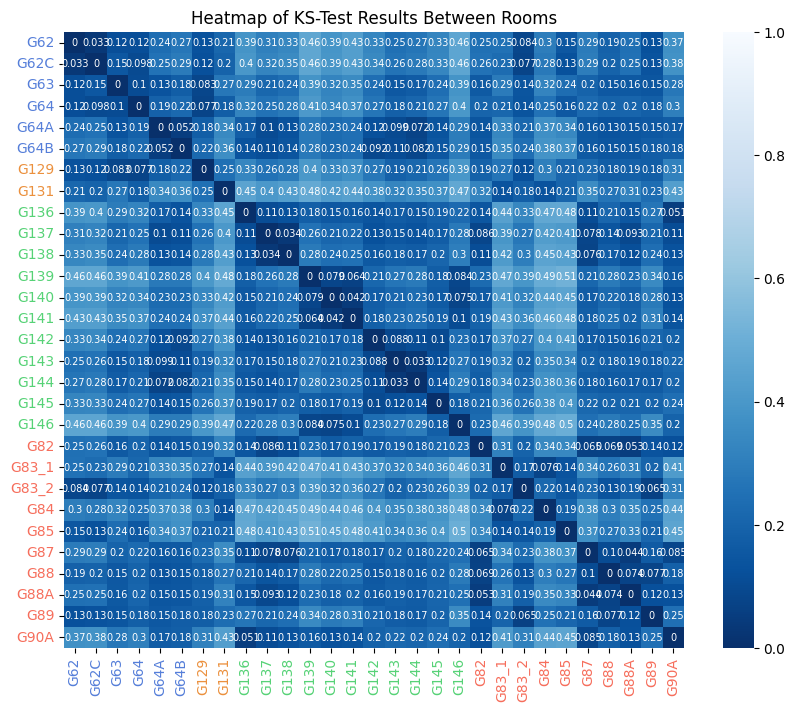

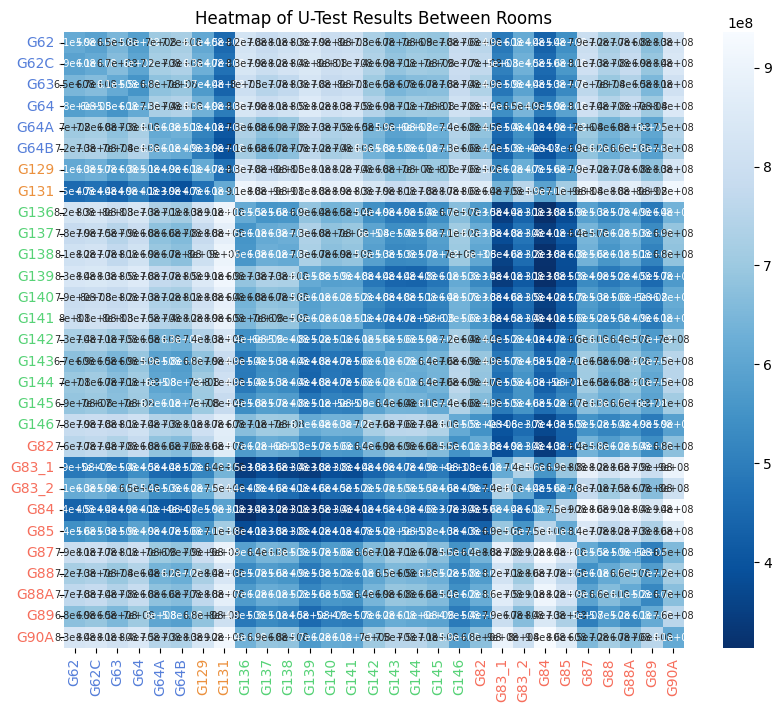

In [ ]:
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}

# 绘制热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(kst_matrix.astype(float), annot=True,annot_kws={"size": 7}, cmap="Blues_r", vmin=0, vmax=1)

# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color

plt.title('Heatmap of KS-Test Results Between Rooms')
plt.show()


# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(ut_matrix.astype(float), annot=True,annot_kws={"size": 7}, cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)

# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of U-Test Results Between Rooms')
plt.show()

<ipython-input-5-2ae670dadd25>:4: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(emd_matrix, method='average')


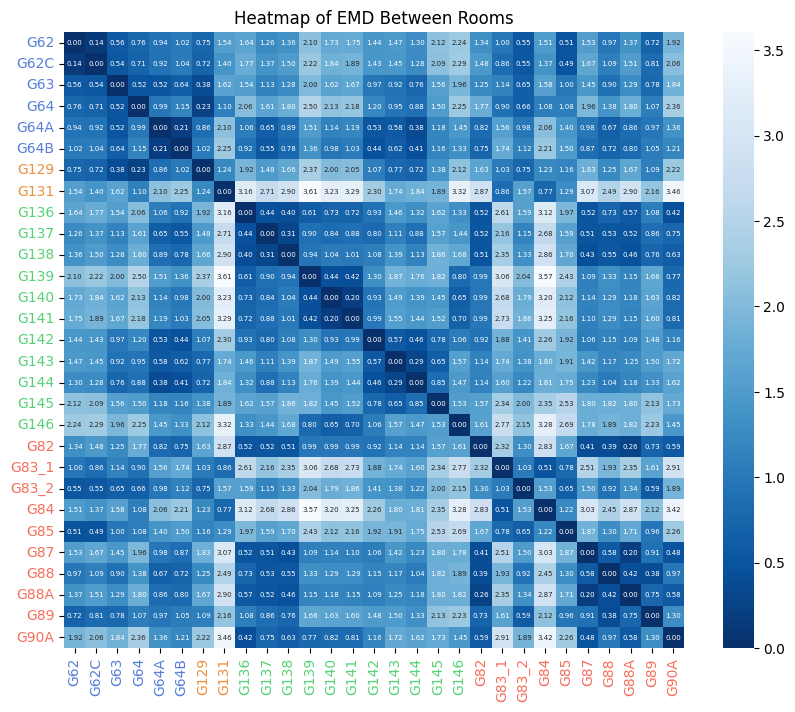

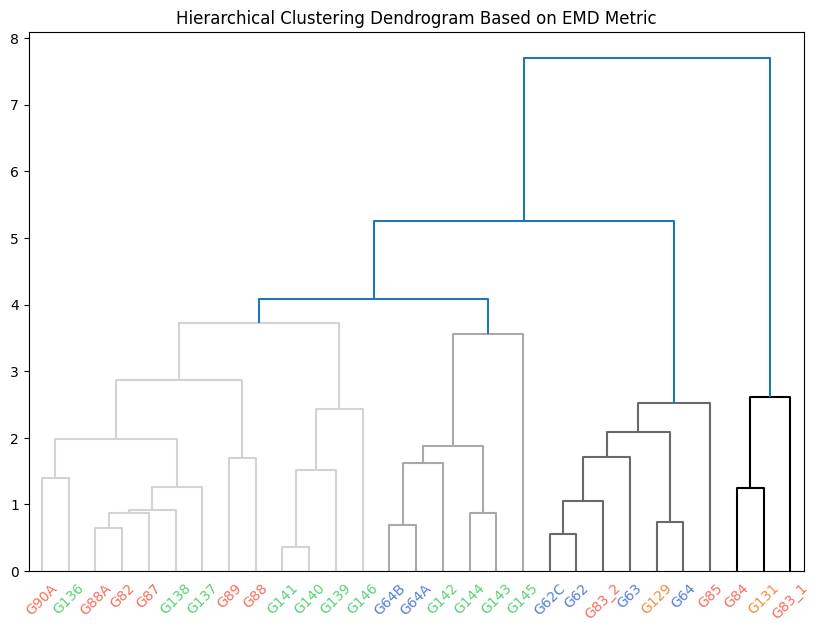

In [ ]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette
# 使用层次聚类进行聚类
linked = linkage(emd_matrix, method='average')

# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(emd_matrix.astype(float), annot=True,annot_kws={"size": 5},fmt=".2f", cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)
# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of EMD Between Rooms')
plt.show()



# 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系


# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendro = dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
                    show_leaf_counts=True, color_threshold=0.5*max(linked[:, 2]))
# 改变聚类标签颜色
ax = plt.gca()  # 获取当前的轴对象
x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

for label in x_labels:
    text = label.get_text()  # 获取标签文本
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # 蓝色
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # 橙色
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # 绿色
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # 红色
plt.title('Hierarchical Clustering Dendrogram Based on EMD Metric')
plt.show()

Data1 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
Data2 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
KS Statistic: 0.0, P-value: 1.0
Mann-Whitney U Statistic: 613900800.0, P-value: 1.0
Wasserstein Distance: 0.0
Data1 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
Data2 - Mean: 21.4611538717656, Variance: 8.159321387115856, Skewness: 0.47448470552954086, Kurtosis: -1.0916215936387896
KS Statistic: 0.032705479452054764, P-value: 1.024064687216905e-16
Mann-Whitney U Statistic: 592513387.0, P-value: 1.373270227821445e-15
Wasserstein Distance: 0.14188541666666665
Data1 - Mean: 21.319268455098932, Variance: 7.930611619695486, Skewness: 0.4801680186284487, Kurtosis: -1.0967706697045216
Data2 - Mean: 21.238382705479452, Variance: 11.205015478407473, Skewness: 0.3229886094561101, Kur

<ipython-input-40-6b18d3dc5171>:61: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(emd_matrix, method='average')


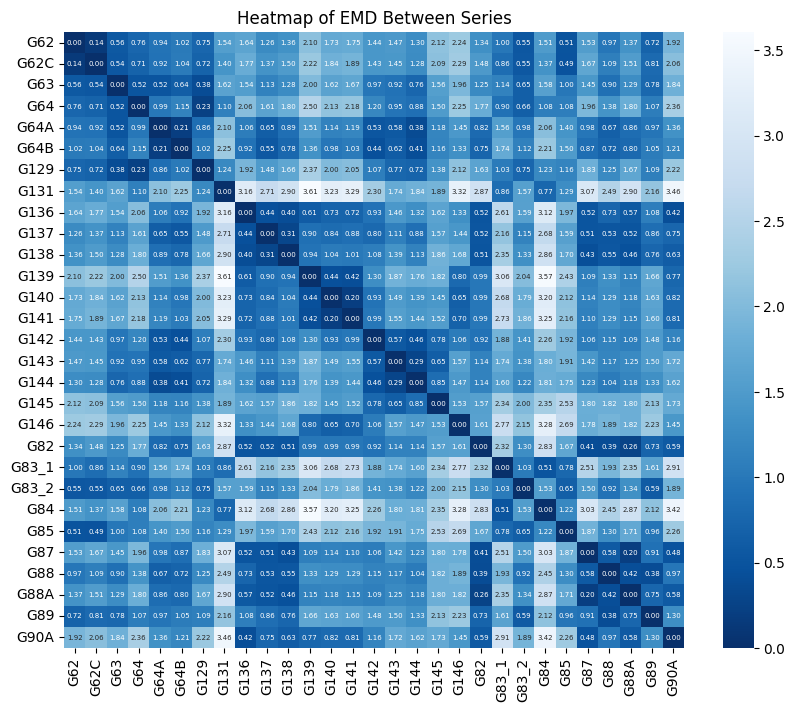

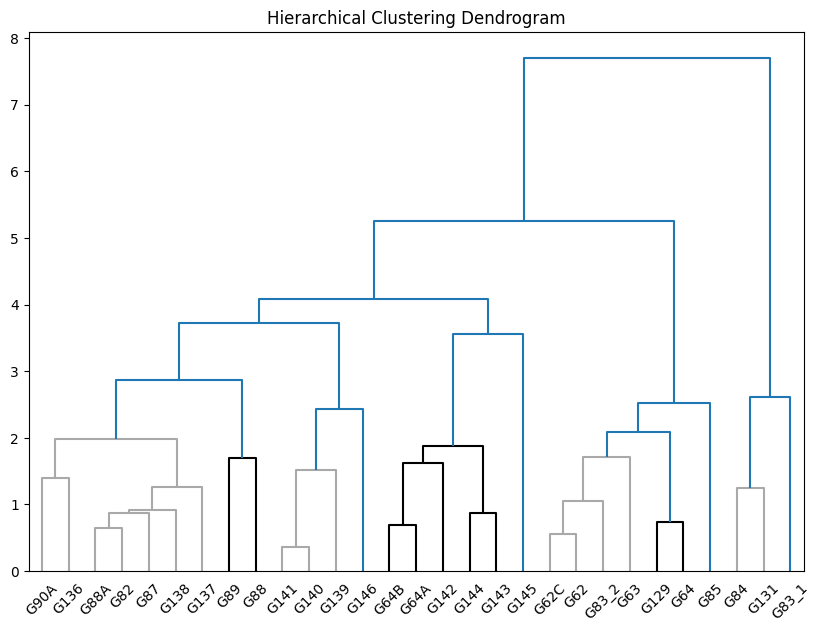

In [ ]:
import pandas as pd
from scipy.stats import ks_2samp
import numpy as np
from scipy.stats import skew, kurtosis
from scipy.stats import mannwhitneyu
from scipy.stats import wasserstein_distance
# 初始化 CS 矩阵
stat_matrix = pd.DataFrame(index=sheets, columns=sheets)
emd_matrix = pd.DataFrame(index=sheets, columns=sheets)
# 遍历每个房间对
for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        data1 = data[room1].iloc[:,0]
        data2 = data[room2].iloc[:,0]


        # 计算均值
        mean1 = data1.mean()
        mean2 = data2.mean()

        # 计算方差
        variance1 = data1.var()
        variance2 = data2.var()

        # 计算偏度
        skewness1 = skew(data1)
        skewness2 = skew(data2)

        # 计算峰度
        kurtosis1 = kurtosis(data1)
        kurtosis2 = kurtosis(data2)

       # print(f"Data1 - Mean: {mean1}, Variance: {variance1}, Skewness: {skewness1}, Kurtosis: {kurtosis1}")
        #print(f"Data2 - Mean: {mean2}, Variance: {variance2}, Skewness: {skewness2}, Kurtosis: {kurtosis2}")



        ks_statistic, p_value = ks_2samp(data1, data2)
        #print(f"KS Statistic: {ks_statistic}, P-value: {p_value}")


        u_statistic, p_value = mannwhitneyu(data1, data2)
        #print(f"Mann-Whitney U Statistic: {u_statistic}, P-value: {p_value}")



        emd_distance_T = wasserstein_distance(data1, data2)

        #print(f"Wasserstein Distance: {emd_distance}")
        emd_matrix.loc[room1,room2]=emd_distance
        emd_matrix.loc[room2,room1]=emd_distance

        if p_value < 0.05:
            stat_matrix.loc[room1,room2]=1 #显著不同
        else:
            stat_matrix.loc[room1,room2]=0 #非常相似
        stat_matrix.loc[room2,room1]=stat_matrix.loc[room1,room2]

from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
# 使用层次聚类进行聚类
linked = linkage(emd_matrix, method='average')

# 绘制聚类热力图
plt.figure(figsize=(10, 8))
sns.heatmap(emd_matrix.astype(float), annot=True,annot_kws={"size": 5},fmt=".2f", cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)
plt.title('Heatmap of EMD Between Series')
plt.show()

# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending', show_leaf_counts=True,color_threshold=2)
plt.title('Hierarchical Clustering Dendrogram')
plt.show()

<ipython-input-42-82cc66df2e0e>:2: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(emd_matrix, method='average')


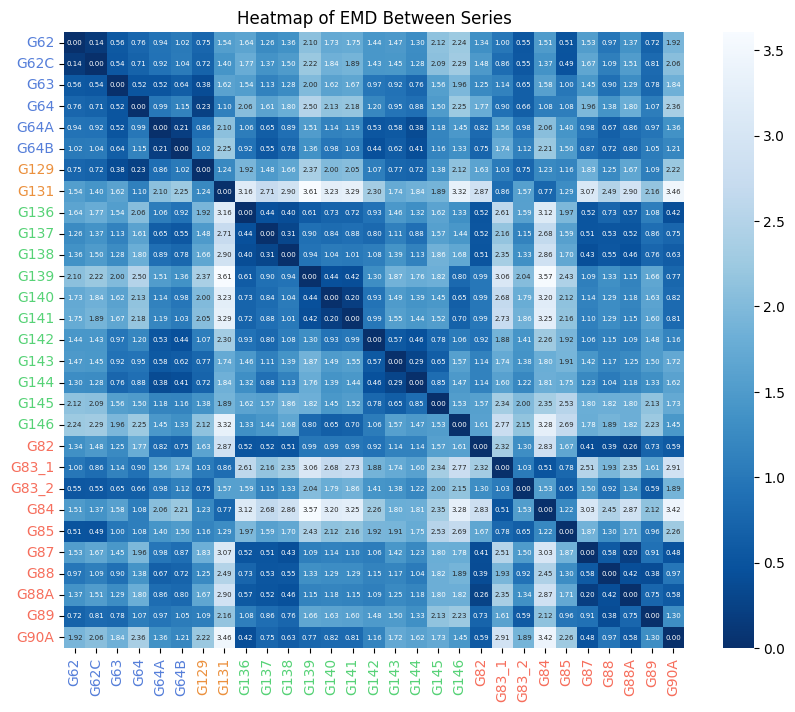

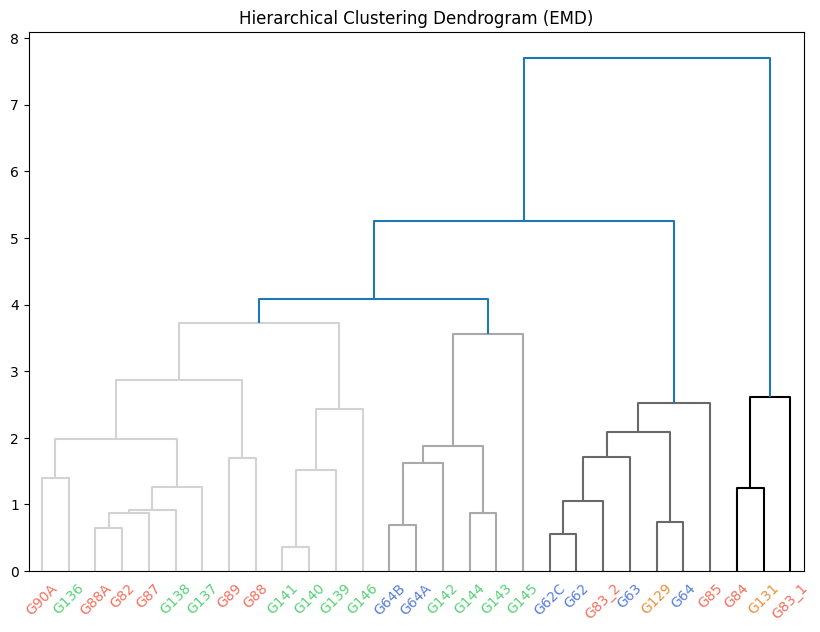

In [ ]:
# 使用层次聚类进行聚类
linked = linkage(emd_matrix, method='average')

# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax= sns.heatmap(emd_matrix.astype(float), annot=True,annot_kws={"size": 5},fmt=".2f", cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}


# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of EMD Between Series')
plt.show()


# 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系


# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendro = dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
                    show_leaf_counts=True, color_threshold=0.5*max(linked[:, 2]))
# 改变聚类标签颜色
ax = plt.gca()  # 获取当前的轴对象
x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

for label in x_labels:
    text = label.get_text()  # 获取标签文本
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # 蓝色
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # 橙色
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # 绿色
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # 红色
plt.title('Hierarchical Clustering Dendrogram (EMD)')
plt.show()

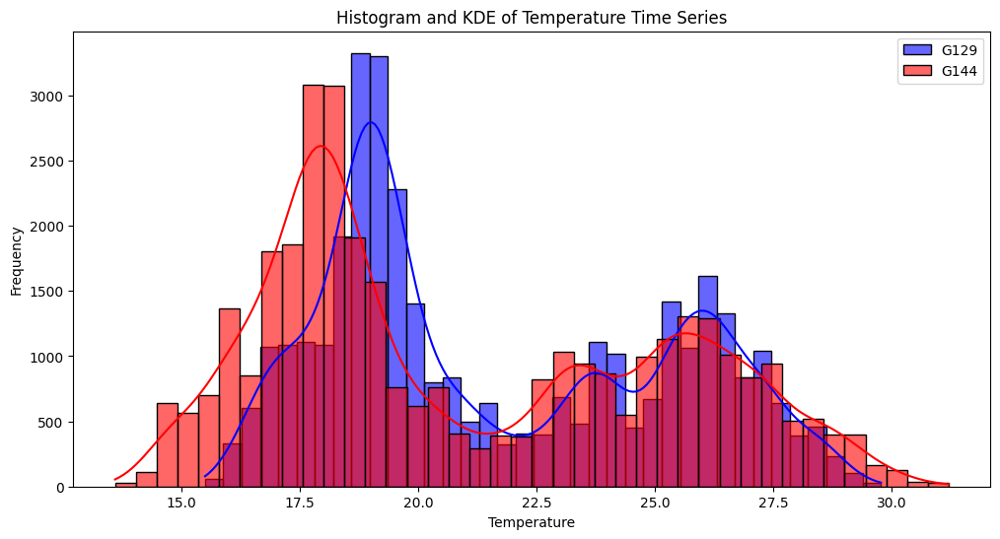

NameError: name 'ks_2samp' is not defined

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
data1=data['G129'].iloc[:,0]
data2=data['G144'].iloc[:,0]
# 绘制直方图和密度图
sns.histplot(data['G129'].iloc[:,0], kde=True, color='blue', label='G129', alpha=0.6)
sns.histplot(data['G144'].iloc[:,0], kde=True, color='red', label='G144', alpha=0.6)

plt.legend()
plt.title('Histogram and KDE of Temperature Time Series')
plt.xlabel('Temperature')
plt.ylabel('Frequency')
plt.show()

ks_statistic, p_value = ks_2samp(data1, data2)
print(f"KS Statistic: {ks_statistic}, P-value: {p_value}")


u_statistic, p_value = mannwhitneyu(data1, data2)
print(f"Mann-Whitney U Statistic: {u_statistic}, P-value: {p_value}")

import numpy as np
import scipy.stats as stats

plt.figure(figsize=(12, 6))

# Q-Q 图
stats.probplot(data1, dist="norm", plot=plt)
plt.title('Q-Q Plot for Data1')
plt.show()

plt.figure(figsize=(12, 6))
stats.probplot(data2, dist="norm", plot=plt)
plt.title('Q-Q Plot for Data2')
plt.show()


##检验

In [ ]:
print(distance_matrix,
mad_matrix,
tt_matrix,
Ft_matrix,
emd_matrix,
pearson_results,
dtw_results
)

              G62        G62C         G63         G64        G64A        G64B  \
G62      0.000000   26.757241   79.949352  112.164468  119.474926  118.698749   
G62C    26.757241    0.000000   71.908820   99.710329  113.071674  120.198322   
G63     79.949352   71.908820    0.000000   59.108607   56.725288   90.488271   
G64    112.164468   99.710329   59.108607    0.000000   74.024431  133.335768   
G64A   119.474926  113.071674   56.725288   74.024431    0.000000   97.288041   
G64B   118.698749  120.198322   90.488271  133.335768   97.288041    0.000000   
G129    90.718238   78.690031   48.020405   56.055110   78.348890  112.159347   
G131   163.883717  149.512769  139.263021  102.547391  160.426646  207.320672   
G136   182.878133  190.391265  187.182703  229.464877  183.768980  141.620955   
G137   147.963080  154.997729  158.100622  195.937079  159.800256  122.808068   
G138   158.197091  167.340543  176.248266  219.654078  181.889029  139.606216   
G139   239.564206  245.62042

In [ ]:
import scipy.stats as stats
import numpy as np
import pandas as pd
import scipy.stats as stats
import statsmodels.api as sm
from statsmodels.formula.api import ols

group1_ed = distance_matrix.iloc[:6, :6].values[np.triu_indices(6, k=1)]
group2_ed = distance_matrix.iloc[:6, 6:].values.flatten()

group_data_ed = pd.DataFrame({
    'distance': np.concatenate([group1_ed, group2_ed]),
    'group': ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
})

model = ols('distance ~ C(group)', data=group_data_ed).fit()
anova_table_ed = sm.stats.anova_lm(model, typ=2)
print(anova_table_ed)

group1_mad= mad_matrix.iloc[:6, :6].values[np.triu_indices(6, k=1)]
group2_mad = mad_matrix.iloc[:6, 6:].values.flatten()

group_data_mad = pd.DataFrame({
    'distance': np.concatenate([group1_mad, group2_mad]),
    'group': ['Group1'] * len(group1_mad) + ['Group2'] * len(group2_mad)
})

model = ols('distance ~ C(group)', data=group_data_mad).fit()
anova_table_mad = sm.stats.anova_lm(model, typ=2)
print(anova_table_mad)


group1_tt= tt_matrix.iloc[:6, :6].values[np.triu_indices(6, k=1)]
group2_tt = tt_matrix.iloc[:6, 6:].values.flatten()

group_data_tt = pd.DataFrame({
    'distance': np.concatenate([group1_tt, group2_tt]).astype(float),
    'group': ['Group1'] * len(group1_tt) + ['Group2'] * len(group2_tt)
})

model = ols('distance ~ C(group)', data=group_data_tt).fit()
anova_table_tt = sm.stats.anova_lm(model, typ=2)
print(anova_table_tt)


group1_Ft = Ft_matrix.iloc[:6, :6].values[np.triu_indices(6, k=1)]
group2_Ft = Ft_matrix.iloc[:6, 6:].values.flatten()
group_data_Ft = pd.DataFrame({
    'distance': np.concatenate([group1_Ft, group2_Ft]).astype(float),
    'group': ['Group1'] * len(group1_Ft) + ['Group2'] * len(group2_Ft)
})

model = ols('distance ~ C(group)', data=group_data_Ft).fit()
anova_table_Ft = sm.stats.anova_lm(model, typ=2)
print(anova_table_Ft)

group1_emd = emd_matrix.iloc[:6, :6].values[np.triu_indices(6, k=1)]
group2_emd = emd_matrix.iloc[:6, 6:].values.flatten()
group_data_emd = pd.DataFrame({
    'distance': np.concatenate([group1_emd, group2_emd]).astype(float),
    'group': ['Group1'] * len(group1_emd) + ['Group2'] * len(group2_emd)
})

model = ols('distance ~ C(group)', data=group_data_emd).fit()
anova_table_emd = sm.stats.anova_lm(model, typ=2)
print(anova_table_emd)





# 提取前六个房间之间的相关系数（不包括自身相关，取上三角部分）
group1_pcc = pearson_results.iloc[:6, :6].values[np.triu_indices(6, k=1)]

# 提取前六个房间与其他房间之间的相关系数
group2_pcc = pearson_results.iloc[:6, 6:].values.flatten()

# 创建DataFrame用于方差分析
group_data_pcc = pd.DataFrame({
    'distance': np.concatenate([group1_pcc, group2_pcc]).astype(float),
    'group': ['Group1'] * len(group1_pcc) + ['Group2'] * len(group2_pcc)
})

# 进行单因素方差分析
model = ols('distance ~ C(group)', data=group_data_pcc).fit()
anova_table_pcc = sm.stats.anova_lm(model, typ=2)
print(anova_table_pcc)


group1_dtw = dtw_results.iloc[:6, :6].values[np.triu_indices(6, k=1)]
group2_dtw = dtw_results.iloc[:6, 6:].values.flatten()
group_data_dtw = pd.DataFrame({
    'distance': np.concatenate([group1_dtw, group2_dtw]).astype(float),
    'group': ['Group1'] * len(group1_dtw) + ['Group2'] * len(group2_dtw)
})

model = ols('distance ~ C(group)', data=group_data_dtw).fit()
anova_table_dtw = sm.stats.anova_lm(model, typ=2)
print(anova_table_dtw)



                 sum_sq     df        F        PR(>F)
C(group)   94744.179894    1.0  39.5674  3.250438e-09
Residual  361569.654228  151.0      NaN           NaN
            sum_sq     df         F        PR(>F)
C(group)  0.483048    1.0  34.69203  2.417092e-08
Residual  2.102508  151.0       NaN           NaN
                sum_sq     df          F    PR(>F)
C(group)   4179.628991    1.0  21.942372  0.000006
Residual  28762.796231  151.0        NaN       NaN
                sum_sq     df         F    PR(>F)
C(group)  5.118074e+06    1.0  2.177114  0.142159
Residual  3.549788e+08  151.0       NaN       NaN
              sum_sq     df          F    PR(>F)
C(group)   11.851076    1.0  16.570874  0.000075
Residual  107.991440  151.0        NaN       NaN
            sum_sq     df          F    PR(>F)
C(group)  0.048533    1.0  20.608634  0.000011
Residual  0.355601  151.0        NaN       NaN
                sum_sq     df          F        PR(>F)
C(group)  2.119488e+09    1.0  37.836362  

In [ ]:
# prompt: 将anova_table的结果导出至表格

import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols

# ... (your existing code)

# 将 ANOVA 结果导出到表格
anova_tables = {
    "Euclidean Distance": anova_table_ed,
    "MAD": anova_table_mad,
    "t-test": anova_table_tt,
    "F-test": anova_table_Ft,
    "EMD": anova_table_emd,
    "Pearson Correlation": anova_table_pcc,
    "DTW": anova_table_dtw
}

with pd.ExcelWriter("anova_results.xlsx") as writer:
    for name, table in anova_tables.items():
        table.to_excel(writer, sheet_name=name)


In [ ]:
kruskal_stat, p_value = stats.kruskal(group1, group2, group3)
print(f"Kruskal-Wallis H-statistic: {kruskal_stat}")
print(f"P-value: {p_value}")


In [ ]:
# prompt: 导出多个矩阵至excel

import pandas as pd
!pip install openpyxl

# 创建一个 ExcelWriter 对象
with pd.ExcelWriter('multiple_matrices.xlsx', engine='openpyxl') as writer:
    # 将每个矩阵写入不同的工作表
    distance_matrix.to_excel(writer, sheet_name='Euclidean Distance')
    mad_matrix.to_excel(writer, sheet_name='MAD')
    tt_matrix.to_excel(writer, sheet_name='t-test')
    Ft_matrix.to_excel(writer, sheet_name='F-test')
    emd_matrix.to_excel(writer, sheet_name='EMD')
    pearson_results.to_excel(writer, sheet_name='Pearson Correlation')
    dtw_results.to_excel(writer, sheet_name='DTW Distance')
    kru_matrix.to_excel(writer, sheet_name='Kru')
# 文件将保存在 Colab 运行时的当前工作目录中


IndexError: At least one sheet must be visible

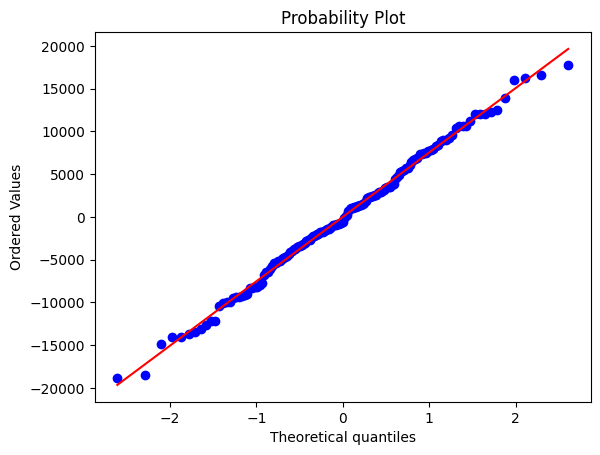

Shapiro-Wilk test statistic: 0.9946806185367283
p-value: 0.8531885681708689


In [ ]:
# 检验数据是否满足方差分析的假设
import scipy.stats as stats
import matplotlib.pyplot as plt

# Q-Q图
residuals = model.resid
stats.probplot(residuals, dist="norm", plot=plt)
plt.show()

# Shapiro-Wilk检验
shapiro_test = stats.shapiro(residuals)
print('Shapiro-Wilk test statistic:', shapiro_test[0])
print('p-value:', shapiro_test[1])


In [ ]:
# prompt: 对每个method做方差齐性检验和正态性检验，并输出姐u共

import statsmodels.api as sm
from scipy import stats
from statsmodels.formula.api import ols

# ... (your existing code)

def check_assumptions(data, method_name):
    """
    Performs normality and homogeneity of variance tests on the given data.

    Args:
        data: A pandas DataFrame containing the distance/correlation values.
        method_name: The name of the method used to calculate the values.
    """
    # 正态性检验 (Shapiro-Wilk)
    _, p_value_normality = stats.shapiro(data['distance'])
    normality_result = "Passed" if p_value_normality > 0.05 else "Failed"

    # 方差齐性检验 (Levene's test)
    _, p_value_homogeneity = stats.levene(
        data['distance'][data['group'] == 'Group1'],
        data['distance'][data['group'] == 'Group2']
    )
    homogeneity_result = "Passed" if p_value_homogeneity > 0.05 else "Failed"

    print(f"--- {method_name} ---")
    print(f"Normality Test (Shapiro-Wilk): {normality_result} (p-value: {p_value_normality:.3f})")
    print(f"Homogeneity of Variance Test (Levene's): {homogeneity_result} (p-value: {p_value_homogeneity:.3f})")

# 对每个方法进行检验
check_assumptions(group_data_ed, "Euclidean Distance")
check_assumptions(group_data_mad, "MAD")
check_assumptions(group_data_tt, "t-test")
check_assumptions(group_data_Ft, "F-test")
check_assumptions(group_data_emd, "EMD")
check_assumptions(group_data_pcc, "Pearson Correlation")
check_assumptions(group_data_dtw, "DTW")


--- Euclidean Distance ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.745)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.034)
--- MAD ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.670)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.022)
--- t-test ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.772)
Homogeneity of Variance Test (Levene's): Passed (p-value: 0.680)
--- F-test ---
Normality Test (Shapiro-Wilk): Failed (p-value: 0.000)
Homogeneity of Variance Test (Levene's): Passed (p-value: 0.212)
--- EMD ---
Normality Test (Shapiro-Wilk): Failed (p-value: 0.000)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.000)
--- Pearson Correlation ---
Normality Test (Shapiro-Wilk): Failed (p-value: 0.000)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.008)
--- DTW ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.666)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.030)


In [ ]:
# prompt: 提取两个检验的p-value，输出检验结果至表格，横轴为两个检验的p-value，纵轴为七个方法

import pandas as pd
# 提取p-value
p_values = {
    "Euclidean Distance": (anova_table_ed['PR(>F)'][0], stats.shapiro(group_data_ed['distance'])[1], stats.levene(group_data_ed['distance'][group_data_ed['group'] == 'Group1'], group_data_ed['distance'][group_data_ed['group'] == 'Group2'])[1]),
    "MAD": (anova_table_mad['PR(>F)'][0], stats.shapiro(group_data_mad['distance'])[1], stats.levene(group_data_mad['distance'][group_data_mad['group'] == 'Group1'], group_data_mad['distance'][group_data_mad['group'] == 'Group2'])[1]),
    "t-test": (anova_table_tt['PR(>F)'][0], stats.shapiro(group_data_tt['distance'])[1], stats.levene(group_data_tt['distance'][group_data_tt['group'] == 'Group1'], group_data_tt['distance'][group_data_tt['group'] == 'Group2'])[1]),
    "F-test": (anova_table_Ft['PR(>F)'][0], stats.shapiro(group_data_Ft['distance'])[1], stats.levene(group_data_Ft['distance'][group_data_Ft['group'] == 'Group1'], group_data_Ft['distance'][group_data_Ft['group'] == 'Group2'])[1]),
    "EMD": (anova_table_emd['PR(>F)'][0], stats.shapiro(group_data_emd['distance'])[1], stats.levene(group_data_emd['distance'][group_data_emd['group'] == 'Group1'], group_data_emd['distance'][group_data_emd['group'] == 'Group2'])[1]),
    "Pearson Correlation": (anova_table_pcc['PR(>F)'][0], stats.shapiro(group_data_pcc['distance'])[1], stats.levene(group_data_pcc['distance'][group_data_pcc['group'] == 'Group1'], group_data_pcc['distance'][group_data_pcc['group'] == 'Group2'])[1]),
    "DTW": (anova_table_dtw['PR(>F)'][0], stats.shapiro(group_data_dtw['distance'])[1], stats.levene(group_data_dtw['distance'][group_data_dtw['group'] == 'Group1'], group_data_dtw['distance'][group_data_dtw['group'] == 'Group2'])[1])
}

# 创建结果表格
result_df = pd.DataFrame(p_values).T
result_df.columns = ['ANOVA p-value', 'Shapiro-Wilk p-value', 'Levene p-value']

# 输出结果
print(result_df)

# 保存结果到Excel
result_df.to_excel("test_results.xlsx")


                     ANOVA p-value  Shapiro-Wilk p-value  Levene p-value
Euclidean Distance    3.250438e-09          7.447180e-01        0.033832
MAD                   2.417092e-08          6.703976e-01        0.022337
t-test                6.216010e-06          7.718241e-01        0.679592
F-test                1.421591e-01          2.549435e-13        0.212221
EMD                   7.534772e-05          2.046017e-04        0.000318
Pearson Correlation   1.143551e-05          7.807168e-07        0.008466
DTW                   6.583199e-09          6.661991e-01        0.029639


<ipython-input-81-c0c9e037a90f>:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  "Euclidean Distance": (anova_table_ed['PR(>F)'][0], stats.shapiro(group_data_ed['distance'])[1], stats.levene(group_data_ed['distance'][group_data_ed['group'] == 'Group1'], group_data_ed['distance'][group_data_ed['group'] == 'Group2'])[1]),
<ipython-input-81-c0c9e037a90f>:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  "MAD": (anova_table_mad['PR(>F)'][0], stats.shapiro(group_data_mad['distance'])[1], stats.levene(group_data_mad['distance'][group_data_mad['group'] == 'Group1'], group_data_mad['distance'][group_data_mad['group'] == 'Grou

In [ ]:
results = {
    "Euclidean Distance": check_assumptions(group_data_ed, "Euclidean Distance"),
    "MAD": check_assumptions(group_data_mad, "MAD"),
    "t-test": check_assumptions(group_data_tt, "t-test"),
    "F-test": check_assumptions(group_data_Ft, "F-test"),
    "EMD": check_assumptions(group_data_emd, "EMD"),
    "Pearson Correlation": check_assumptions(group_data_pcc, "Pearson Correlation"),
    "DTW": check_assumptions(group_data_dtw, "DTW")
}
results

--- Euclidean Distance ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.745)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.034)
--- MAD ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.670)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.022)
--- t-test ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.772)
Homogeneity of Variance Test (Levene's): Passed (p-value: 0.680)
--- F-test ---
Normality Test (Shapiro-Wilk): Failed (p-value: 0.000)
Homogeneity of Variance Test (Levene's): Passed (p-value: 0.212)
--- EMD ---
Normality Test (Shapiro-Wilk): Failed (p-value: 0.000)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.000)
--- Pearson Correlation ---
Normality Test (Shapiro-Wilk): Failed (p-value: 0.000)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.008)
--- DTW ---
Normality Test (Shapiro-Wilk): Passed (p-value: 0.666)
Homogeneity of Variance Test (Levene's): Failed (p-value: 0.030)


{'Euclidean Distance': None,
 'MAD': None,
 't-test': None,
 'F-test': None,
 'EMD': None,
 'Pearson Correlation': None,
 'DTW': None}

In [ ]:
group_data_tt

,distance,group
0,0.076116,Group1
1,9.893460,Group1
2,14.245169,Group1
3,20.548999,Group1
4,-1.473320,Group1
...,...,...
148,-6.342831,Group2
149,-5.392032,Group2
150,-22.062902,Group2
151,-9.810963,Group2


In [ ]:
# 方差齐性
# Levene检验
levene_test = stats.levene(group1_ed, group2_ed)
print('Levene test statistic:', levene_test[0])
print('p-value:', levene_test[1])


Levene test statistic: 4.5863508052984505
p-value: 0.0338318742359178


In [ ]:
# KW test
from scipy.stats import kruskal


# 创建 DataFrame
all_data = pd.DataFrame({
    'similarity': np.concatenate([group1_ed, group2_ed, group1_mad, group2_mad,
                                  group1_tt, group2_tt, group1_Ft, group2_Ft,
                                  group1_emd, group2_emd, group1_pcc, group2_pcc,
                                  group1_dtw, group2_dtw]).astype(float),
    'group': ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed) + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
    + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed) + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
    + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed) + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
    + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed),
    'method': ['Method1'] * (len(group1_ed)+len(group2_ed)) + ['Method2'] * (len(group1_ed)+len(group2_ed))
    + ['Method3'] * (len(group1_ed)+len(group2_ed)) + ['Method4'] * (len(group1_ed)+len(group2_ed))
    + ['Method5'] * (len(group1_ed)+len(group2_ed)) + ['Method6'] * (len(group1_ed)+len(group2_ed))
    + ['Method7'] * (len(group1_ed)+len(group2_ed))
})

# 查看前几行数据
print(all_data.head())


# 对于每种度量方法分别进行Kruskal-Wallis检验
for method in all_data['method'].unique():
    subset = all_data[all_data['method'] == method]
    group1 = subset[subset['group'] == 'Group1']['similarity']
    group2 = subset[subset['group'] == 'Group2']['similarity']

    stat, p_value = kruskal(group1, group2)
    print(f'Method: {method}, Kruskal-Wallis H-statistic: {stat}, p-value: {p_value}')


   similarity   group   method
0   26.757241  Group1  Method1
1   79.949352  Group1  Method1
2  112.164468  Group1  Method1
3  119.474926  Group1  Method1
4  118.698749  Group1  Method1
Method: Method1, Kruskal-Wallis H-statistic: 29.217428947863652, p-value: 6.469463802630712e-08
Method: Method2, Kruskal-Wallis H-statistic: 27.776435159043842, p-value: 1.361746998377175e-07
Method: Method3, Kruskal-Wallis H-statistic: 17.100545830980536, p-value: 3.5452114551907875e-05
Method: Method4, Kruskal-Wallis H-statistic: 1.344664031620482, p-value: 0.24621312862719144
Method: Method5, Kruskal-Wallis H-statistic: 16.94865424430634, p-value: 3.8404534329342715e-05
Method: Method6, Kruskal-Wallis H-statistic: 26.246000376435063, p-value: 3.0057669435873093e-07
Method: Method7, Kruskal-Wallis H-statistic: 28.55791454921882, p-value: 9.093735886489048e-08


In [ ]:
# prompt: 把KW的结果输出至表格

import pandas as pd
# ... (your existing code)

# 存储Kruskal-Wallis检验结果
kruskal_results = []
for method in all_data['method'].unique():
    subset = all_data[all_data['method'] == method]
    group1 = subset[subset['group'] == 'Group1']['similarity']
    group2 = subset[subset['group'] == 'Group2']['similarity']

    stat, p_value = kruskal(group1, group2)
    kruskal_results.append([method, stat, p_value])

# 创建结果DataFrame
kruskal_df = pd.DataFrame(kruskal_results, columns=['Method', 'H-statistic', 'p-value'])

# 输出结果到Excel
with pd.ExcelWriter('kruskal_results.xlsx') as writer:
    kruskal_df.to_excel(writer, sheet_name='Kruskal-Wallis Results', index=False)


In [ ]:
np.concatenate([group1_ed, group2_ed, group1_mad, group2_mad,
                                  group1_tt, group2_tt, group1_Ft, group2_Ft,
                                  group1_emd, group2_emd, group1_pcc, group2_pcc,
                                  group1_dtw, group2_dtw]).shape

(1071,)

In [ ]:
group123=(['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed) + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
    + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed) + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
    + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed) + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed)
    + ['Group1'] * len(group1_ed) + ['Group2'] * len(group2_ed))
my_array = np.array(group123)

# 现在你可以使用 .shape 属性
print(my_array.shape)

(1071,)


In [ ]:
len(group1_ed)

15

In [ ]:
import statsmodels.api as sm
from scipy import stats
from statsmodels.formula.api import ols
 # 正态性检验 (Shapiro-Wilk)
_, p_value_normality = stats.shapiro(data['G129'].iloc[:,0])
normality_result = "Passed" if p_value_normality > 0.05 else "Failed"

# 方差齐性检验 (Levene's test)
_, p_value_homogeneity = stats.levene(
    data['G129'].iloc[:,0],
    data['G131'].iloc[:,0]
    )
homogeneity_result = "Passed" if p_value_homogeneity > 0.05 else "Failed"



/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 35040.
  res = hypotest_fun_out(*samples, **kwds)


In [ ]:
homogeneity_result

'Failed'

In [ ]:
matrices['Kru']=kru_matrix

In [ ]:
# prompt: 读取文件/content/drive/MyDrive/multiple_matrices.xlsx里每个工作表的数据

import pandas as pd
# 读取 Excel 文件
xls = pd.ExcelFile('/content/drive/MyDrive/multiple_matrices.xlsx')

# 获取所有工作表名称
sheet_names = xls.sheet_names

# 循环读取每个工作表的数据
matrices = {}
for sheet_name in sheet_names:
  matrices[sheet_name] = pd.read_excel(xls, sheet_name=sheet_name, index_col=0)

# 打印每个矩阵
for sheet_name, matrix in matrices.items():
  print(f"--- {sheet_name} ---\n{matrix}\n")


--- Euclidean Distance ---
              G62        G62C         G63         G64        G64A        G64B  \
G62      0.000000   26.757241   79.949352  112.164468  119.474926  118.698749   
G62C    26.757241    0.000000   71.908820   99.710329  113.071674  120.198322   
G63     79.949352   71.908820    0.000000   59.108607   56.725288   90.488271   
G64    112.164468   99.710329   59.108607    0.000000   74.024431  133.335768   
G64A   119.474926  113.071674   56.725288   74.024431    0.000000   97.288041   
G64B   118.698749  120.198322   90.488271  133.335768   97.288041    0.000000   
G129    90.718238   78.690031   48.020405   56.055110   78.348890  112.159347   
G131   163.883717  149.512769  139.263021  102.547391  160.426646  207.320672   
G136   182.878133  190.391265  187.182703  229.464877  183.768980  141.620955   
G137   147.963080  154.997729  158.100622  195.937079  159.800256  122.808068   
G138   158.197091  167.340543  176.248266  219.654078  181.889029  139.606216   
G

In [ ]:
matrices['Euclidean Distance']

,G62,G62C,G63,G64,G64A,G64B,G129,G131,G136,G137,...,G82,G83_1,G83_2,G84,G85,G87,G88,G88A,G89,G90A
G62,0.000000,26.757241,79.949352,112.164468,119.474926,118.698749,90.718238,163.883717,182.878133,147.963080,...,225.758419,125.963631,120.078623,156.713837,82.326359,174.208930,180.041759,194.608521,141.119155,240.291852
G62C,26.757241,0.000000,71.908820,99.710329,113.071674,120.198322,78.690031,149.512769,190.391265,154.997729,...,237.350718,121.999557,121.814155,150.353793,87.761266,183.463986,190.226164,205.194673,151.680381,248.757706
G63,79.949352,71.908820,0.000000,59.108607,56.725288,90.488271,48.020405,139.263021,187.182703,158.100622,...,263.217902,155.033775,159.461606,168.265861,126.426995,196.909709,217.239162,224.131025,182.538659,241.701714
G64,112.164468,99.710329,59.108607,0.000000,74.024431,133.335768,56.055110,102.547391,229.464877,195.937079,...,295.079997,149.685723,172.333533,149.112105,148.077674,234.351555,246.830882,262.235388,214.274086,280.652994
G64A,119.474926,113.071674,56.725288,74.024431,0.000000,97.288041,78.348890,160.426646,183.768980,159.800256,...,271.765762,181.476547,177.517233,193.811728,160.039754,198.815002,228.481084,230.689058,199.066464,236.154218
G64B,118.698749,120.198322,90.488271,133.335768,97.288041,0.000000,112.159347,207.320672,141.620955,122.808068,...,237.760900,198.974498,175.483430,220.997986,159.454383,161.371241,204.138486,183.517002,174.299127,184.419581
G129,90.718238,78.690031,48.020405,56.055110,78.348890,112.159347,0.000000,105.825585,206.827303,174.817478,...,281.851091,147.902505,161.180740,158.094049,134.947429,216.906221,233.279989,242.862116,197.599589,262.720666
G131,163.883717,149.512769,139.263021,102.547391,160.426646,207.320672,105.825585,0.000000,298.859088,260.823536,...,347.818717,153.770577,202.206871,137.495413,185.613803,297.408763,295.398234,322.657034,263.119405,351.118090
G136,182.878133,190.391265,187.182703,229.464877,183.768980,141.620955,206.827303,298.859088,0.000000,63.979927,...,198.120073,253.623259,207.310919,290.388170,201.889030,128.886244,183.679074,133.124310,164.747296,132.606686
G137,147.963080,154.997729,158.100622,195.937079,159.800256,122.808068,174.817478,260.823536,63.979927,0.000000,...,186.327419,209.049063,161.685771,245.510286,167.681457,121.806614,163.586730,132.478753,140.791224,156.962529


<ipython-input-9-e188c53d19a8>:4: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(matrices['Euclidean Distance'], method='average')


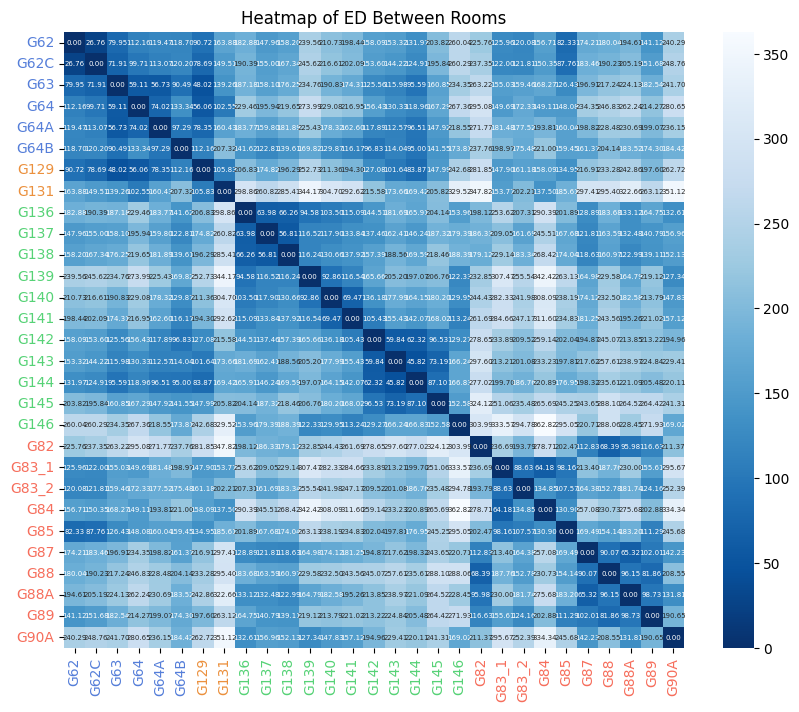

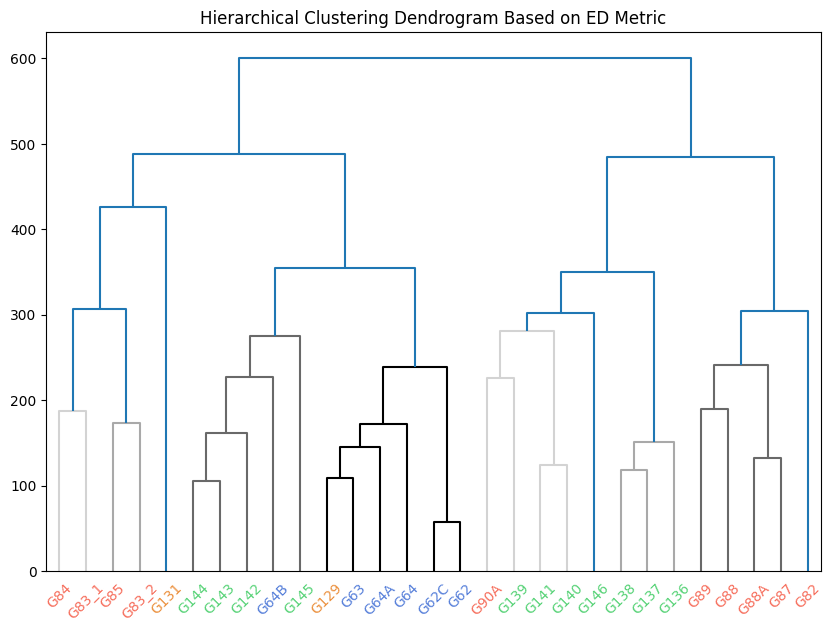

In [ ]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette
# 使用层次聚类进行聚类
linked = linkage(matrices['Euclidean Distance'], method='average')
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}
# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(matrices['Euclidean Distance'].astype(float), annot=True,annot_kws={"size": 5},fmt=".2f", cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)
# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of ED Between Rooms')
plt.show()



# 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系


# 绘制层次聚类树状图
plt.figure(figsize=(10, 7))
dendro = dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
                    show_leaf_counts=True, color_threshold=0.5*max(linked[:, 2]))
# 改变聚类标签颜色
ax = plt.gca()  # 获取当前的轴对象
x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

for label in x_labels:
    text = label.get_text()  # 获取标签文本
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # 蓝色
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # 橙色
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # 绿色
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # 红色
plt.title('Hierarchical Clustering Dendrogram Based on ED Metric')
plt.show()

In [ ]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
for sheet_name, matrix in matrices.items():
# 生成示例数据
    X=matrix.values
    print(sheet_name)
    # 应用K-means聚类
    kmeans = KMeans(n_clusters=4, random_state=42)
    labels = kmeans.fit_predict(X)

    # 计算轮廓系数
    silhouette_avg = silhouette_score(X, labels)
    print(f"轮廓系数 (Silhouette Coefficient): {silhouette_avg}")

    # 计算戴维森堡丁指数 (DBI)
    dbi_score = davies_bouldin_score(X, labels)
    print(f"戴维森堡丁指数 (DBI): {dbi_score}")


Euclidean Distance
轮廓系数 (Silhouette Coefficient): 0.3576405484065868
戴维森堡丁指数 (DBI): 0.9352325558022445
MAD
轮廓系数 (Silhouette Coefficient): 0.3599772569672945
戴维森堡丁指数 (DBI): 0.9930045578376259
t-test
轮廓系数 (Silhouette Coefficient): 0.37414219310598784
戴维森堡丁指数 (DBI): 0.8736416754968446
F-test
轮廓系数 (Silhouette Coefficient): 0.5151914002952109
戴维森堡丁指数 (DBI): 0.5197676326122296
EMD
轮廓系数 (Silhouette Coefficient): 0.4857875358749958
戴维森堡丁指数 (DBI): 0.6288169806716214
Pearson Correlation
轮廓系数 (Silhouette Coefficient): 0.45345418954715866
戴维森堡丁指数 (DBI): 0.6570357782471233
DTW Distance
轮廓系数 (Silhouette Coefficient): 0.3616843440178328
戴维森堡丁指数 (DBI): 0.9386054363434495


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

In [ ]:
from sklearn.datasets import make_blobs
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score
for sheet_name, matrix in matrices.items():
# 生成示例数据
    X=matrix.values
    print(sheet_name)


    # 使用层次聚类法
    hierarchical_clustering = AgglomerativeClustering(n_clusters=4)
    labels = hierarchical_clustering.fit_predict(X)

    # 计算轮廓系数
    silhouette_avg = silhouette_score(X, labels)
    print(f"轮廓系数 (Silhouette Coefficient): {silhouette_avg}")

    # 计算戴维森堡丁指数 (DBI)
    dbi_score = davies_bouldin_score(X, labels)
    print(f"戴维森堡丁指数 (DBI): {dbi_score}")


Euclidean Distance
轮廓系数 (Silhouette Coefficient): 0.32304165162328974
戴维森堡丁指数 (DBI): 0.9174220944935879
MAD
轮廓系数 (Silhouette Coefficient): 0.3344598951098109
戴维森堡丁指数 (DBI): 1.0528176485465601
t-test
轮廓系数 (Silhouette Coefficient): 0.34660605397997524
戴维森堡丁指数 (DBI): 0.9236822785395391
F-test
轮廓系数 (Silhouette Coefficient): 0.5306230062539958
戴维森堡丁指数 (DBI): 0.4704199949628038
EMD
轮廓系数 (Silhouette Coefficient): 0.47630439781900524
戴维森堡丁指数 (DBI): 0.660554806820147
Pearson Correlation
轮廓系数 (Silhouette Coefficient): 0.4044557796515381
戴维森堡丁指数 (DBI): 0.7115335924767451
DTW Distance
轮廓系数 (Silhouette Coefficient): 0.3461961677929292
戴维森堡丁指数 (DBI): 0.9829939358847811


/usr/local/lib/python3.10/dist-packages/scipy/cluster/hierarchy.py:796: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidean')
/usr/local/lib/python3.10/dist-packages/scipy/cluster/hierarchy.py:796: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidean')
/usr/local/lib/python3.10/dist-packages/scipy/cluster/hierarchy.py:796: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidean')
/usr/local/lib/python3.10/dist-packages/scipy/cluster/hierarchy.py:796: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidea

In [ ]:
# prompt: 导出所有matrix的轮廓系数和DBI至excel

import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.cluster import AgglomerativeClustering

# 存储结果
kmeans_results = []
hierarchical_results = []

for sheet_name, matrix in matrices.items():
  X = matrix.values

  # K-means
  kmeans = KMeans(n_clusters=4, random_state=42)
  labels = kmeans.fit_predict(X)
  silhouette_avg = silhouette_score(X, labels)
  dbi_score = davies_bouldin_score(X, labels)
  kmeans_results.append([sheet_name, silhouette_avg, dbi_score])

  # Hierarchical Clustering
  hierarchical_clustering = AgglomerativeClustering(n_clusters=4)
  labels = hierarchical_clustering.fit_predict(X)
  silhouette_avg = silhouette_score(X, labels)
  dbi_score = davies_bouldin_score(X, labels)
  hierarchical_results.append([sheet_name, silhouette_avg, dbi_score])

# 创建结果DataFrame
kmeans_df = pd.DataFrame(kmeans_results, columns=['Method', 'Silhouette Score', 'DBI'])
hierarchical_df = pd.DataFrame(hierarchical_results, columns=['Method', 'Silhouette Score', 'DBI'])

# 输出结果到Excel
with pd.ExcelWriter('clustering_evaluation_results.xlsx') as writer:
  kmeans_df.to_excel(writer, sheet_name='K-means', index=False)
  hierarchical_df.to_excel(writer, sheet_name='Hierarchical', index=False)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/scipy/cluster/hierarchy.py:796: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='ward', metric='euclidean')
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/scipy/cluster/hierarchy.py:796: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return 

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- Euclidean Distance ---
     Room  Cluster    Distance
0     G62        2  246.420921
1    G62C        2  232.359486
2     G63        2  140.375586
3     G64        2  219.463517
4    G64A        2  106.687938
5    G64B        2  195.484218
6    G129        2  158.808409
7    G131        1  320.338458
8    G136        0  140.878974
9    G137        0  246.832470
10   G138        0  216.313293
11   G139        0  160.904479
12   G140        0  125.274517
13   G141        0  169.857541
14   G142        2  242.755221
15   G143        2  179.355476
16   G144        2  143.510713
17   G145        2  312.026905
18   G146        0  300.748867
19    G82        3  224.560959
20  G83_1        1   99.354682
21  G83_2        1  216.644584
22    G84        1  184.701917
23    G85        1  224.546533
24    G87        3  156.151227
25    G88        3  107.769150
26   G88A        3  132.765712
27    G89        3  175.191125
28   G90A        0  237.896188



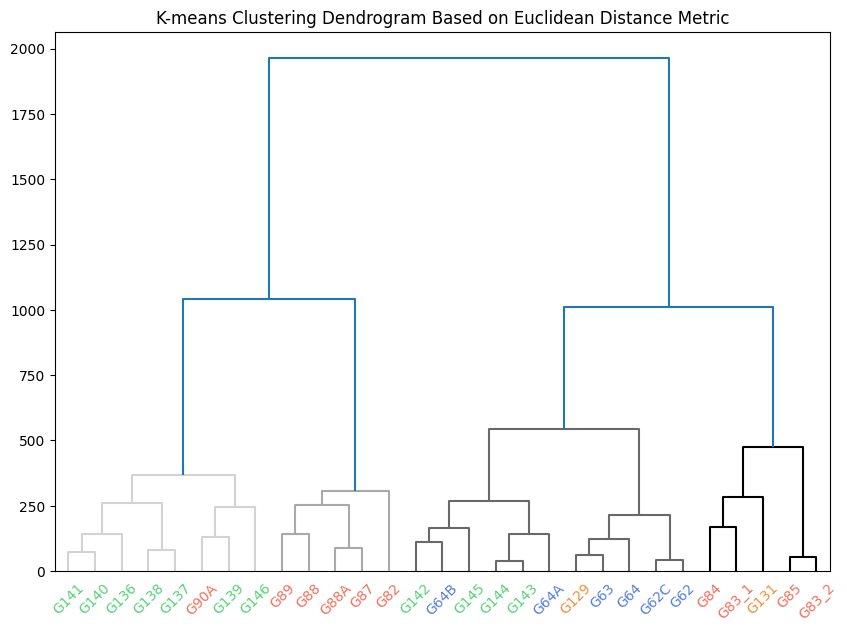

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- MAD ---
     Room  Cluster  Distance
0     G62        1  0.547764
1    G62C        1  0.505504
2     G63        1  0.302379
3     G64        1  0.544544
4    G64A        1  0.267980
5    G64B        1  0.478728
6    G129        1  0.385427
7    G131        2  0.846797
8    G136        0  0.291315
9    G137        0  0.519866
10   G138        0  0.447263
11   G139        0  0.385335
12   G140        0  0.320597
13   G141        0  0.403327
14   G142        1  0.509942
15   G143        1  0.365414
16   G144        1  0.304638
17   G145        1  0.681352
18   G146        0  0.596512
19    G82        3  0.481471
20  G83_1        2  0.228653
21  G83_2        2  0.569606
22    G84        2  0.433836
23    G85        2  0.586620
24    G87        3  0.321921
25    G88        3  0.224306
26   G88A        3  0.283535
27    G89        3  0.413598
28   G90A        0  0.638946



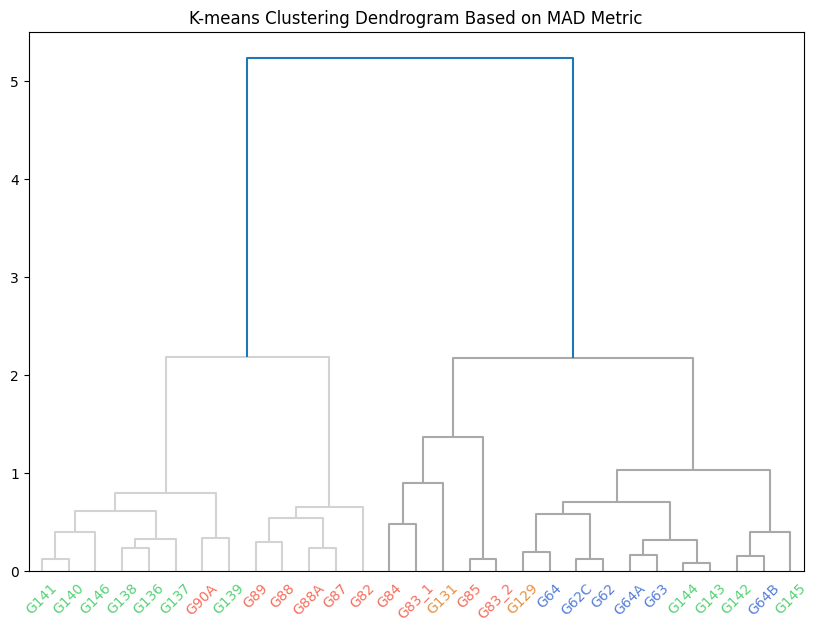

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- t-test ---
     Room  Cluster   Distance
0     G62        2  53.066333
1    G62C        2  51.304055
2     G63        2  15.455747
3     G64        2  38.919239
4    G64A        2  67.246914
5    G64B        2  63.617447
6    G129        2  22.118926
7    G131        2  42.664430
8    G136        0  20.599737
9    G137        0  25.715003
10   G138        0  18.529406
11   G139        0  42.682301
12   G140        0  22.384376
13   G141        1  28.526224
14   G142        1  22.998689
15   G143        1  28.480350
16   G144        1  32.932656
17   G145        1  23.394603
18   G146        0  47.430154
19    G82        0  41.778473
20  G83_1        1  22.199046
21  G83_2        1  29.513590
22    G84        1  46.554969
23    G85        1  31.769356
24    G87        1  30.299402
25    G88        1  26.910388
26   G88A        3  21.234682
27    G89        1  52.117115
28   G90A        3  21.234682



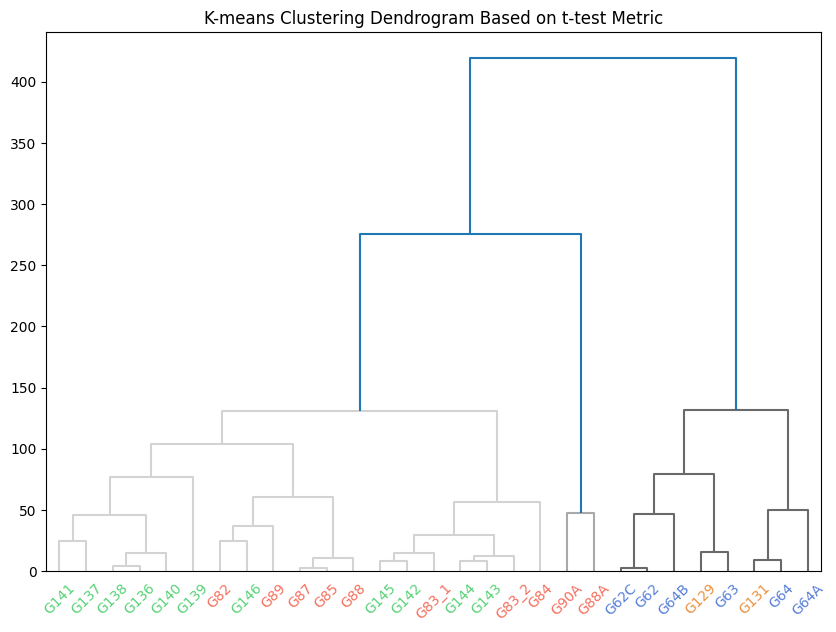

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- F-test ---
     Room  Cluster      Distance
0     G62        2   1667.825013
1    G62C        2   1148.226822
2     G63        1   1985.480705
3     G64        1   1171.078286
4    G64A        1   2681.186993
5    G64B        1   3277.396360
6    G129        1   1626.685311
7    G131        1   1844.706309
8    G136        1   1047.202358
9    G137        1   1614.550501
10   G138        1   4397.932957
11   G139        3   2449.945600
12   G140        3   1242.143604
13   G141        3    664.690450
14   G142        3   1011.749841
15   G143        3   2345.509041
16   G144        3    675.964046
17   G145        0    473.130873
18   G146        0    473.130873
19    G82        1   5242.564513
20  G83_1        2   1505.066943
21  G83_2        2   3538.744851
22    G84        2   1621.690728
23    G85        2  11876.655175
24    G87        2   3872.431129
25    G88        2   4339.497603
26   G88A        2   4162.672270
27    G89        2   1658.036128
28   G90A        2   5217.26

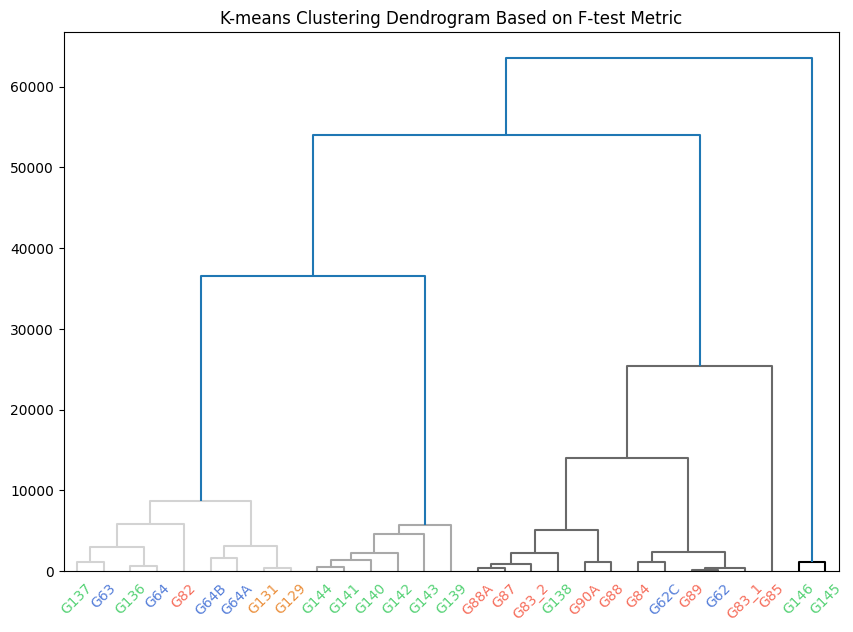

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- EMD ---
     Room  Cluster  Distance
0     G62        3  0.892536
1    G62C        3  1.024531
2     G63        3  1.230250
3     G64        0  2.487119
4    G64A        3  0.994812
5    G64B        1  1.638495
6    G129        3  2.669928
7    G131        0  3.313939
8    G136        2  1.018638
9    G137        1  2.060440
10   G138        2  1.801289
11   G139        2  2.740946
12   G140        2  1.165991
13   G141        2  1.467657
14   G142        1  1.279021
15   G143        3  1.661163
16   G144        3  1.794998
17   G145        3  2.444340
18   G146        2  1.979556
19    G82        2  1.737734
20  G83_1        0  2.196600
21  G83_2        3  0.763100
22    G84        0  1.366694
23    G85        3  1.195008
24    G87        2  1.923314
25    G88        1  1.033446
26   G88A        2  0.884901
27    G89        1  0.837126
28   G90A        2  3.501792



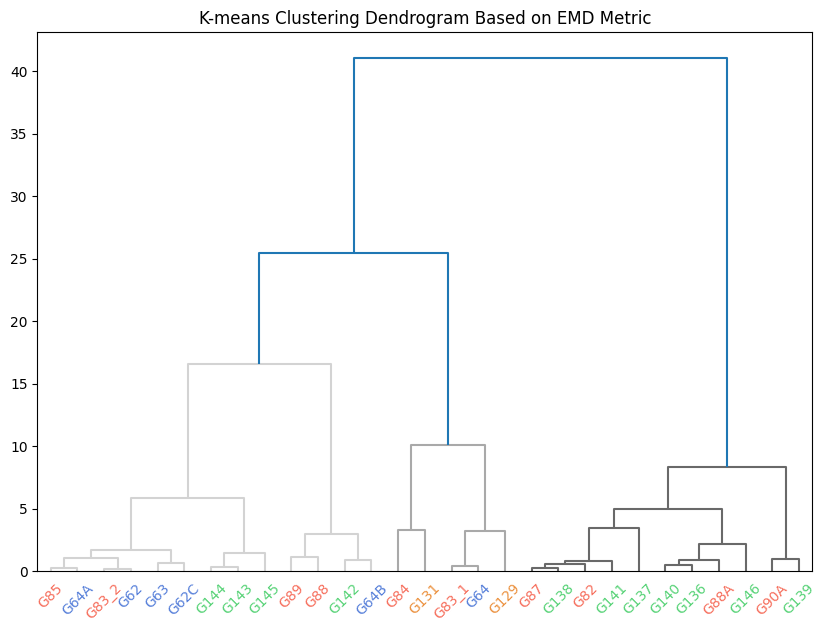

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- Pearson Correlation ---
     Room  Cluster  Distance
0     G62        1  0.170285
1    G62C        1  0.142147
2     G63        1  0.102682
3     G64        1  0.112214
4    G64A        1  0.146943
5    G64B        1  0.102173
6    G129        1  0.118733
7    G131        1  0.096878
8    G136        1  0.101155
9    G137        1  0.154809
10   G138        1  0.172174
11   G139        1  0.137383
12   G140        0  0.138547
13   G141        0  0.067955
14   G142        0  0.050216
15   G143        0  0.057200
16   G144        0  0.130118
17   G145        0  0.111544
18   G146        0  0.105316
19    G82        3  0.089359
20  G83_1        2  0.043859
21  G83_2        2  0.109669
22    G84        2  0.051669
23    G85        2  0.124590
24    G87        2  0.095817
25    G88        3  0.089359
26   G88A        2  0.070546
27    G89        2  0.152810
28   G90A        1  0.223595



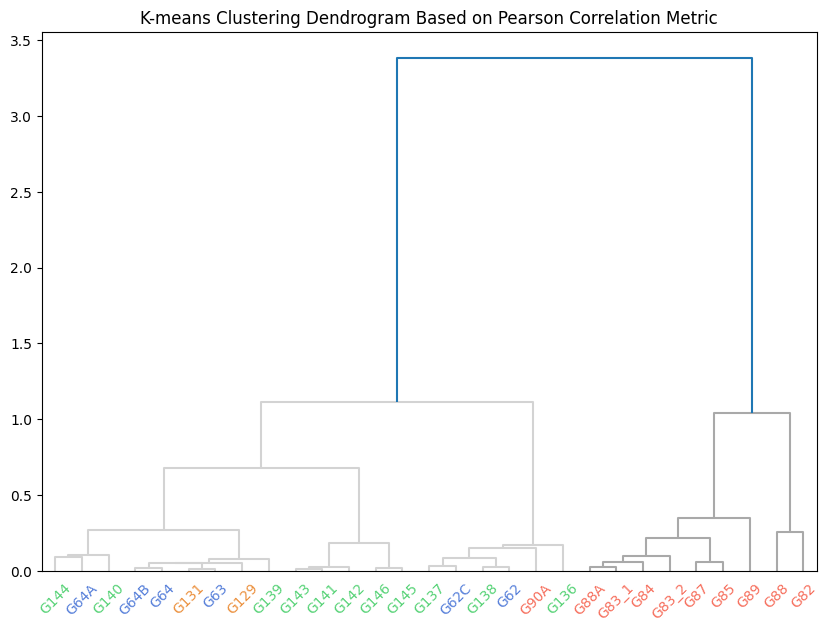

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- DTW Distance ---
     Room  Cluster      Distance
0     G62        2  37968.659837
1    G62C        2  36134.305600
2     G63        2  20347.176452
3     G64        2  33598.177801
4    G64A        2  16188.149493
5    G64B        2  29380.793751
6    G129        2  24299.427789
7    G131        1  45702.236869
8    G136        0  21323.584847
9    G137        0  37766.087442
10   G138        0  31851.588393
11   G139        0  24969.078602
12   G140        0  20422.801378
13   G141        0  23623.962385
14   G142        2  33687.549782
15   G143        2  25009.810552
16   G144        2  21129.957748
17   G145        2  48940.470137
18   G146        0  44140.330335
19    G82        3  32389.545498
20  G83_1        1  15475.702411
21  G83_2        1  34533.627581
22    G84        1  28563.814514
23    G85        1  35383.117716
24    G87        3  22447.999366
25    G88        3  14684.667298
26   G88A        3  18196.304941
27    G89        3  25563.526390
28   G90A        0  34

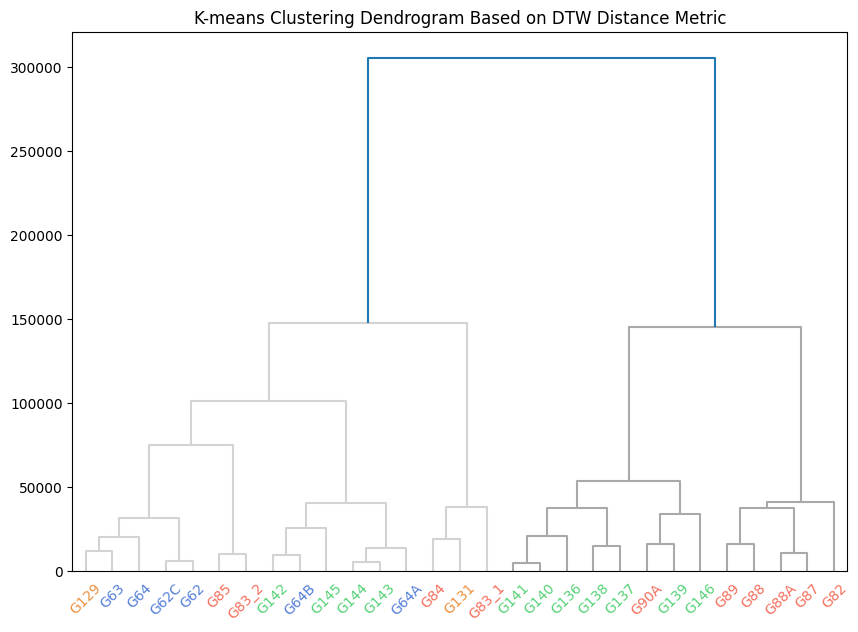

In [ ]:
# prompt: 对各metrix做K-means聚类，并画出K-means聚类树状图，簇为4

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.cluster import AgglomerativeClustering

# 存储结果
kmeans_results = []

for sheet_name, matrix in matrices.items():
  X = matrix.values

  # K-means
  kmeans = KMeans(n_clusters=4, random_state=42)
  labels = kmeans.fit_predict(X)

  # 获取聚类中心
  cluster_centers = kmeans.cluster_centers_

  # 计算每个样本到聚类中心的距离
  distances = kmeans.transform(X)

  # 创建一个新的DataFrame来存储聚类结果和距离
  cluster_df = pd.DataFrame({'Room': rooms, 'Cluster': labels, 'Distance': distances.min(axis=1)})

  # 打印聚类结果
  print(f"--- {sheet_name} ---\n{cluster_df}\n")

  # 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
  set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系
  # 使用层次聚类来可视化K-means聚类结果
  linked = linkage(distances, method='ward')
  plt.figure(figsize=(10, 7))
  dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
              show_leaf_counts=True, color_threshold=0.5*max(linked[:, 2]))
  # 改变聚类标签颜色
  ax = plt.gca()  # 获取当前的轴对象
  x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

  for label in x_labels:
      text = label.get_text()  # 获取标签文本
      if text in colors_dict['one']:
          label.set_color('#557ED9')  # 蓝色
      elif text in colors_dict['two']:
          label.set_color('#EB903D')  # 橙色
      elif text in colors_dict['three']:
          label.set_color('#56D276')  # 绿色
      elif text in colors_dict['four']:
          label.set_color('#F66E5C')  # 红色
  plt.title(f'K-means Clustering Dendrogram Based on {sheet_name} Metric')
  plt.show()



<ipython-input-21-b7c5dd9360df>:8: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(matrix, method='average')


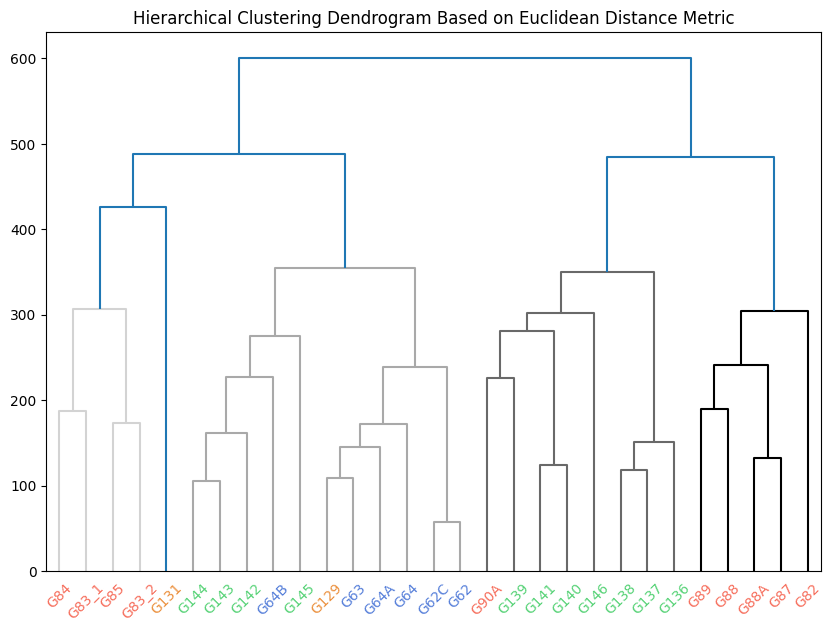

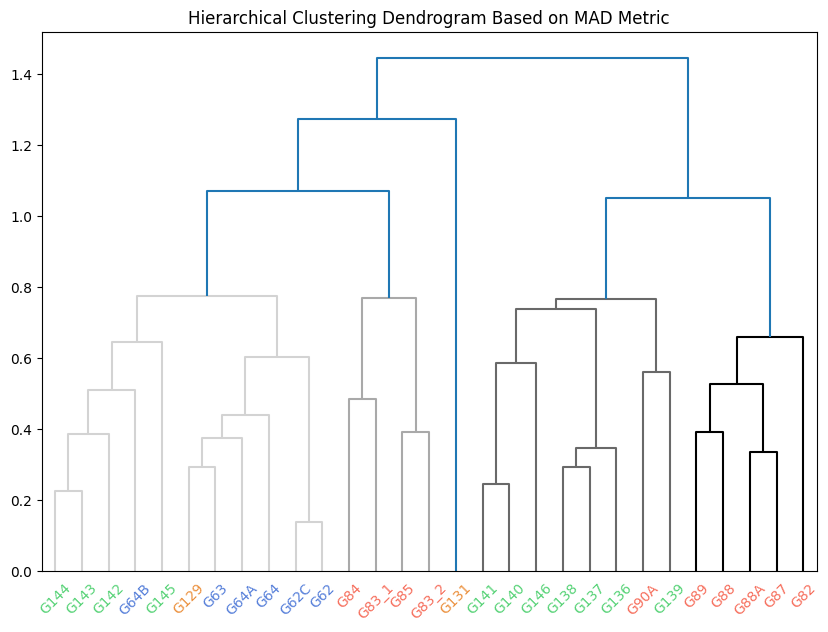

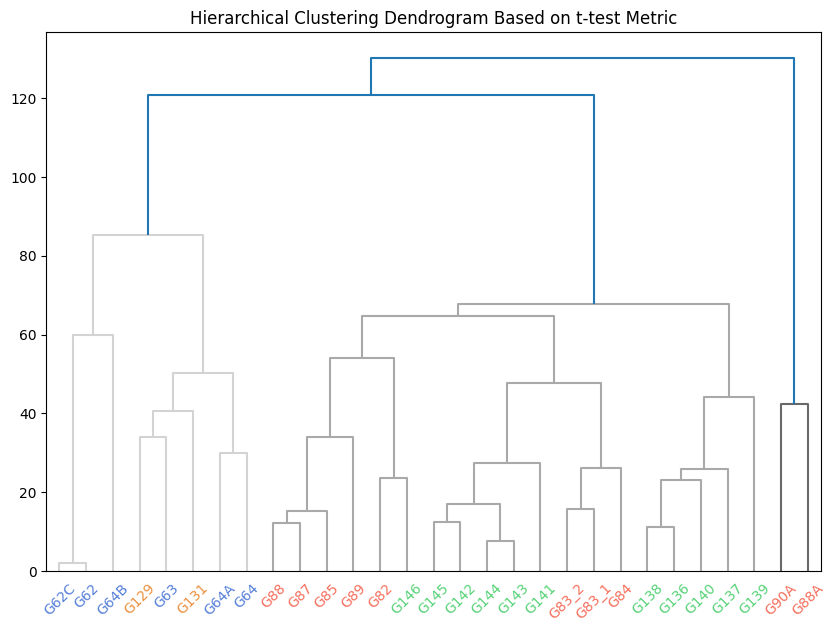

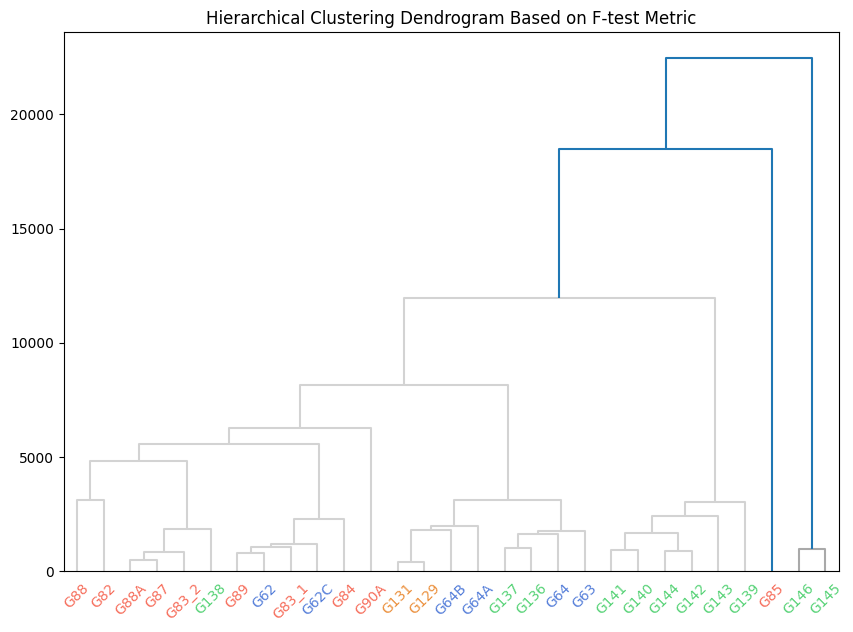

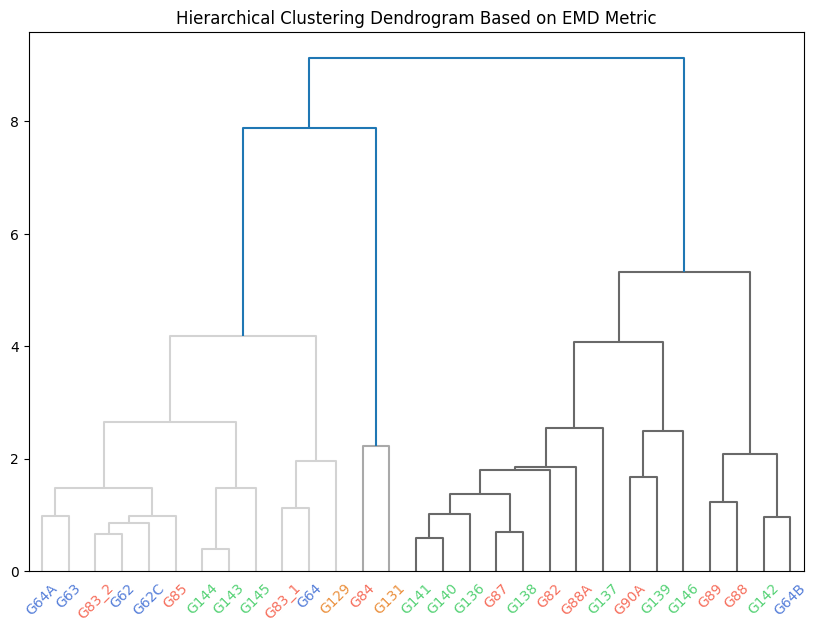

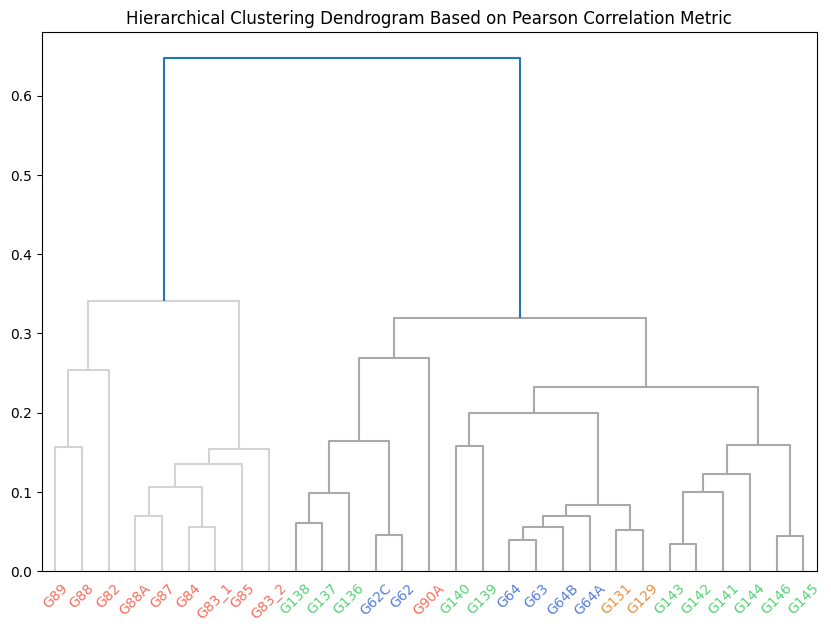

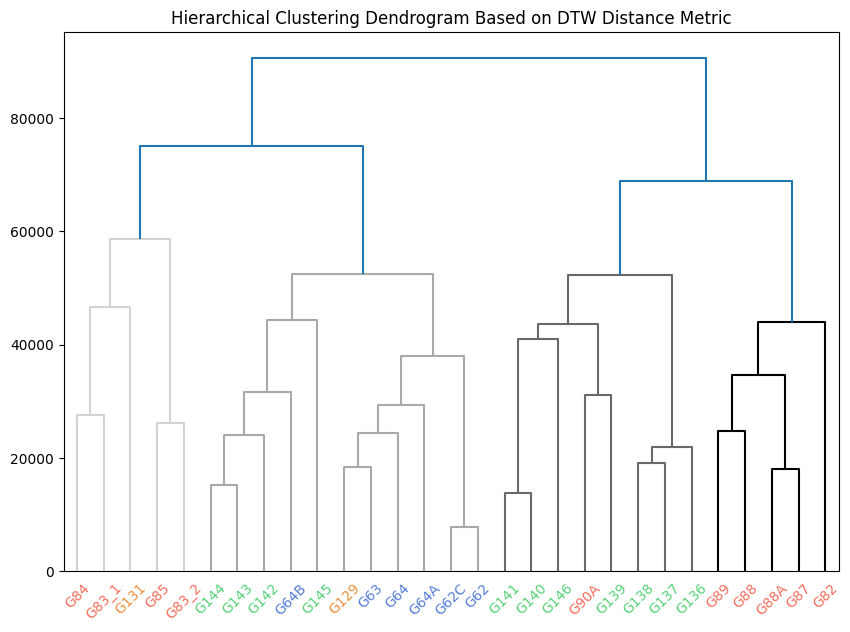

In [ ]:
# prompt: 对各metrix做层次聚类，并画出层次聚类树状图

import matplotlib.pyplot as plt

# 循环遍历每个矩阵
for sheet_name, matrix in matrices.items():
  # 使用层次聚类进行聚类
  linked = linkage(matrix, method='average')

  # 绘制层次聚类树状图
  plt.figure(figsize=(10, 7))
  dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
              show_leaf_counts=True)
   # 改变聚类标签颜色
  ax = plt.gca()  # 获取当前的轴对象
  x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

  for label in x_labels:
      text = label.get_text()  # 获取标签文本
      if text in colors_dict['one']:
          label.set_color('#557ED9')  # 蓝色
      elif text in colors_dict['two']:
          label.set_color('#EB903D')  # 橙色
      elif text in colors_dict['three']:
          label.set_color('#56D276')  # 绿色
      elif text in colors_dict['four']:
          label.set_color('#F66E5C')  # 红色
  plt.title(f'Hierarchical Clustering Dendrogram Based on {sheet_name} Metric')
  plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- Euclidean Distance ---
     Room  Cluster    Distance
0     G62        2  246.420921
1    G62C        2  232.359486
2     G63        2  140.375586
3     G64        2  219.463517
4    G64A        2  106.687938
5    G64B        2  195.484218
6    G129        2  158.808409
7    G131        1  320.338458
8    G136        0  140.878974
9    G137        0  246.832470
10   G138        0  216.313293
11   G139        0  160.904479
12   G140        0  125.274517
13   G141        0  169.857541
14   G142        2  242.755221
15   G143        2  179.355476
16   G144        2  143.510713
17   G145        2  312.026905
18   G146        0  300.748867
19    G82        3  224.560959
20  G83_1        1   99.354682
21  G83_2        1  216.644584
22    G84        1  184.701917
23    G85        1  224.546533
24    G87        3  156.151227
25    G88        3  107.769150
26   G88A        3  132.765712
27    G89        3  175.191125
28   G90A        0  237.896188



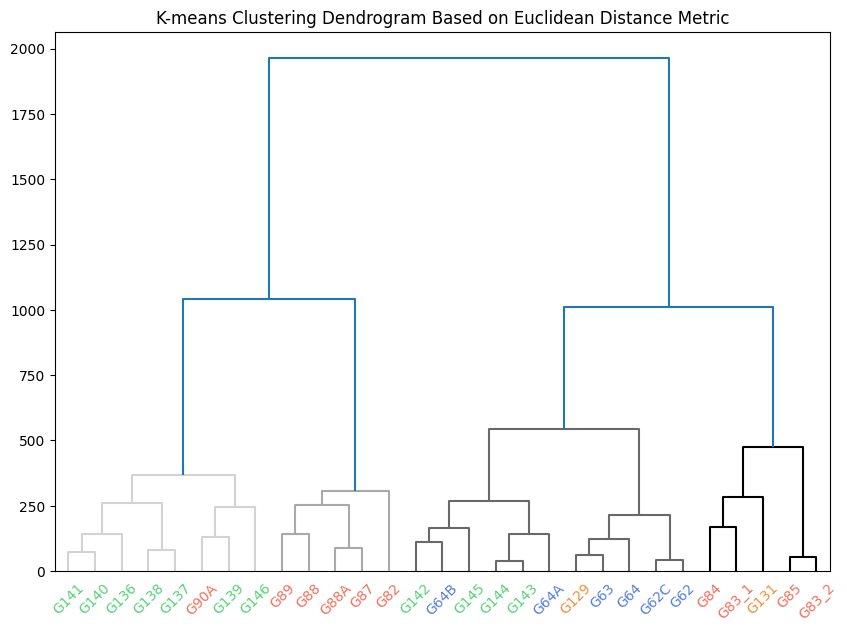

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- MAD ---
     Room  Cluster  Distance
0     G62        1  0.547764
1    G62C        1  0.505504
2     G63        1  0.302379
3     G64        1  0.544544
4    G64A        1  0.267980
5    G64B        1  0.478728
6    G129        1  0.385427
7    G131        2  0.846797
8    G136        0  0.291315
9    G137        0  0.519866
10   G138        0  0.447263
11   G139        0  0.385335
12   G140        0  0.320597
13   G141        0  0.403327
14   G142        1  0.509942
15   G143        1  0.365414
16   G144        1  0.304638
17   G145        1  0.681352
18   G146        0  0.596512
19    G82        3  0.481471
20  G83_1        2  0.228653
21  G83_2        2  0.569606
22    G84        2  0.433836
23    G85        2  0.586620
24    G87        3  0.321921
25    G88        3  0.224306
26   G88A        3  0.283535
27    G89        3  0.413598
28   G90A        0  0.638946



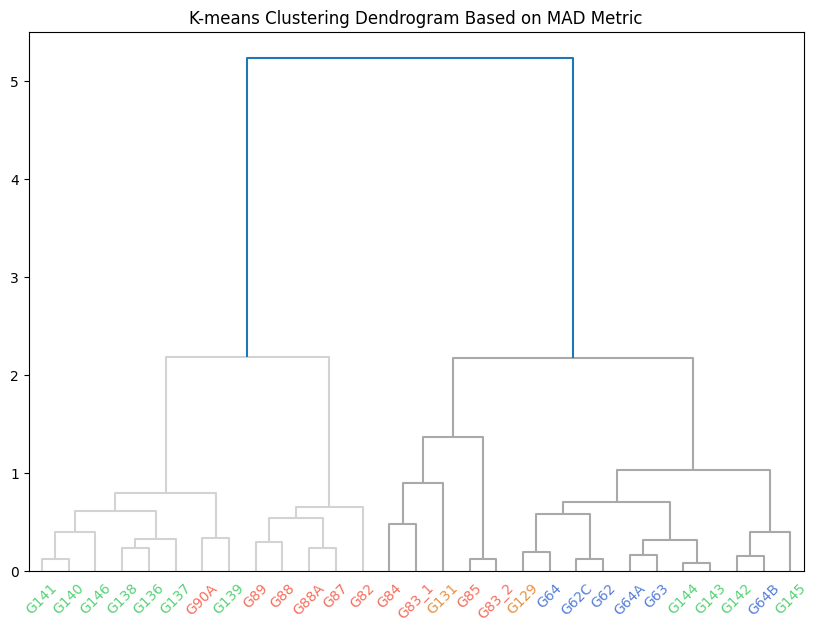

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- EMD ---
     Room  Cluster  Distance
0     G62        3  0.892536
1    G62C        3  1.024531
2     G63        3  1.230250
3     G64        0  2.487119
4    G64A        3  0.994812
5    G64B        1  1.638495
6    G129        3  2.669928
7    G131        0  3.313939
8    G136        2  1.018638
9    G137        1  2.060440
10   G138        2  1.801289
11   G139        2  2.740946
12   G140        2  1.165991
13   G141        2  1.467657
14   G142        1  1.279021
15   G143        3  1.661163
16   G144        3  1.794998
17   G145        3  2.444340
18   G146        2  1.979556
19    G82        2  1.737734
20  G83_1        0  2.196600
21  G83_2        3  0.763100
22    G84        0  1.366694
23    G85        3  1.195008
24    G87        2  1.923314
25    G88        1  1.033446
26   G88A        2  0.884901
27    G89        1  0.837126
28   G90A        2  3.501792



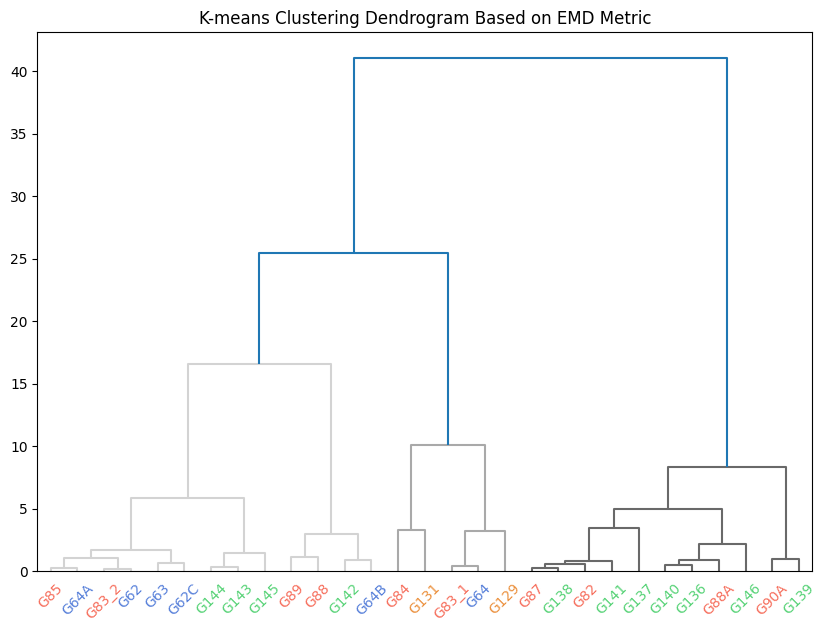

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- Pearson Correlation ---
     Room  Cluster  Distance
0     G62        1  0.170285
1    G62C        1  0.142147
2     G63        1  0.102682
3     G64        1  0.112214
4    G64A        1  0.146943
5    G64B        1  0.102173
6    G129        1  0.118733
7    G131        1  0.096878
8    G136        1  0.101155
9    G137        1  0.154809
10   G138        1  0.172174
11   G139        1  0.137383
12   G140        0  0.138547
13   G141        0  0.067955
14   G142        0  0.050216
15   G143        0  0.057200
16   G144        0  0.130118
17   G145        0  0.111544
18   G146        0  0.105316
19    G82        3  0.089359
20  G83_1        2  0.043859
21  G83_2        2  0.109669
22    G84        2  0.051669
23    G85        2  0.124590
24    G87        2  0.095817
25    G88        3  0.089359
26   G88A        2  0.070546
27    G89        2  0.152810
28   G90A        1  0.223595



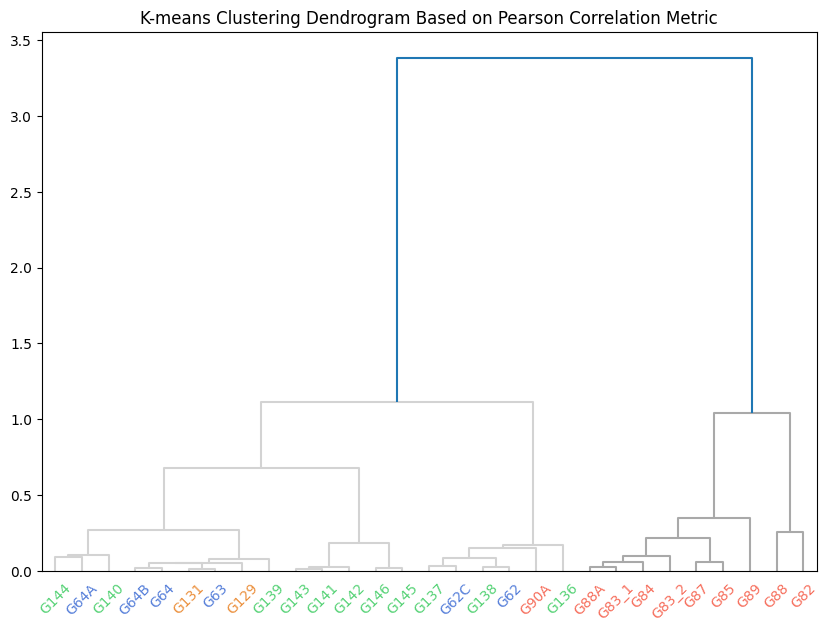

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- DTW Distance ---
     Room  Cluster      Distance
0     G62        2  37968.659837
1    G62C        2  36134.305600
2     G63        2  20347.176452
3     G64        2  33598.177801
4    G64A        2  16188.149493
5    G64B        2  29380.793751
6    G129        2  24299.427789
7    G131        1  45702.236869
8    G136        0  21323.584847
9    G137        0  37766.087442
10   G138        0  31851.588393
11   G139        0  24969.078602
12   G140        0  20422.801378
13   G141        0  23623.962385
14   G142        2  33687.549782
15   G143        2  25009.810552
16   G144        2  21129.957748
17   G145        2  48940.470137
18   G146        0  44140.330335
19    G82        3  32389.545498
20  G83_1        1  15475.702411
21  G83_2        1  34533.627581
22    G84        1  28563.814514
23    G85        1  35383.117716
24    G87        3  22447.999366
25    G88        3  14684.667298
26   G88A        3  18196.304941
27    G89        3  25563.526390
28   G90A        0  34

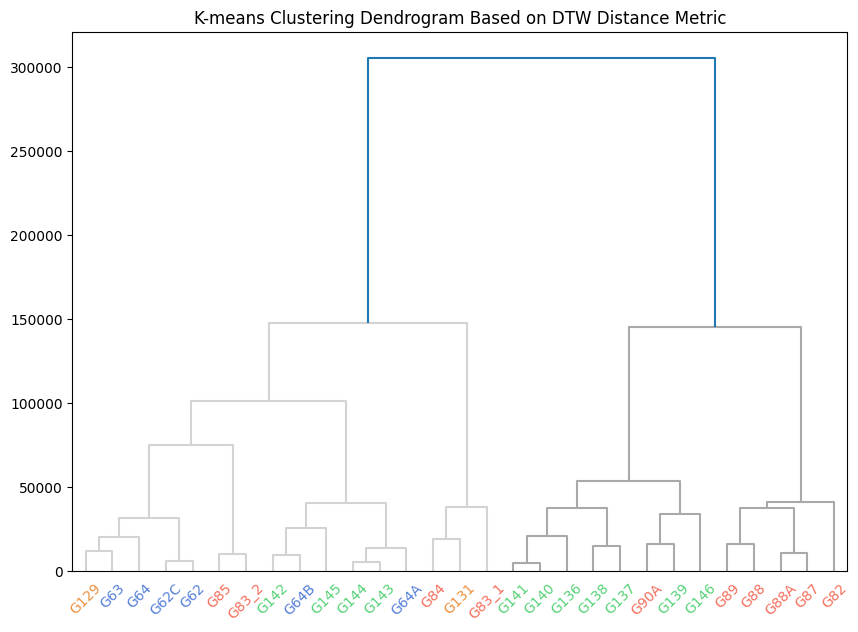

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


--- KS ---
     Room  Cluster  Distance
0     G62        0  0.090710
1    G62C        0  0.077237
2     G63        0  0.131221
3     G64        0  0.157317
4    G64A        3  0.223899
5    G64B        3  0.121476
6    G129        0  0.102360
7    G131        2  0.133200
8    G136        1  0.110574
9    G137        1  0.216160
10   G138        1  0.137584
11   G139        1  0.271015
12   G140        1  0.121912
13   G141        1  0.140078
14   G142        3  0.137031
15   G143        3  0.130367
16   G144        3  0.102973
17   G145        3  0.129885
18   G146        1  0.185816
19    G82        1  0.230249
20  G83_1        2  0.154140
21  G83_2        0  0.127431
22    G84        2  0.084270
23    G85        0  0.184649
24    G87        1  0.202022
25    G88        3  0.164410
26   G88A        1  0.140386
27    G89        3  0.178011
28   G90A        1  0.361910



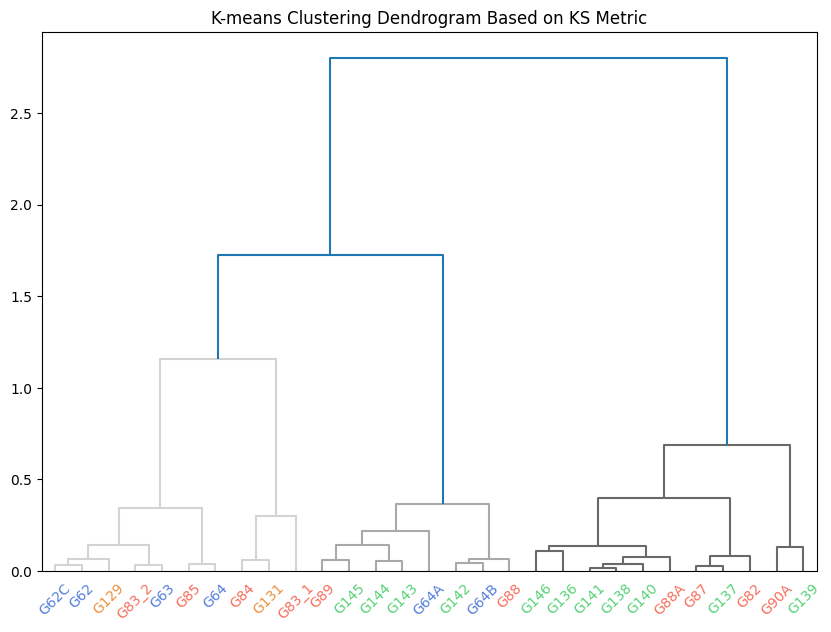

In [ ]:
# prompt: 对各metrix做K-means聚类，并画出K-means聚类树状图，簇为4

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette


# 存储结果
kmeans_results = []

for sheet_name, matrix in matrices.items():
  X = matrix.values

  # K-means
  kmeans = KMeans(n_clusters=4, random_state=42)
  labels = kmeans.fit_predict(X)

  # 获取聚类中心
  cluster_centers = kmeans.cluster_centers_

  # 计算每个样本到聚类中心的距离
  distances = kmeans.transform(X)

  # 创建一个新的DataFrame来存储聚类结果和距离
  cluster_df = pd.DataFrame({'Room': rooms, 'Cluster': labels, 'Distance': distances.min(axis=1)})

  # 打印聚类结果
  print(f"--- {sheet_name} ---\n{cluster_df}\n")

  # 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
  set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系
  # 使用层次聚类来可视化K-means聚类结果
  linked = linkage(distances, method='ward')
  plt.figure(figsize=(10, 7))
  dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
              show_leaf_counts=True, color_threshold=0.5*max(linked[:, 2]))
  # 改变聚类标签颜色
  ax = plt.gca()  # 获取当前的轴对象
  x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

  for label in x_labels:
      text = label.get_text()  # 获取标签文本
      if text in colors_dict['one']:
          label.set_color('#557ED9')  # 蓝色
      elif text in colors_dict['two']:
          label.set_color('#EB903D')  # 橙色
      elif text in colors_dict['three']:
          label.set_color('#56D276')  # 绿色
      elif text in colors_dict['four']:
          label.set_color('#F66E5C')  # 红色
  plt.title(f'K-means Clustering Dendrogram Based on {sheet_name} Metric')
  plt.show()



In [ ]:
matrices_backup=matrices.copy()

In [ ]:
matrices_backup['DTW Distance']

,G62,G62C,G63,G64,G64A,G64B,G129,G131,G136,G137,...,G82,G83_1,G83_2,G84,G85,G87,G88,G88A,G89,G90A
G62,0.000000,3157.156502,11517.292106,16611.083797,18566.494773,16052.971999,13472.677879,24294.388132,26349.447480,20473.930879,...,34463.759765,18833.231335,17401.682875,23382.318858,10802.133740,26822.275407,26715.644600,28763.264348,20718.218995,36028.818213
G62C,3157.156502,0.000000,10298.418041,14643.452084,16984.156357,16025.203172,11975.340100,23506.293818,28179.859429,21310.443823,...,36200.697265,17892.557553,17624.305526,22255.997140,11529.951914,27517.414366,28015.413747,30043.853603,22350.025936,37649.095993
G63,11517.292106,10298.418041,0.000000,8474.470635,7922.167881,12265.003213,6751.153374,22151.987638,25692.186222,20867.210635,...,38180.056108,22954.738024,24155.683714,24685.433842,19862.950697,28052.152135,30904.332987,31696.186012,27009.063398,35254.473827
G64,16611.083797,14643.452084,8474.470635,0.000000,12563.841646,19785.699919,7184.391789,15255.371710,32988.321786,27820.607606,...,43393.553110,22589.418864,26564.832591,21465.131618,23620.300251,33083.217751,36300.397751,37899.523424,32994.847285,42257.483340
G64A,18566.494773,16984.156357,7922.167881,12563.841646,0.000000,11676.251005,11546.150975,26818.851495,23818.316896,20979.180613,...,41669.315838,27279.901415,28435.290927,28960.927252,24713.813055,27987.477921,33107.976116,33334.351416,30490.007425,32377.768789
G64B,16052.971999,16025.203172,12265.003213,19785.699919,11676.251005,0.000000,16550.589962,34070.708664,19122.796312,17290.176701,...,36217.616971,29359.338365,26841.941154,33420.022822,23393.202383,23983.342798,30333.587861,26925.548952,28168.779965,25544.649207
G129,13472.677879,11975.340100,6751.153374,7184.391789,11546.150975,16550.589962,0.000000,17220.299463,30742.929288,24795.130216,...,40554.032520,21286.234253,25268.824744,21439.001994,21329.047631,31402.398348,33350.547548,33872.579087,29267.386905,37606.257960
G131,24294.388132,23506.293818,22151.987638,15255.371710,26818.851495,34070.708664,17220.299463,0.000000,42220.918687,36714.606792,...,49661.250885,25938.230554,29879.353463,19403.364276,28000.702543,42400.559826,41155.883388,44596.373025,36828.551161,52079.958814
G136,26349.447480,28179.859429,25692.186222,32988.321786,23818.316896,19122.796312,30742.929288,42220.918687,0.000000,7931.765481,...,26824.357792,39512.006466,30276.688589,44242.668374,30055.035554,17264.217297,24646.983388,18275.650727,22290.451125,16667.782023
G137,20473.930879,21310.443823,20867.210635,27820.607606,20979.180613,17290.176701,24795.130216,36714.606792,7931.765481,0.000000,...,26033.165263,30969.707254,23045.427802,37671.032200,24635.864569,15898.046125,21968.690838,18085.011266,20179.826686,20346.352320


In [ ]:
# prompt: 把所有matrix做归一化处理，使得所有的值的范围都在0至1之间

import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# 初始化MinMaxScaler
scaler = MinMaxScaler()

# 循环遍历每个矩阵并进行归一化
for sheet_name, matrix in matrices.items():
  # 将矩阵转换为NumPy数组
  matrix_values = matrix.values

  # 对矩阵进行归一化
  normalized_matrix = scaler.fit_transform(matrix_values)

  # 将归一化后的矩阵转换回DataFrame
  matrices[sheet_name] = pd.DataFrame(normalized_matrix, index=matrix.index, columns=matrix.columns)

# 打印每个归一化后的矩阵
for sheet_name, matrix in matrices.items():
  print(f"--- {sheet_name} ---\n{matrix}\n")


--- Euclidean Distance ---
            G62      G62C       G63       G64      G64A      G64B      G129  \
G62    0.000000  0.102799  0.303738  0.380115  0.439625  0.499236  0.321866   
G62C   0.102895  0.000000  0.273191  0.337909  0.416063  0.505543  0.279190   
G63    0.307445  0.276268  0.000000  0.200314  0.208729  0.380585  0.170375   
G64    0.431328  0.383079  0.224562  0.000000  0.272383  0.560798  0.198882   
G64A   0.459440  0.434412  0.215507  0.250862  0.000000  0.409184  0.277980   
G64B   0.456456  0.461792  0.343777  0.451863  0.357985  0.000000  0.397938   
G129   0.348857  0.302320  0.182436  0.189966  0.288296  0.471732  0.000000   
G131   0.630214  0.574415  0.529079  0.347524  0.590312  0.871971  0.375466   
G136   0.703257  0.731467  0.711132  0.777636  0.676204  0.595644  0.733818   
G137   0.568991  0.595488  0.600645  0.664013  0.588007  0.516519  0.620248   
G138   0.608346  0.642908  0.669591  0.744388  0.669286  0.587171  0.696423   
G139   0.921243  0.943653

In [ ]:
matrices['Pearson Correlation']=1-matrices_backup['Pearson Correlation']#数值越小，相似性越大

In [ ]:
import numpy as np

# 示例 t 检验统计量数据
t_values = matrices_backup['t-test']

# 计算绝对值
t_abs = np.abs(t_values)

# 计算最小值和最大值
min_t = np.min(t_abs)
max_t = np.max(t_abs)

# 归一化
t_normalized = (t_abs - min_t) / (max_t - min_t)

# 恢复符号
t_final = np.sign(t_values) * t_normalized

print("原始 t 值:", t_values)
print("归一化后的 t 值:", t_final)


原始 t 值:              G62       G62C        G63        G64       G64A       G64B  \
G62     0.000000   0.076116   9.893460  14.245169  20.548999  -1.473320   
G62C    0.076116   0.000000   9.499017  13.734521  19.925098  -1.938530   
G63     9.893460   9.499017   0.000000   5.384210  10.204731 -12.454621   
G64    14.245169  13.734521   5.384210   0.000000   3.878217 -18.433472   
G64A   20.548999  19.925098  10.204731   3.878217   0.000000 -23.180771   
G64B   -1.473320  -1.938530 -12.454621 -18.433472 -23.180771   0.000000   
G129    8.626589   8.193394  -0.530959  -5.703423 -10.090028  12.063866   
G131   13.454402  12.994076   6.427970   2.000434  -1.559288  19.461464   
G136  -11.201266 -11.591811 -24.402746 -31.014766 -36.915988 -12.137113   
G137   -6.934737  -7.296736 -19.168877 -25.267331 -31.039213  -7.078032   
G138  -10.624590 -10.885264 -23.581351 -29.585198 -36.140636 -11.974344   
G139  -17.392979 -17.842442 -30.588956 -37.350583 -42.896925 -18.319244   
G140   -9.634403 

In [ ]:
matrices['t-test']=np.abs(t_final)
matrices['t-test']

,G62,G62C,G63,G64,G64A,G64B,G129,G131,G136,G137,...,G82,G83_1,G83_2,G84,G85,G87,G88,G88A,G89,G90A
G62,0.000000,0.001342,0.174422,0.251143,0.362280,0.025975,0.152087,0.237202,0.197479,0.122260,...,0.177005,0.050055,0.029240,0.026733,0.145847,0.079748,0.068362,0.359738,0.167473,0.468388
G62C,0.001342,0.000000,0.167468,0.242141,0.351281,0.034176,0.144450,0.229087,0.204364,0.128642,...,0.177952,0.052460,0.026374,0.022231,0.145129,0.084253,0.068840,0.363366,0.169304,0.477056
G63,0.174422,0.167468,0.000000,0.094924,0.179910,0.219576,0.009361,0.113326,0.430222,0.337949,...,0.380365,0.195236,0.143762,0.099855,0.318139,0.309922,0.265862,0.591291,0.372947,0.747936
G64,0.251143,0.242141,0.094924,0.000000,0.068373,0.324983,0.100552,0.035268,0.546793,0.445465,...,0.456269,0.267512,0.222252,0.172884,0.391995,0.414765,0.339925,0.694101,0.460911,0.898112
G64A,0.362280,0.351281,0.179910,0.068373,0.000000,0.408679,0.177888,0.027490,0.650832,0.547224,...,0.589220,0.360836,0.328826,0.248623,0.508517,0.533940,0.472586,0.815521,0.582892,1.000000
G64B,0.025975,0.034176,0.219576,0.324983,0.408679,0.000000,0.212687,0.343107,0.213978,0.124786,...,0.214979,0.029101,0.056494,0.137084,0.104332,0.111825,0.095062,0.388971,0.172968,0.492303
G129,0.152087,0.144450,0.009361,0.100552,0.177888,0.212687,0.000000,0.124242,0.421391,0.327637,...,0.359519,0.170248,0.124003,0.078710,0.288594,0.297980,0.243621,0.574676,0.351928,0.739769
G131,0.237202,0.229087,0.113326,0.035268,0.027490,0.343107,0.124242,0.000000,0.548553,0.448162,...,0.423933,0.267414,0.213983,0.190656,0.370951,0.403835,0.308396,0.676687,0.441268,0.902981
G136,0.197479,0.204364,0.430222,0.546793,0.650832,0.213978,0.421391,0.548553,0.000000,0.082173,...,0.064001,0.206513,0.232694,0.327655,0.061447,0.085732,0.058779,0.202646,0.003010,0.245324
G137,0.122260,0.128642,0.337949,0.445465,0.547224,0.124786,0.327637,0.448162,0.082173,0.000000,...,0.119723,0.120464,0.156418,0.231284,0.014930,0.011222,0.000258,0.273532,0.068668,0.338615


In [ ]:
# prompt: 对各metrix做K-means聚类，并画出K-means聚类树状图，簇为4

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score, normalized_mutual_info_score, calinski_harabasz_score

true_labels=[0,0,0,0,0,0,1,1,2,2,2,2,2,2,2,2,2,2,2,3,3,3,3,3,3,3,3,3,3]
# 存储结果
kmeans_results = []

for sheet_name, matrix in matrices.items():
  X = matrix.values

  # K-means
  kmeans = KMeans(n_clusters=4, random_state=42)
  labels = kmeans.fit_predict(X)

  # 获取聚类中心
  cluster_centers = kmeans.cluster_centers_

  # 计算每个样本到聚类中心的距离
  distances = kmeans.transform(X)

  # 创建一个新的DataFrame来存储聚类结果和距离
  cluster_df = pd.DataFrame({'Room': rooms, 'Cluster': labels, 'Distance': distances.min(axis=1)})

  # 打印聚类结果
  print(f"--- {sheet_name} ---\n{cluster_df}\n")

  # 3. 计算调整后的兰德指数（需要真实标签）
  ari_score = adjusted_rand_score(true_labels, labels)

  # 4. 计算归一化互信息（需要真实标签）
  nmi_score = normalized_mutual_info_score(true_labels, labels)

  # 5. 计算 Calinski-Harabasz 指数
  ch_score = calinski_harabasz_score(X, labels)

  print(f"Adjusted Rand Index (ARI): {ari_score}")
  print(f"Normalized Mutual Information (NMI): {nmi_score}")
  print(f"Calinski-Harabasz Index: {ch_score}")

  # 设置链接颜色的调色板，使用相同色系的颜色（例如不同深浅的蓝色）
  set_link_color_palette(['#D3D3D3','#A9A9A9',  '#696969','#000000'])  # 灰色系
  # 使用层次聚类来可视化K-means聚类结果
  linked = linkage(distances, method='ward')
  plt.figure(figsize=(10, 7))
  dendrogram(linked, labels=rooms, orientation='top', distance_sort='descending',
              show_leaf_counts=True, color_threshold=0.5*max(linked[:, 2]))
  # 改变聚类标签颜色
  ax = plt.gca()  # 获取当前的轴对象
  x_labels = ax.get_xmajorticklabels()  # 获取x轴上的标签

  for label in x_labels:
      text = label.get_text()  # 获取标签文本
      if text in colors_dict['one']:
          label.set_color('#557ED9')  # 蓝色
      elif text in colors_dict['two']:
          label.set_color('#EB903D')  # 橙色
      elif text in colors_dict['three']:
          label.set_color('#56D276')  # 绿色
      elif text in colors_dict['four']:
          label.set_color('#F66E5C')  # 红色
  plt.title(f'K-means Clustering Dendrogram Based on {sheet_name} Metric')
  plt.show()



--- Euclidean Distance ---
     Room  Cluster    Distance
0     G62        2  246.420921
1    G62C        2  232.359486
2     G63        2  140.375586
3     G64        2  219.463517
4    G64A        2  106.687938
5    G64B        2  195.484218
6    G129        2  158.808409
7    G131        1  320.338458
8    G136        0  140.878974
9    G137        0  246.832470
10   G138        0  216.313293
11   G139        0  160.904479
12   G140        0  125.274517
13   G141        0  169.857541
14   G142        2  242.755221
15   G143        2  179.355476
16   G144        2  143.510713
17   G145        2  312.026905
18   G146        0  300.748867
19    G82        3  224.560959
20  G83_1        1   99.354682
21  G83_2        1  216.644584
22    G84        1  184.701917
23    G85        1  224.546533
24    G87        3  156.151227
25    G88        3  107.769150
26   G88A        3  132.765712
27    G89        3  175.191125
28   G90A        0  237.896188

Adjusted Rand Index (ARI): 0.3568242640499

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


NameError: name 'set_link_color_palette' is not defined

In [ ]:
matrices

{'Euclidean Distance':               G62        G62C         G63         G64        G64A        G64B  \
 G62      0.000000   26.757241   79.949352  112.164468  119.474926  118.698749   
 G62C    26.757241    0.000000   71.908820   99.710329  113.071674  120.198322   
 G63     79.949352   71.908820    0.000000   59.108607   56.725288   90.488271   
 G64    112.164468   99.710329   59.108607    0.000000   74.024431  133.335768   
 G64A   119.474926  113.071674   56.725288   74.024431    0.000000   97.288041   
 G64B   118.698749  120.198322   90.488271  133.335768   97.288041    0.000000   
 G129    90.718238   78.690031   48.020405   56.055110   78.348890  112.159347   
 G131   163.883717  149.512769  139.263021  102.547391  160.426646  207.320672   
 G136   182.878133  190.391265  187.182703  229.464877  183.768980  141.620955   
 G137   147.963080  154.997729  158.100622  195.937079  159.800256  122.808068   
 G138   158.197091  167.340543  176.248266  219.654078  181.889029  139.6062

In [ ]:
matrices['M-W U']=u_matrix

In [ ]:
list(matrices.keys())

['Euclidean Distance',
 'MAD',
 'EMD',
 'Pearson Correlation',
 'DTW Distance',
 'Kru',
 'M-W U']

In [ ]:
del matrices['Kru']


In [ ]:
# prompt: 输出以上结果至excel
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score, normalized_mutual_info_score, calinski_harabasz_score

true_labels=[0,0,0,0,0,0,1,1,2,2,2,2,2,2,2,2,2,2,2,3,3,3,3,3,3,3,3,3,3]
import pandas as pd
# 存储结果
kmeans_results = []

for sheet_name, matrix in matrices.items():
  X = matrix.values

  # K-means
  kmeans = KMeans(n_clusters=4, random_state=42)
  labels = kmeans.fit_predict(X)

  # 获取聚类中心
  cluster_centers = kmeans.cluster_centers_

  # 计算每个样本到聚类中心的距离
  distances = kmeans.transform(X)

  # 创建一个新的DataFrame来存储聚类结果和距离
  cluster_df = pd.DataFrame({'Room': rooms, 'Cluster': labels, 'Distance': distances.min(axis=1)})
  # 1. 计算轮廓系数
  sil_score = silhouette_score(X, labels)

  # 2. 计算戴维森堡丁指数
  dbi_score = davies_bouldin_score(X, labels)

  # 3. 计算调整后的兰德指数（需要真实标签）
  ari_score = adjusted_rand_score(true_labels, labels)

  # 4. 计算归一化互信息（需要真实标签）
  nmi_score = normalized_mutual_info_score(true_labels, labels)

  # 5. 计算 Calinski-Harabasz 指数
  ch_score = calinski_harabasz_score(X, labels)

  kmeans_results.append([sheet_name,sil_score,dbi_score, ari_score, nmi_score, ch_score])

# 创建结果DataFrame
kmeans_df = pd.DataFrame(kmeans_results, columns=['Method','Silhouette Score','DBI', 'ARI', 'NMI', 'Calinski-Harabasz'])

# 输出结果到Excel
with pd.ExcelWriter('kmeans_evaluation_results.xlsx') as writer:
  kmeans_df.to_excel(writer, sheet_name='K-means', index=False)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

In [ ]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
for sheet_name, matrix in matrices.items():
# 生成示例数据
    X=matrix.values
    print(sheet_name)
    # 应用K-means聚类
    kmeans = KMeans(n_clusters=4, random_state=42)
    labels = kmeans.fit_predict(X)

    # 计算轮廓系数
    silhouette_avg = silhouette_score(X, labels)
    print(f"轮廓系数 (Silhouette Coefficient): {silhouette_avg}")

    # 计算戴维森堡丁指数 (DBI)
    dbi_score = davies_bouldin_score(X, labels)
    print(f"戴维森堡丁指数 (DBI): {dbi_score}")


Euclidean Distance
轮廓系数 (Silhouette Coefficient): 0.35427697778741435
戴维森堡丁指数 (DBI): 0.9493886877905671
MAD
轮廓系数 (Silhouette Coefficient): 0.3531829899037285
戴维森堡丁指数 (DBI): 0.9939269374742585
t-test
轮廓系数 (Silhouette Coefficient): 0.5259824456157776
戴维森堡丁指数 (DBI): 0.5435256043220156
F-test
轮廓系数 (Silhouette Coefficient): 0.5121245168751851
戴维森堡丁指数 (DBI): 0.5121677620217358
EMD
轮廓系数 (Silhouette Coefficient): 0.4760300312500185
戴维森堡丁指数 (DBI): 0.6319117852520089
Pearson Correlation
轮廓系数 (Silhouette Coefficient): 0.45345418954716554
戴维森堡丁指数 (DBI): 0.6570357782471739
DTW Distance
轮廓系数 (Silhouette Coefficient): 0.3587399180605242
戴维森堡丁指数 (DBI): 0.9436243754459697


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

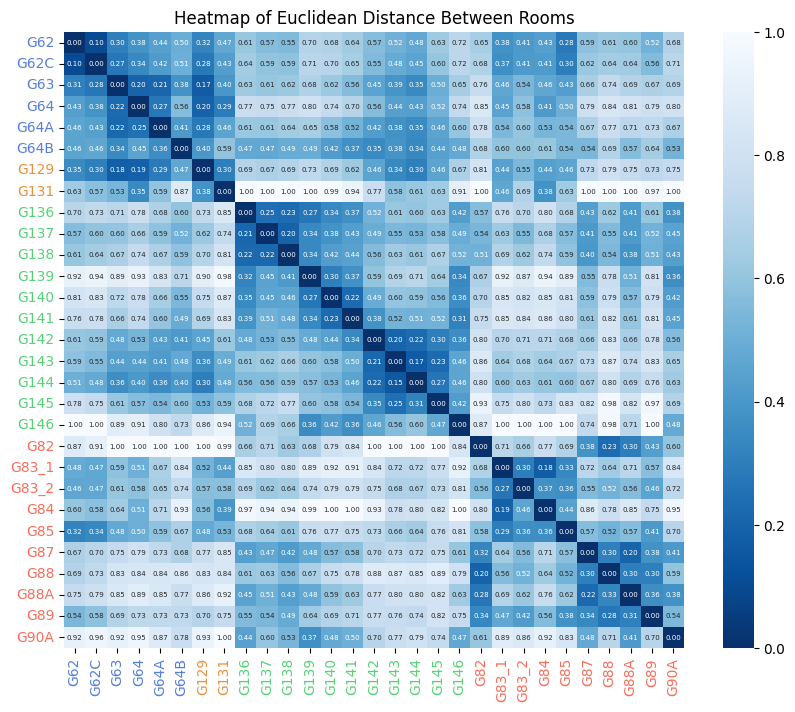

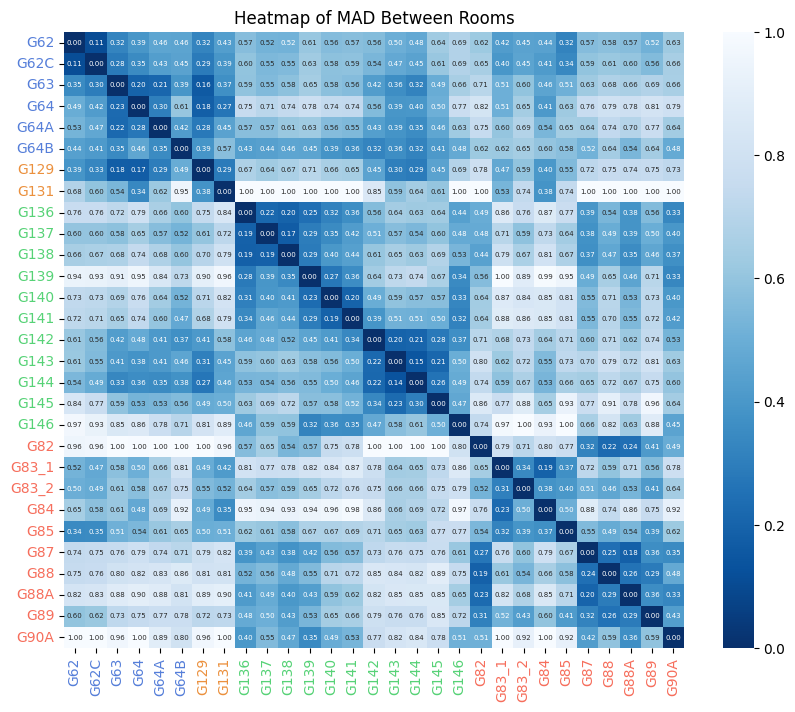

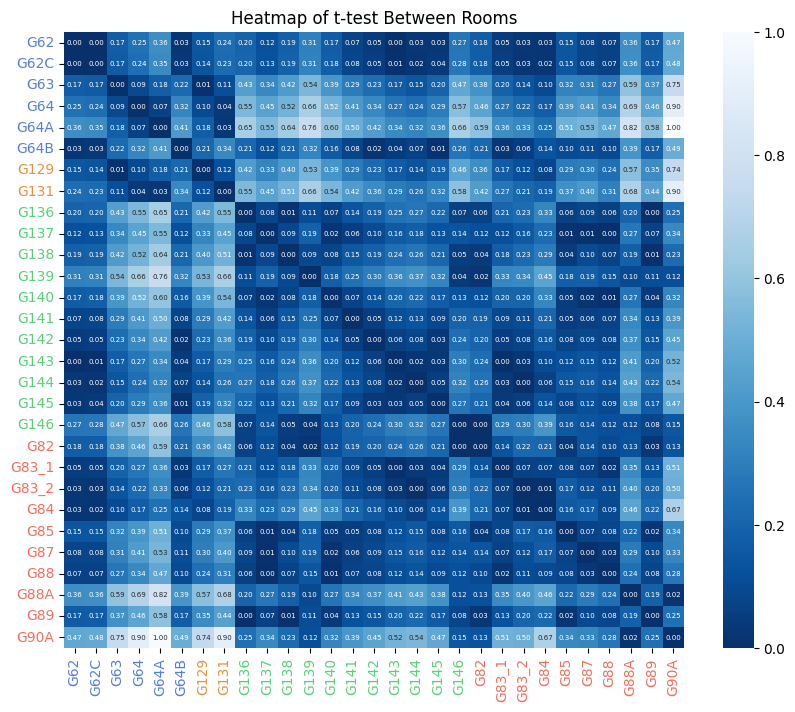

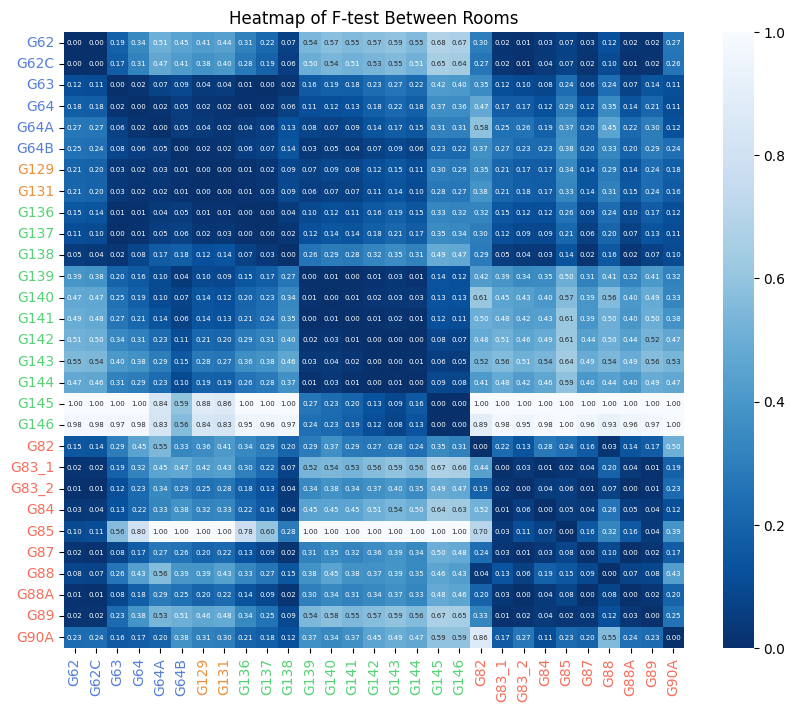

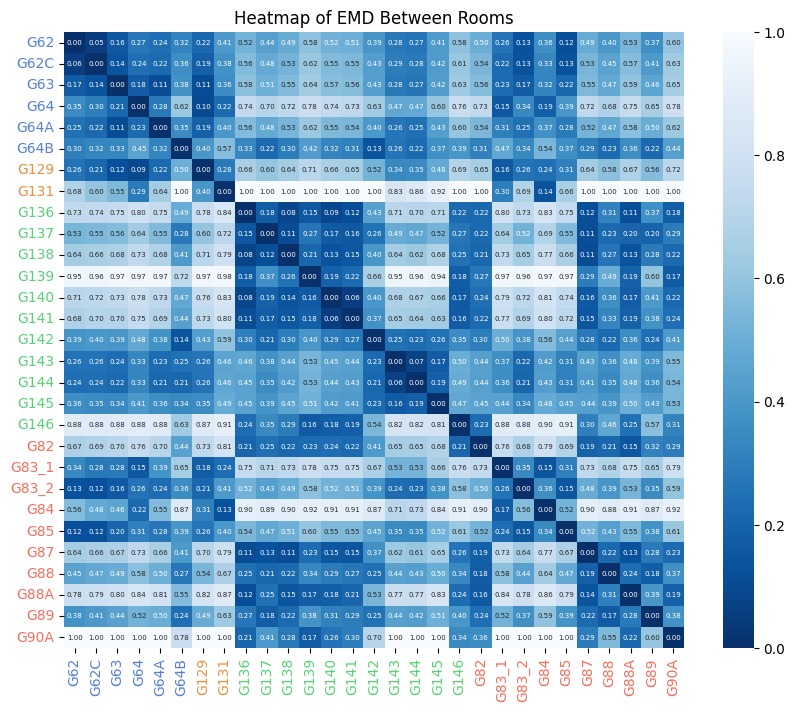

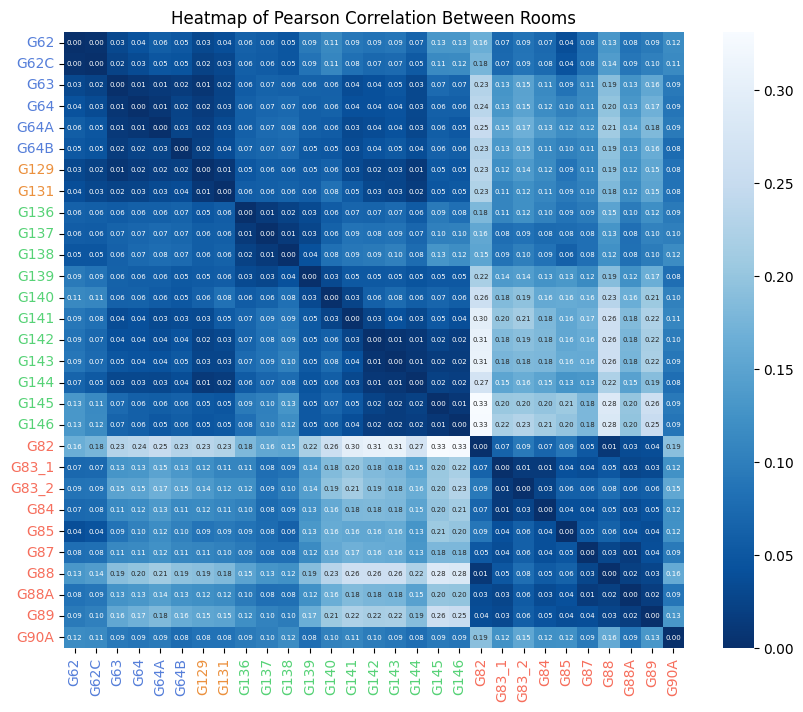

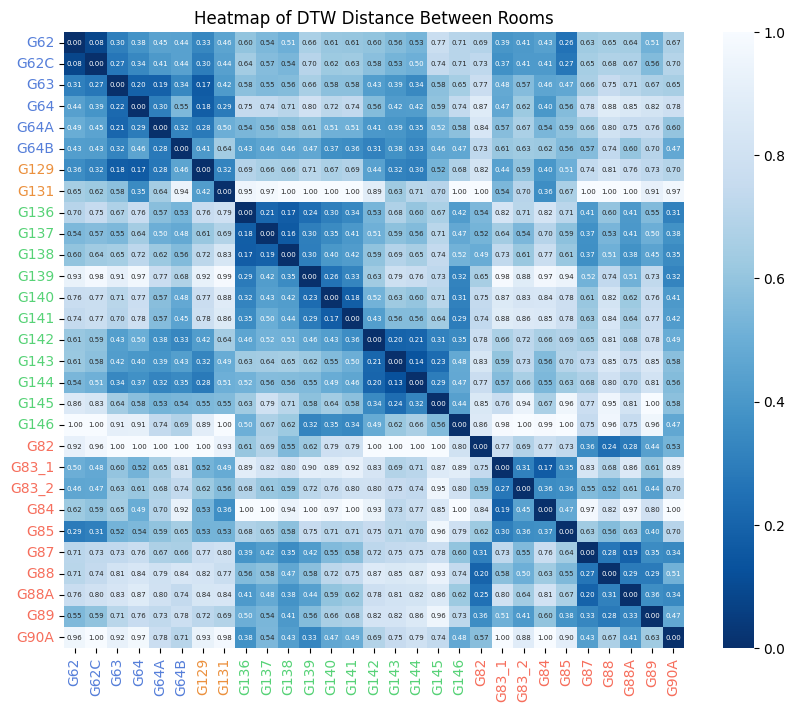

In [ ]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette
# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}

for sheet_name, matrix in matrices.items():
  # 绘制聚类热力图
  plt.figure(figsize=(10, 8))
  ax=sns.heatmap(matrix.astype(float), annot=True,annot_kws={"size": 5},fmt=".2f", cmap='Blues_r',
              xticklabels=rooms, yticklabels=rooms)
  # 遍历标签，赋予颜色
  for label in ax.get_xticklabels():
      text = label.get_text()
      if text in colors_dict['one']:
          label.set_color('#557ED9')  # Red color
      elif text in colors_dict['two']:
          label.set_color('#EB903D')  # Blue color
      elif text in colors_dict['three']:
          label.set_color('#56D276')  # Green color
      elif text in colors_dict['four']:
          label.set_color('#F66E5C')  # Yellow color
  # 遍历标签，赋予颜色
  for label in ax.get_yticklabels():
      text = label.get_text()
      if text in colors_dict['one']:
          label.set_color('#557ED9')  # Red color
      elif text in colors_dict['two']:
          label.set_color('#EB903D')  # Blue color
      elif text in colors_dict['three']:
          label.set_color('#56D276')  # Green color
      elif text in colors_dict['four']:
          label.set_color('#F66E5C')  # Yellow color
  plt.title(f'Heatmap of {sheet_name} Between Rooms')
  plt.show()

In [ ]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score, normalized_mutual_info_score, calinski_harabasz_score

# 假设 X 是你的数据，labels 是聚类算法生成的标签，true_labels 是真实标签

# 1. 计算轮廓系数
sil_score = silhouette_score(X, labels)

# 2. 计算戴维森堡丁指数
dbi_score = davies_bouldin_score(X, labels)

# 3. 计算调整后的兰德指数（需要真实标签）
ari_score = adjusted_rand_score(true_labels, labels)

# 4. 计算归一化互信息（需要真实标签）
nmi_score = normalized_mutual_info_score(true_labels, labels)

# 5. 计算 Calinski-Harabasz 指数
ch_score = calinski_harabasz_score(X, labels)

print(f"Silhouette Coefficient: {sil_score}")
print(f"Davies-Bouldin Index: {dbi_score}")
print(f"Adjusted Rand Index (ARI): {ari_score}")
print(f"Normalized Mutual Information (NMI): {nmi_score}")
print(f"Calinski-Harabasz Index: {ch_score}")


In [ ]:
# prompt: 从matrices中去掉t-test和F-test两个矩阵
matrices_backup=matrices.copy()
del matrices['t-test']
del matrices['F-test']


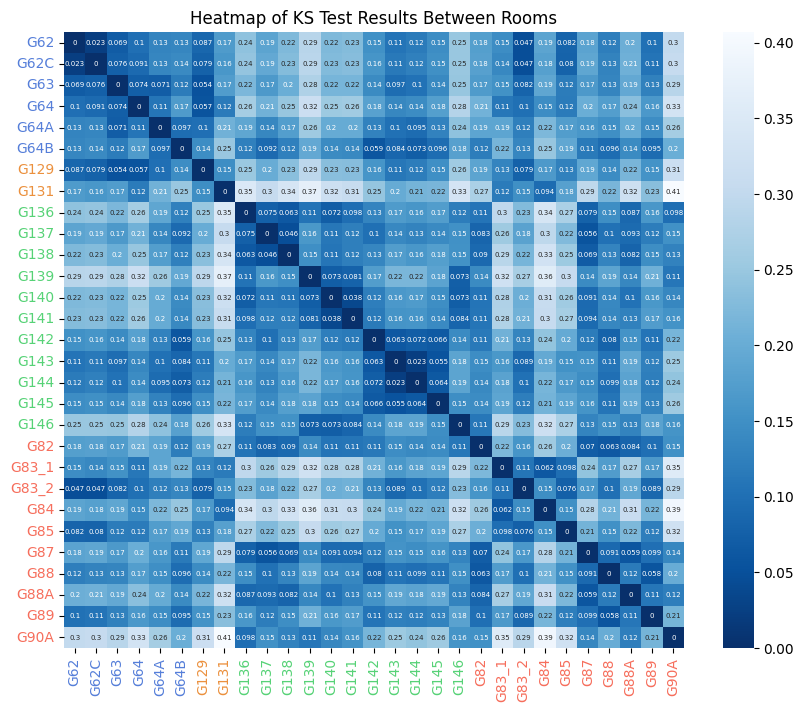

In [ ]:
from matplotlib.colors import LinearSegmentedColormap, TwoSlopeNorm
# 温度
import numpy as np
from scipy import stats
from scipy.stats import wasserstein_distance
from scipy.stats import mannwhitneyu

# 初始化 CS 矩阵
t_matrix = pd.DataFrame(index=sheets, columns=sheets)
tt_matrix = pd.DataFrame(index=sheets, columns=sheets)
F_matrix = pd.DataFrame(index=sheets, columns=sheets)
Ft_matrix = pd.DataFrame(index=sheets, columns=sheets)
emd_matrix = pd.DataFrame(index=sheets, columns=sheets)
kru_matrix = pd.DataFrame(index=sheets, columns=sheets)
u_matrix = pd.DataFrame(index=sheets, columns=sheets)
ks_matrix = pd.DataFrame(index=sheets, columns=sheets)
# 遍历每个房间对
for i in range(len(sheets)):
    for j in range(i, len(sheets)):
        room1 = sheets[i]
        room2 = sheets[j]
        data1 = data[room1].iloc[:,0]
        data2 = data[room2].iloc[:,0]
        data3 = data[room1].iloc[:,1]
        data4 = data[room2].iloc[:,1]
        data5 = data[room1].iloc[:,2]
        data6 = data[room2].iloc[:,2]

        # 执行独立样本 t 检验
        t_statistic_T, p_value_T = stats.ttest_ind(data1, data2, equal_var=True)
        t_statistic_RH, p_value_RH = stats.ttest_ind(data3, data4, equal_var=True)
        t_statistic_AH, p_value_AH = stats.ttest_ind(data5, data6, equal_var=True)
        #t_statistic= (t_statistic_T+t_statistic_RH+t_statistic_AH)/3
        t_statistic= t_statistic_RH
        p_value= (p_value_T+p_value_RH+p_value_AH)/3


        # 输出结果
        #print(f"T-statistic: {t_statistic}")
        #print(f"P-value: {p_value}")

        # 解释结果
        #alpha = 0.05
       # if p_value < alpha:
            #print("结果显著：两个房间的温度均值存在显著差异。")
            #t_matrix.loc[room1,room2]=1 #显著不同
           # t_matrix.loc[room2,room1]=1 #显著不同
        #else:
            #print("结果不显著：两个房间的温度均值没有显著差异。")
         #   t_matrix.loc[room1,room2]=0 #非常相似
          #  t_matrix.loc[room2,room1]=0 #非常相似
        tt_matrix.loc[room1,room2]=t_statistic
        tt_matrix.loc[room2,room1]=tt_matrix.loc[room1,room2]

        # 进行方差分析
        #f_value, p_value = stats.f_oneway(data1,data2)

        # 进行F检验
        f_stat_T, p_value_T = stats.levene(data1, data2, center='mean')
        f_stat_RH, p_value_RH = stats.levene(data3, data4, center='mean')
        f_stat_AH, p_value_AH = stats.levene(data5, data6, center='mean')
        #f_stat=(f_stat_T+f_stat_RH+f_stat_AH)/3
        f_stat=f_stat_RH
        p_value=(p_value_T+p_value_RH+p_value_AH)/3


        #print(f'F-Statistic: {f_value}')
        #print(f'P-Value: {p_value}')

        #if p_value < 0.05:
            #print("结果显著：两个房间的温度方差存在显著差异。")
         #   F_matrix.loc[room1,room2]=1 #显著不同

        #else:
            #print("结果不显著：两个房间的温度方差没有显著差异。")
         #   F_matrix.loc[room1,room2]=0 #非常相似
        #F_matrix.loc[room2,room1]=F_matrix.loc[room1,room2]


        Ft_matrix.loc[room1,room2]=f_stat
        Ft_matrix.loc[room2,room1]=Ft_matrix.loc[room1,room2]



        kruskal_stat_T, p_value_T = stats.kruskal(data1, data2)
        kruskal_stat_RH, p_value_RH = stats.kruskal(data3, data4)
        kruskal_stat_AH, p_value_AH = stats.kruskal(data5, data6)
        kruskal_stat=(kruskal_stat_T+kruskal_stat_RH+kruskal_stat_AH)/3
        #kruskal_stat=kruskal_stat_RH
        kru_matrix.loc[room1,room2]=kruskal_stat
        kru_matrix.loc[room2,room1]=kru_matrix.loc[room1,room2]

        u_statistic_T, p_value_T = mannwhitneyu(data1, data2)
        u_statistic_RH, p_value_RH = mannwhitneyu(data3, data4)
        u_statistic_AH, p_value_AH = mannwhitneyu(data5, data6)
        u_statistic=(u_statistic_T+u_statistic_RH+u_statistic_AH)/3
        #u_statistic=u_statistic_RH
        u_matrix.loc[room1,room2]=u_statistic
        u_matrix.loc[room2,room1]=u_matrix.loc[room1,room2]

        ks_statistic_T, p_value_T = stats.ks_2samp(data1, data2)

        ks_statistic_RH, p_value_RH = stats.ks_2samp(data3, data4)

        ks_statistic_AH, p_value_AH = stats.ks_2samp(data5, data6)
        ks_statistic=(ks_statistic_T+ks_statistic_RH+ks_statistic_AH)/3
        #ks_statistic=ks_statistic_RH
        ks_matrix.loc[room1,room2]=ks_statistic
        ks_matrix.loc[room2,room1]=ks_matrix.loc[room1,room2]


        #
        emd_distance_T = wasserstein_distance(data1, data2)
        emd_distance_RH = wasserstein_distance(data3, data4)
        emd_distance_AH = wasserstein_distance(data5, data6)
        #emd_distance=(emd_distance_T+emd_distance_RH+emd_distance_AH)/3
        emd_distance=emd_distance_T


        emd_matrix.loc[room1,room2]=emd_distance
        emd_matrix.loc[room2,room1]=emd_distance

# 自定义颜色映射
colors_dict = {
    'one': ['G62','G62C', 'G63', 'G64', 'G64A', 'G64B'],
    'four': ['G82','G83_1','G83_2','G84','G85','G87','G88','G88A', 'G89', 'G90A'],
    'two': ['G129','G131'],
    'three': ['G136', 'G137', 'G138', 'G139', 'G140', 'G141', 'G142', 'G143', 'G144', 'G145', 'G146']
}
# 自定义颜色映射
cmap = LinearSegmentedColormap.from_list(
    'custom_cmap',
    [(0, 'blue'), (0.5, 'white'), (1, 'red')]
)

# 使用 TwoSlopeNorm 设置非对称中心点
norm = TwoSlopeNorm(vmin=np.min(tt_matrix), vcenter=0, vmax=np.max(tt_matrix))

rooms = list(data.keys())
# 绘制聚类热力图
plt.figure(figsize=(10, 8))
ax=sns.heatmap(ks_matrix.astype(float), annot=True,annot_kws={"size": 5}, cmap='Blues_r',
            xticklabels=rooms, yticklabels=rooms)

# 遍历标签，赋予颜色
for label in ax.get_xticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
# 遍历标签，赋予颜色
for label in ax.get_yticklabels():
    text = label.get_text()
    if text in colors_dict['one']:
        label.set_color('#557ED9')  # Red color
    elif text in colors_dict['two']:
        label.set_color('#EB903D')  # Blue color
    elif text in colors_dict['three']:
        label.set_color('#56D276')  # Green color
    elif text in colors_dict['four']:
        label.set_color('#F66E5C')  # Yellow color
plt.title('Heatmap of KS Test Results Between Rooms')
plt.show()

In [ ]:
matrices['KS']=ks_matrix
list(matrices.keys())

['Euclidean Distance',
 'MAD',
 'EMD',
 'Pearson Correlation',
 'DTW Distance',
 'M-W U',
 'KS']

In [ ]:
del matrices['M-W U']

In [ ]:
# prompt: 对每个指数进行归一化，再加权平均，每个metrix得到一个聚类效果指标值

import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score, normalized_mutual_info_score, calinski_harabasz_score

# 存储结果
kmeans_results = []

# 定义权重 (可根据实际情况调整)
weights = {
    'Silhouette Score': 0.2,
    'DBI': 0.2,
    'ARI': 0.2,
    'NMI': 0.2,
    'Calinski-Harabasz': 0.2
}

for sheet_name, matrix in matrices.items():
  X = matrix.values

  # K-means
  kmeans = KMeans(n_clusters=4, random_state=42)
  labels = kmeans.fit_predict(X)

  # 计算指标
  sil_score = silhouette_score(X, labels)
  dbi_score = 1 - davies_bouldin_score(X, labels)
  ari_score = adjusted_rand_score(true_labels, labels)
  nmi_score = normalized_mutual_info_score(true_labels, labels)
  ch_score = calinski_harabasz_score(X, labels)

  # 存储结果
  kmeans_results.append([sheet_name, sil_score, dbi_score, ari_score, nmi_score, ch_score])

# 创建结果DataFrame
kmeans_df = pd.DataFrame(kmeans_results, columns=['Method', 'Silhouette Score', 'DBI', 'ARI', 'NMI', 'Calinski-Harabasz'])

# 归一化
scaler = MinMaxScaler()
kmeans_df[['Silhouette Score', 'DBI', 'ARI', 'NMI', 'Calinski-Harabasz']] = scaler.fit_transform(
    kmeans_df[['Silhouette Score', 'DBI', 'ARI', 'NMI', 'Calinski-Harabasz']]
)

# 加权平均
kmeans_df['Weighted Average'] = kmeans_df.apply(
    lambda row: sum([row[metric] * weights[metric] for metric in weights]), axis=1
)

# 输出结果到Excel
with pd.ExcelWriter('kmeans_evaluation_results_weighted.xlsx') as writer:
  kmeans_df.to_excel(writer, sheet_name='K-means', index=False)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex